In [1]:
%cd AtomicImageSimulator/
from main import *

import numpy as np
import os, re
import sys
import pandas as pd
import glob
import matplotlib.pyplot as plt
import pickle
import atomai as aoi
np.random.seed(0)
from processing import *

import torch
torch.set_default_device("cuda")

/lustre/saranath/Techcon24/AIMD/Sim2Experiment/AtomicImageSimulator


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def xdatcar_processor(directory,n_sims):

    ind_to_val = {val:None for val in range(n_sims)}
    val = 0
    image_list = []
    mask_list = []
    label_list = []

    for filename in os.listdir(directory):
        if "." in filename:
            continue
        ind_to_val[val] = filename.split('_')[1]
        val += 1
        print(ind_to_val)
        
        f = os.path.join(directory+filename, f"XDATCAR_df_S_{filename.split('_')[1]}")
        
        f_ck = open(f)
        f_ = f_ck.readlines()
        label_name = f.split('/')[-1]
        f_s = []
        for l in f_:
            f_s.append(l.strip("\n").strip().split())
        f_ck.close()
        

        #extracting coordinates from each AIMD trajectory
        traj, v, label_name, cell, num_Mo, num_S = extract_coordinates(f_s,label_name)
        #print(label_name)
        #img-mask pair for each trajectory
        local_img_list=[]
        local_mask_list=[]
        for k in range(len(traj)):
            traj_img, traj_mask = generate_img_mask_pair(v, k, cell, num_Mo, num_S, label_name,f_s)
            local_img_list.append(traj_img)
            local_mask_list.append(traj_mask)
            #print(k)
            #print(traj_img.shape, traj_mask.shape)
        # image_list.append(local_img_list)
        # mask_list.append(local_mask_list)
        # label_list.append(label_name)

        f = os.path.join(directory+filename, f"XDATCAR_df_S_{filename.split('_')[1]}_1")
        f_ck = open(f)
        f_ = f_ck.readlines()
        label_name = f.split('/')[-1]
        f_s = []
        for l in f_:
            f_s.append(l.strip("\n").strip().split())
        f_ck.close()

        local_img_list_2 = []
        local_mask_list_2 = []
        #extracting coordinates from each AIMD trajectory
        traj, v, label_name2, cell, num_Mo, num_S = extract_coordinates(f_s,label_name)
        #print(label_name)
        #img-mask pair for each trajectory
        for k in range(len(traj)):
            traj_img, traj_mask = generate_img_mask_pair(v, k, cell, num_Mo, num_S, label_name,f_s)
            local_img_list_2.append(traj_img)
            local_mask_list_2.append(traj_mask)
            #print(k)
            #print(traj_img.shape, traj_mask.shape)
    
        image_list.append(local_img_list+local_img_list_2)
        mask_list.append(local_mask_list+local_mask_list_2)
        label_list.append(label_name+label_name2)

    return ind_to_val,image_list,mask_list,label_list

def oszicar_generation_additional(file_path,xdatcar_path,oszicar_path,exp_num,last_iter):

    Energy_ref = -765.3104674489797

    last_traj = None
    total_atoms = None

    # File path to the XDATCAR file
    xdatcar_filepath = file_path + xdatcar_path
    oszicar_filepath = file_path + oszicar_path


    # Read the file
    with open(xdatcar_filepath, 'r') as file:
        lines = file.readlines()
    

    atoms_line = lines[6].strip()
    atom_counts = [int(count) for count in atoms_line.split() if count.isdigit()]
    total_atoms = sum(atom_counts)
    print("Total number of atoms:", total_atoms)

    # Iterate through lines in reverse order to find the last occurrence of 'Direct configuration='
    for line in reversed(lines):
        if 'Direct configuration=' in line:
            last_traj = line.split('=')[-1].strip()
            break  # Stop after finding the last occurrence

    # Print the results
    if last_traj is not None:
        direct_configuration_number = float(last_traj)  # Convert to float or int as needed
        print("Last trajectory Number:", direct_configuration_number)
    else:
        print("No line with 'Direct configuration=' found in the file.")

    # Convert last_traj to an integer
    last_traj = int(last_traj)

    # Initialize empty lists to store 'E' and 'T' values
    energy_values = []
    temperature_values = []

    # Read the OSZICAR file
    # with open(oszicar_filepath, 'r') as file:
    #     lines = file.readlines()

    # # Loop through each line to find and extract 'E' and 'T' values
    # for line in lines:
    #     if 'E=' in line:
    #         energy = float(line.split('E=')[1].split()[0])
    #         energy_values.append(energy)
    #     if 'T=' in line:
    #         temperature = float(line.split('T=')[1].split()[0])
    #         temperature_values.append(temperature)
    
    with open(oszicar_filepath+"_1", 'r') as file:
        lines = file.readlines()

    # Loop through each line to find and extract 'E' and 'T' values
    for line in lines:
        if 'E=' in line:
            energy = float(line.split('E=')[1].split()[0])
            energy_values.append(energy)
        if 'T=' in line:
            temperature = float(line.split('T=')[1].split()[0])
            temperature_values.append(temperature)
    

    # Extract every 10th value up to the 1960th iteration
    iteration_numbers = list(range(1, min(last_traj + 1, len(energy_values)), 10))

    # Truncate 'Energy' and 'Temperature' values to match the length of the iteration numbers
    energy_values = energy_values[:len(iteration_numbers)]
    temperature_values = temperature_values[:len(iteration_numbers)]

    # Create a DataFrame with 'Energy', 'Temperature', and iteration number
    data = {
        'Iteration': iteration_numbers,
        'Energy': energy_values,
        'Temperature': temperature_values
    }
    df = pd.DataFrame(data)

    df['Reference_Energy'] = Energy_ref
    df['Reference_Energy_per_atom'] = df['Reference_Energy'] / 108
    df['Energy_per_atom'] = df['Energy'] / total_atoms
    df['target_total_energy'] = df['Energy'] - df['Reference_Energy']
    df['target_total_energy_per_atom'] = df['Energy_per_atom'] - df['Reference_Energy_per_atom']
    df["target_energy"] = df["Energy"] - df["Reference_Energy"]
    # Save the DataFrame
    
    # df.to_csv(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/processed_mds/energy_{exp_num}_data_additional.csv")
    return df

In [3]:
directory = "/lustre/saranath/Techcon24/AIMD/Sim2Experiment/to_share_HP_defects/"

ind_to_val, image_list, mask_list, label_list = xdatcar_processor(directory, n_sims=25)

{0: '5', 1: None, 2: None, 3: None, 4: None, 5: None, 6: None, 7: None, 8: None, 9: None, 10: None, 11: None, 12: None, 13: None, 14: None, 15: None, 16: None, 17: None, 18: None, 19: None, 20: None, 21: None, 22: None, 23: None, 24: None}


{0: '5', 1: '25', 2: None, 3: None, 4: None, 5: None, 6: None, 7: None, 8: None, 9: None, 10: None, 11: None, 12: None, 13: None, 14: None, 15: None, 16: None, 17: None, 18: None, 19: None, 20: None, 21: None, 22: None, 23: None, 24: None}
{0: '5', 1: '25', 2: '20', 3: None, 4: None, 5: None, 6: None, 7: None, 8: None, 9: None, 10: None, 11: None, 12: None, 13: None, 14: None, 15: None, 16: None, 17: None, 18: None, 19: None, 20: None, 21: None, 22: None, 23: None, 24: None}
{0: '5', 1: '25', 2: '20', 3: '14', 4: None, 5: None, 6: None, 7: None, 8: None, 9: None, 10: None, 11: None, 12: None, 13: None, 14: None, 15: None, 16: None, 17: None, 18: None, 19: None, 20: None, 21: None, 22: None, 23: None, 24: None}
{0: '5', 1: '25', 2: '20', 3: '14', 4: '23', 5: None, 6: None, 7: None, 8: None, 9: None, 10: None, 11: None, 12: None, 13: None, 14: None, 15: None, 16: None, 17: None, 18: None, 19: None, 20: None, 21: None, 22: None, 23: None, 24: None}
{0: '5', 1: '25', 2: '20', 3: '14', 4: '

Text(0.5, 1.0, 'Mask_S_XDATCAR_df_S_23_1XDATCAR_df_S_23_1')

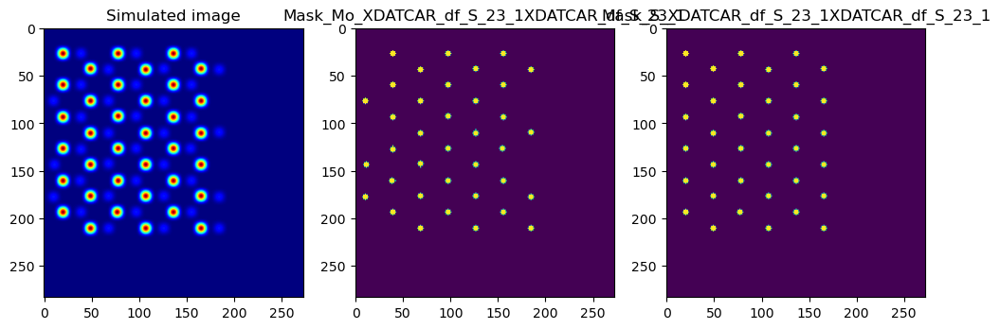

In [4]:
#plot image from the lists of image-mask pairs
temp_id = 4
_, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(12, 6))
ax1.imshow(image_list[temp_id][1], cmap = 'jet')
ax2.imshow(mask_list[temp_id][1][:,:,0])
ax3.imshow(mask_list[temp_id][1][:,:,1])
ax1.set_title("Simulated image")
ax2.set_title("Mask_Mo_" + label_list[temp_id])
ax3.set_title("Mask_S_" + label_list[temp_id])

In [5]:
#crop out the empty spaces
cropped_image_list = []
cropped_mask_list = []

for i in range(0,len(image_list)):
  local_cropped_imglist = []
  local_cropped_masklist = []
  for j in range(0,len(image_list[i])):
    local_cropped_imglist.append(image_list[i][j][:208,0:208])
    local_cropped_masklist.append(mask_list[i][j][:208,0:208])

  cropped_image_list.append(local_cropped_imglist)
  cropped_mask_list.append(local_cropped_masklist)

print("Number of tasks : ",len(cropped_image_list))
np.shape(cropped_image_list[0])

Number of tasks :  25


(443, 208, 208)

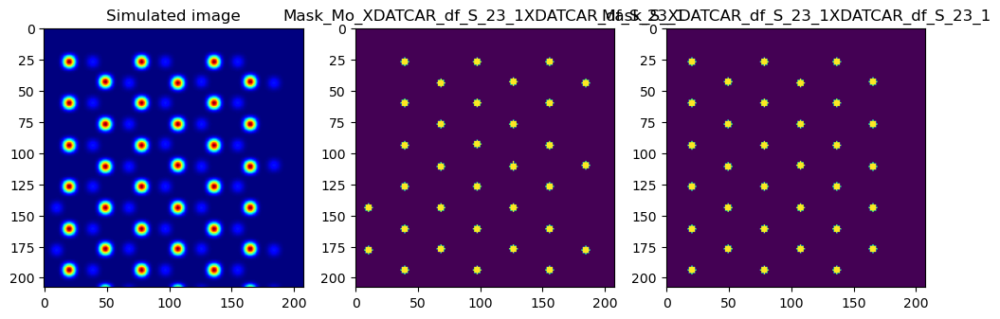

In [6]:
temp_id = 4
_, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(12, 6))
ax1.imshow(cropped_image_list[temp_id][0], cmap = 'jet')
ax2.imshow(cropped_mask_list[temp_id][0][:,:,0])
ax3.imshow(cropped_mask_list[temp_id][0][:,:,1])
ax1.set_title("Simulated image")
ax2.set_title("Mask_Mo_" + label_list[temp_id])
ax3.set_title("Mask_S_" + label_list[temp_id])

#_.suptitle(f"Initial Configuration of Task {ind_to_val[temp_id]}, Iteration 10")

plt.show()

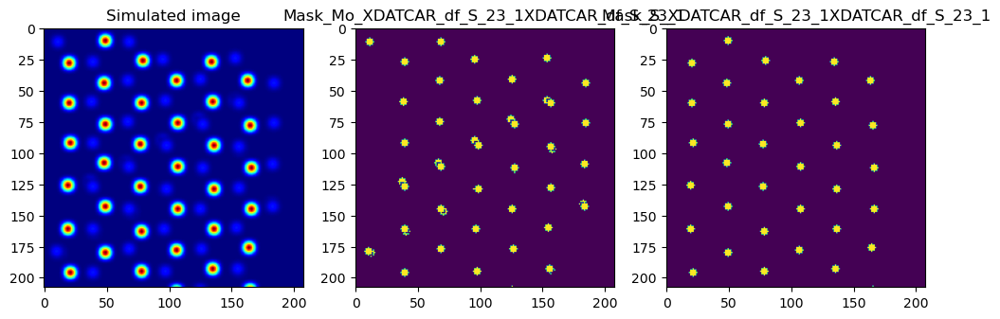

In [7]:
temp_id = 4
_, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(12, 6))
ax1.imshow(cropped_image_list[temp_id][30], cmap = 'jet')
ax2.imshow(cropped_mask_list[temp_id][30][:,:,0])
ax3.imshow(cropped_mask_list[temp_id][30][:,:,1])
ax1.set_title("Simulated image")
ax2.set_title("Mask_Mo_" + label_list[temp_id])
ax3.set_title("Mask_S_" + label_list[temp_id])

#_.suptitle(f"Initial Configuration of Task {ind_to_val[temp_id]}, Iteration 10")

plt.show()

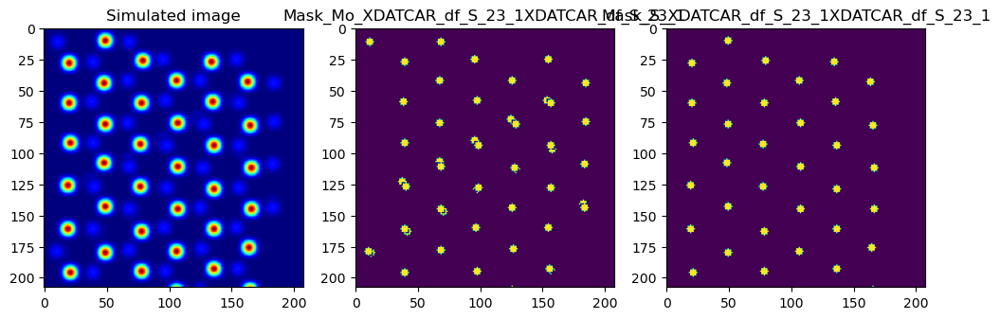

In [8]:
temp_id = 4
_, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(12, 6))
ax1.imshow(cropped_image_list[temp_id][31], cmap = 'jet')
ax2.imshow(cropped_mask_list[temp_id][31][:,:,0])
ax3.imshow(cropped_mask_list[temp_id][31][:,:,1])
ax1.set_title("Simulated image")
ax2.set_title("Mask_Mo_" + label_list[temp_id])
ax3.set_title("Mask_S_" + label_list[temp_id])

#_.suptitle(f"Initial Configuration of Task {ind_to_val[temp_id]}, Iteration 10")

plt.show()

In [9]:
dt = aoi.transforms.datatransform(1, # number of classes
                                  #gauss_noise=[1000, 2000], # scaled values
                                  #poisson_noise=[30, 45],
                                  blur=False,
                                  contrast=False,
                                  zoom=False,
                                  #resize=[2, 1], # downsize all the images by a factor of 2
                                  seed=1)
def augmented_simulations(cropped_image_list,cropped_mask_list):
    X_train, y_train = dt.run(np.array(cropped_image_list), np.array(cropped_mask_list)[..., None])
    return X_train, y_train

In [10]:
image_mask = {val:(None,None) for val in range(25)}

for val in range(25):
    image_mask[val] = augmented_simulations(cropped_image_list[val],cropped_mask_list[val])

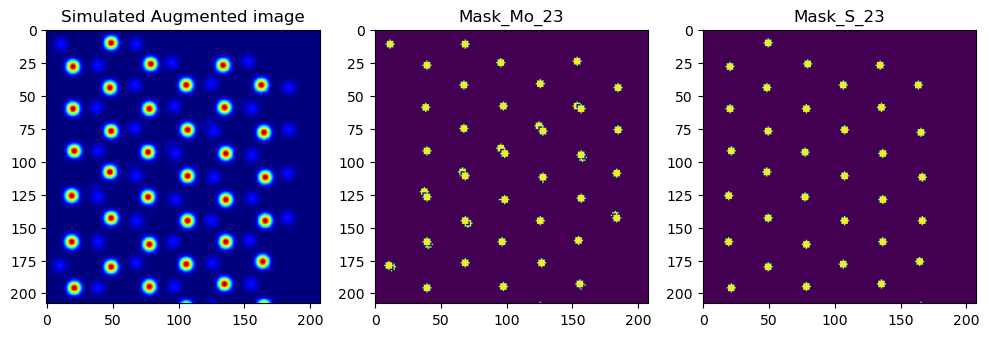

In [11]:

temp_id = 4
_, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(12, 6))
ax1.imshow(image_mask[temp_id][0][30].reshape(208,208), cmap = 'jet')
ax2.imshow(image_mask[temp_id][1][30][:,:,0])
ax3.imshow(image_mask[temp_id][1][30][:,:,1])
ax1.set_title("Simulated Augmented image")
ax2.set_title("Mask_Mo_" + ind_to_val[temp_id])
ax3.set_title("Mask_S_" + ind_to_val[temp_id])

#_.suptitle(f"Initial Configuration of Task {ind_to_val[temp_id]}, Iteration 10")

plt.show()

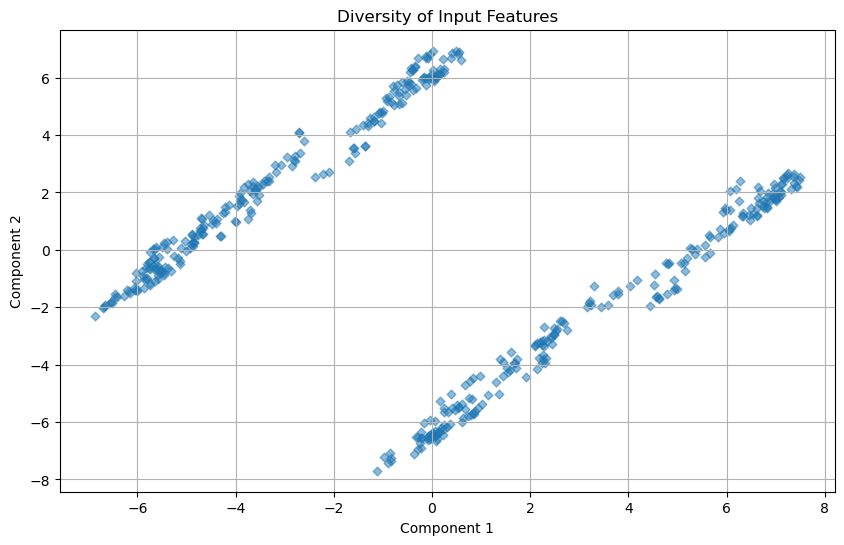

In [12]:
import os
import cv2
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

import os
import cv2
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

def plot_pca(images, n_components=2):
    # Perform PCA
    flat_images = images.reshape(images.shape[0], -1)
    pca = PCA(n_components=n_components)
    pca_results = pca.fit_transform(flat_images)
    
    # Plot the PCA results
    plt.figure(figsize=(10, 6))
    plt.scatter(pca_results[:, 0], pca_results[:, 1], s=20, alpha=0.5, marker="D")
    plt.title('Diversity of Input Features')
    plt.xlabel('Component 1')
    plt.ylabel('Component 2')
    plt.grid(True)
    plt.show()



def plot_tsne(images, n_samples=1000, perplexity=30, learning_rate=200):
    # Flatten the images
    flat_images = images.reshape(images.shape[0], -1)
    
    # Perform t-SNE
    tsne = TSNE(n_components=2, perplexity=perplexity, learning_rate=learning_rate)
    tsne_results = tsne.fit_transform(flat_images[:n_samples])
    
    # Plot the t-SNE results
    plt.figure(figsize=(10, 6))
    plt.scatter(tsne_results[:, 0], tsne_results[:, 1], s=2, alpha=0.5)
    plt.title('t-SNE of Image Dataset')
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.grid(True)
    plt.show()

# Example usage
# images = np.concatenate([image_mask[0][1][:,:,0],image_mask[0][1][:,:,1]],axis=1).reshape
images = image_mask[0][0]
# print(images.shape)

# Plot the t-SNE visualization
#plot_tsne(images)

# Plot the PCA visualization
plot_pca(images)



In [13]:
val = 0
energy_to_ind = {val:None for val in range(25)}
new_energy_ind = {val:None for val in range(25)}
directory =  f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/to_share_HP_defects/"
for filename in os.listdir(directory):
  if "." in filename:
    continue
  task = ind_to_val[val]
  file_name = directory + filename + "/"
  print(val)
  # filepath = f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/df_{task}/"
  xdatcar_filepath = f"XDATCAR_df_S_{filename.split('_')[1]}"
  oszicar_filepath = f"OSZICAR_df_S_{filename.split('_')[1]}"
  energy_to_ind[val] = oszicar_generation(file_name,xdatcar_filepath,oszicar_filepath,filename.split("_")[1])
  last_iter = energy_to_ind[val]["Iteration"].values[-1]
  last_idx = len(energy_to_ind[val]["Iteration"])

  xdatcar_filepath = f"XDATCAR_df_S_{filename.split('_')[1]}_1"
  oszicar_filepath = f"OSZICAR_df_S_{filename.split('_')[1]}_1"
  new_energy_ind[val] = oszicar_generation(file_name,xdatcar_filepath,oszicar_filepath,filename.split("_")[1])
  new_energy_ind[val]["Iteration"] = new_energy_ind[val]["Iteration"]+last_iter #oszicar_generation(file_name,xdatcar_filepath,oszicar_filepath,filename.split("_")[1])
  energy_to_ind[val] = pd.concat([energy_to_ind[val],new_energy_ind[val]])
  #energy_to_ind[val] = pd.concat([energy_to_ind[val],oszicar_generation_additional(file_name,xdatcar_filepath,oszicar_filepath,filename.split("_")[1],last_iter)])
  energy_to_ind[val]["target_total_energy_per_atom"] = energy_to_ind[val]["target_total_energy_per_atom"] - energy_to_ind[val]["target_total_energy_per_atom"].mean()
  #energy_to_ind[val]["Iteration"][last_idx:] = energy_to_ind[val]["Iteration"][last_idx:] + last_iter
  val += 1

0
Total number of atoms: 103
Last trajectory Number: 2280.0
Total number of atoms: 103
Last trajectory Number: 2150.0
1
Total number of atoms: 83
Last trajectory Number: 2420.0
Total number of atoms: 83
Last trajectory Number: 2460.0
2
Total number of atoms: 88
Last trajectory Number: 2480.0
Total number of atoms: 88
Last trajectory Number: 2590.0
3
Total number of atoms: 94
Last trajectory Number: 2380.0
Total number of atoms: 94
Last trajectory Number: 2340.0
4
Total number of atoms: 85
Last trajectory Number: 2400.0
Total number of atoms: 85
Last trajectory Number: 2580.0
5
Total number of atoms: 89
Last trajectory Number: 2460.0
Total number of atoms: 89
Last trajectory Number: 2440.0
6
Total number of atoms: 102
Last trajectory Number: 2150.0
Total number of atoms: 102
Last trajectory Number: 2030.0
7
Total number of atoms: 93
Last trajectory Number: 2210.0
Total number of atoms: 93
Last trajectory Number: 2430.0
8
Total number of atoms: 86
Last trajectory Number: 2520.0
Total num

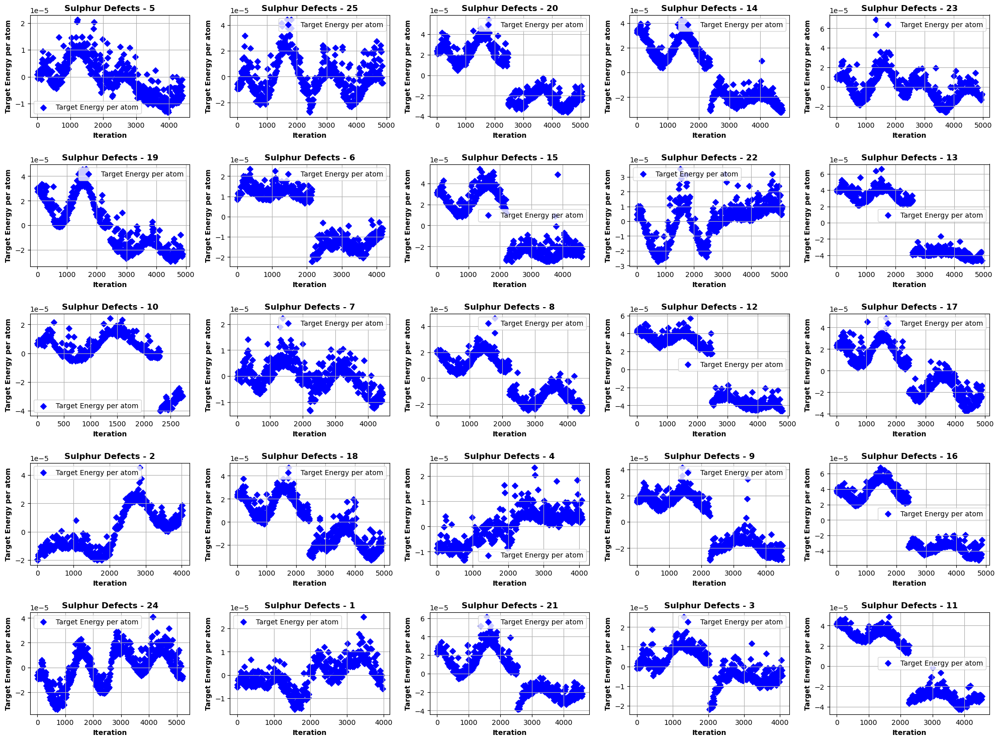

In [14]:
# Create a 5x5 grid of subplots
fig, axs = plt.subplots(5, 5, figsize=(20, 15), dpi=100)

# Flatten the 2D array of axes to easily iterate over them
axs = axs.flatten()

# Loop through each task and its corresponding subplot
for i in range(25):
    ax = axs[i]
    ax.scatter(energy_to_ind[i]['Iteration'], energy_to_ind[i]['target_total_energy_per_atom'], label='Target Energy per atom', color='blue', marker='D')
    
    # Adding labels and title with font settings
    ax.set_xlabel('Iteration', fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.set_ylabel('Target Energy per atom', fontdict={'fontsize': 10, 'fontweight': 'bold'})
    ax.set_title(f'Sulphur Defects - {ind_to_val[i]}', fontdict={'fontsize': 12, 'fontweight': 'bold'})
    ax.legend()
    ax.grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()

Training the Masks - Experiment

In [18]:
def decimal_formatter_mod(x, pos):
    """ Format ticks to 2 decimal places. """
    return f'{x/1e-3:.4f}'

# @title Modified plotting functions
def mod_reconstruction_graph_plot(
    iterations_train, train_mean, y_train,
    iterations_test, mean, y_test,
    ind_to_val, title, task,
    scaler_flag, feature_extractor,
    training_cycles, lr, augmentation
):
    plt.figure(figsize=(20, 10))

    # Scatter plots
    plt.scatter(
        np.array(iterations_train), train_mean,
        c='darkred', marker='D', s=100, label="Train Prediction", edgecolor='k'
    )
    plt.scatter(
        np.array(iterations_train), y_train.reshape(-1, 1),
        c='darkblue', marker='^', s=100, label="Train Ground Truth", edgecolor='k'
    )
    plt.scatter(
        np.array(iterations_test), mean.reshape(1, -1),
        c='orange', marker='D', s=100, label="Prediction"
    )
    plt.scatter(
        np.array(iterations_test), y_test.reshape(1, -1),
        c='royalblue', marker='^', s=100, label="Ground Truth"
    )

    # Titles and labels with enhanced styles
    #plt.title(f"{title} from Task {task}", fontsize=22, fontweight='bold', color='darkgreen')
    plt.xlabel("Iterations (fs)", fontsize=16, fontweight='bold')
    plt.ylabel("Target energy difference per atom (meV)", fontsize=16, fontweight='bold')

    # Customize ticks
    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')

    # Add grid lines
    plt.grid(True, linestyle='--', alpha=0.7)

    # Customize legend
    plt.legend(fontsize=14, loc='best', frameon=True, shadow=True, fancybox=True)

    # Add background color
    #plt.gca().set_facecolor('lightgray')
    plt.gca().set_facecolor('white')
    #plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))
    plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))

    # Save figure (uncomment if needed)
    #plt.savefig(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/single_tasks/reconstruction_graphs/Task{ind_to_val[task]}_Norm{scaler_flag}_{feature_extractor}_aug{augmentation}_training{training_cycles}_lr{lr}_reconstruction.png")

    plt.show()
    plt.clf()

def color_gradient_difference_plot_modified(energy_ground_truth, predictions, training_pred, training_ground_truth, task, feature_extractor, scaler, augmentation):
    # Calculate the difference
    pred_data = np.concatenate((training_pred, predictions), axis=0).reshape(-1, 1)
    ground_truth_data = np.concatenate((training_ground_truth, energy_ground_truth), axis=0)

    difference = pred_data - ground_truth_data
    difference_training = training_pred - training_ground_truth
    difference_predictions = predictions - energy_ground_truth

    # Create subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 14))

    # Scatter plot for training data
    scatter_train = ax1.scatter(training_ground_truth, training_pred, c=difference[:len(training_pred)]/1e-3, s=60, cmap='viridis', edgecolor='k', alpha=0.75, marker='D')
    cbar_train = plt.colorbar(scatter_train, ax=ax1)
    cbar_train.set_label('Training Error (meV)', fontsize=14, fontweight='bold')
    cbar_train.ax.tick_params(labelsize=14, width=2)

    ax1.set_xlabel("Computed energy difference per atom (meV)", fontsize=14, fontweight='bold')
    ax1.set_ylabel("Predicted energy difference per atom (meV)", fontsize=14, fontweight='bold')
    ax1.set_title("Training Prediction Error", fontsize=18, fontweight='bold')
    ax1.xaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))
    ax1.yaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))
    ax1.grid(True, linestyle='--', alpha=0.7)
    ax1.tick_params(axis='both', which='major', labelsize=14, width=2)

    # Scatter plot for prediction data
    scatter_pred = ax2.scatter(energy_ground_truth, predictions, c=difference[len(training_pred):]/1e-3, s=60, cmap='coolwarm', edgecolor='k', alpha=0.75, marker='^')
    cbar_pred = plt.colorbar(scatter_pred, ax=ax2)
    cbar_pred.set_label('Testing Error (meV)', fontsize=14, fontweight='bold')
    cbar_pred.ax.tick_params(labelsize=14, width=2)

    ax2.set_xlabel("Computed energy difference per atom (meV)", fontsize=14, fontweight='bold')
    ax2.set_ylabel("Predicted energy difference per atom (meV)", fontsize=14, fontweight='bold')
    ax2.set_title("Testing Prediction Error", fontsize=18, fontweight='bold')
    ax2.xaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))
    ax2.yaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))
    ax2.grid(True, linestyle='--', alpha=0.7)
    ax2.tick_params(axis='both', which='major', labelsize=14, width=2)

    plt.suptitle(f"Energy Difference Gradient for Task {task}", fontsize=20, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
    #plt.savefig(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/single_tasks/gradient_plot/Gradient_plot_Task{task}_{feature_extractor}_{pois}_aug{augmentation}.png")
    plt.clf()

def single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,**kwargs):
    datadim = kwargs.get("datadim", 832)
    embedim = 2
    training_cycles = kwargs.get("training_cycles", 150)
    lr = kwargs.get("lr", 1e-2)
    scaler_flag = kwargs.get("scaler",False)
    results = {int(ind_to_val[task]):[] for task in train_tasks}
    feature_extractor = kwargs.get("reptile","default_FE")
    augmentation = kwargs.get("augmentation",True)
    print(feature_extractor)
    model_sample = torch.nn.Sequential(
                                #torch.nn.Linear(datadim,1024),
                                #torch.nn.ReLU(),
                                # torch.nn.Linear(10240,2048),
                                # torch.nn.ReLU(),
                                # torch.nn.Linear(2048,1024),
                                # torch.nn.ReLU(),
                                torch.nn.Linear(datadim, 256),
                                torch.nn.ReLU(),
                                *(list(fcFeatureExtractor(256,embedim).children())),)

    model_mod = kwargs.get("model_mod",model_sample)
    

    for task in train_tasks:
        input_image = np.concatenate([image_mask[task][1][:,:,0],image_mask[task][1][:,:,1]],axis=1)
        print(f"Training Task {ind_to_val[task]}")
        (X_train, X_test, y_train, y_test, iterations_train, iterations_test) = train_test_split(
            input_image, energy_to_ind[task]["target_total_energy_per_atom"], energy_to_ind[task]['Iteration'], test_size=0.15, shuffle=False, random_state=2)
        # X_train, y_train = image_mask[0][0], energy_to_ind[0]["target_energy"]
        
        print(X_train.shape)
        
        X_train = np.squeeze(X_train)
        X_test = np.squeeze(X_test)

        s1,s2,s3 = X_train.shape
        X_train = X_train.reshape(-1,s2*s3)
        X_test = X_test.reshape(-1,s2*s3)


        y_train = np.array(y_train).reshape(1,-1)
        y_test = np.array(y_test).reshape(1,-1) 

        if scaler_flag:
            X_train = scaler_fun.fit_transform(X_train)
            X_test = scaler_fun.fit_transform(X_test)
        
        X , y = torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32)
        y = y.reshape(1,-1)    

        print(X.shape,y.shape)
        dklgp = dklgpreg.dklGPR(datadim,embedim,hidden_dim=[1000,500,50],feature_extract=copy.deepcopy(model_mod),precision="single")#aoi.models.dklGPR(data_dim, embedim=2, precision="double")
        dklgp.fit(X, y, training_cycles=training_cycles, lr=lr)

        training_loss = list(dklgp.train_loss)
        
        with torch.no_grad():
            train_mean, train_var = dklgp.predict(X)
            mean, var = dklgp.predict(X_test)
        
        # torch.save(dklgp,f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/single_tasks/model/Task{ind_to_val[task]}_Norm{scaler_flag}_{feature_extractor}_training{training_cycles}_lr{lr}_model.pt")
        clear_gpu_cache()

        # Reconstruction Graph
        mod_reconstruction_graph_plot(iterations_train,train_mean,y_train,iterations_test,mean,y_test,ind_to_val,title,task,scaler_flag,feature_extractor,training_cycles,lr,augmentation)

        # Gradient Plotting
        # color_gradient_difference_plot(y_test.reshape(-1,1),mean.reshape(-1,1),ind_to_val[task],feature_extractor,scaler_flag,augmentation)
        #distribution_plotting(y_test.reshape(-1,1),mean.reshape(-1,1),ind_to_val[task],feature_extractor,scaler_flag)
        color_gradient_difference_plot_modified(y_test.reshape(-1,1), mean, train_mean, y_train.reshape(-1,1), task, feature_extractor, scaler_flag,augmentation)
        #Training Loss plotting
        # mod_plot_training_loss(training_loss,ind_to_val[task],scaler_flag,feature_extractor,training_cycles,lr,augmentation)

        results[int(ind_to_val[task])] = [iterations_train,iterations_test,train_mean,mean,y_train,y_test,feature_extractor,training_loss,scaler_flag,ind_to_val,title,training_cycles,lr]
    return results

default_FE
Training Task 1
(338, 416, 2, 1)
torch.Size([338, 832]) torch.Size([1, 338])
dtype : torch.float32


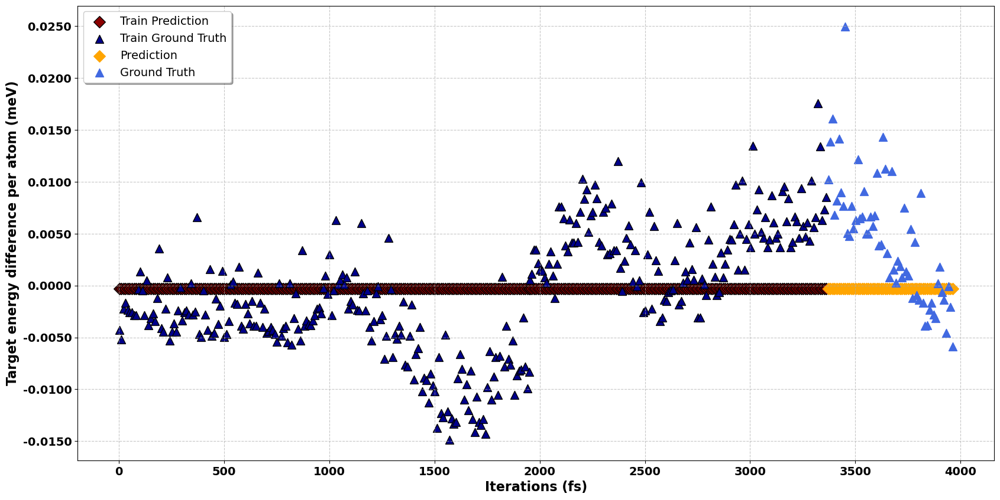

<Figure size 640x480 with 0 Axes>

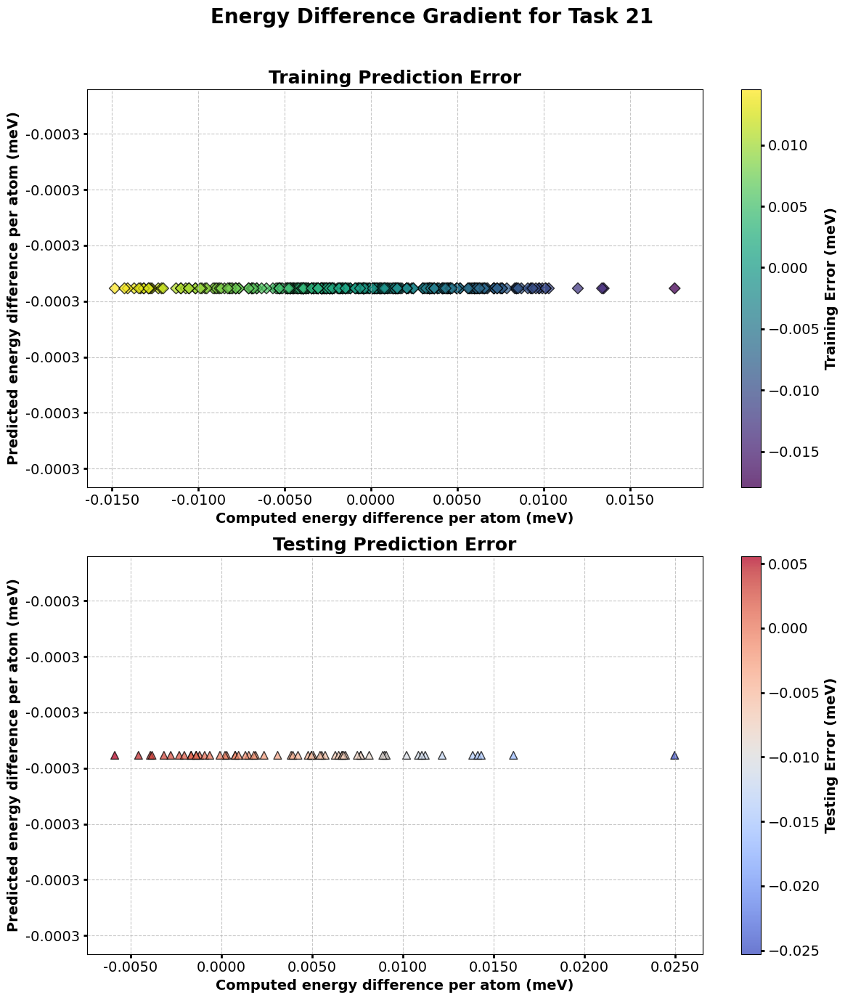

Training Task 2
(343, 416, 2, 1)
torch.Size([343, 832]) torch.Size([1, 343])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

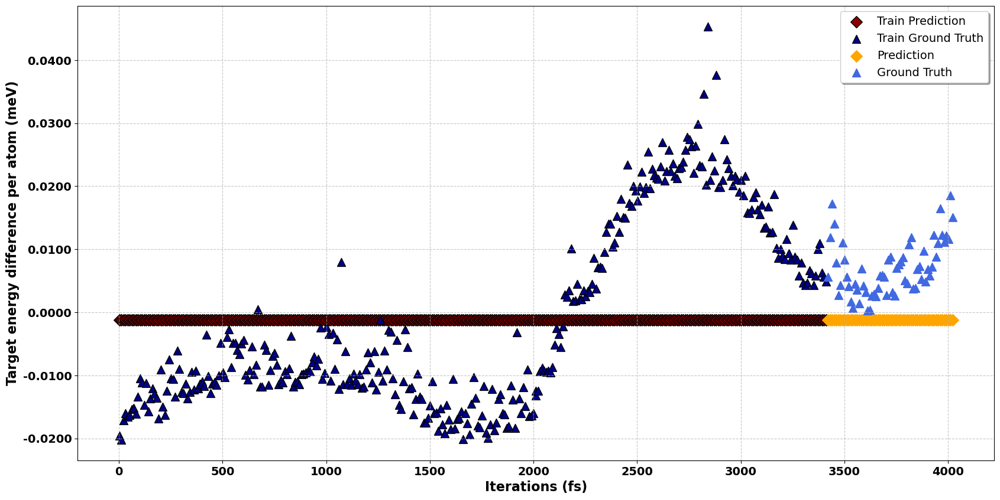

<Figure size 640x480 with 0 Axes>

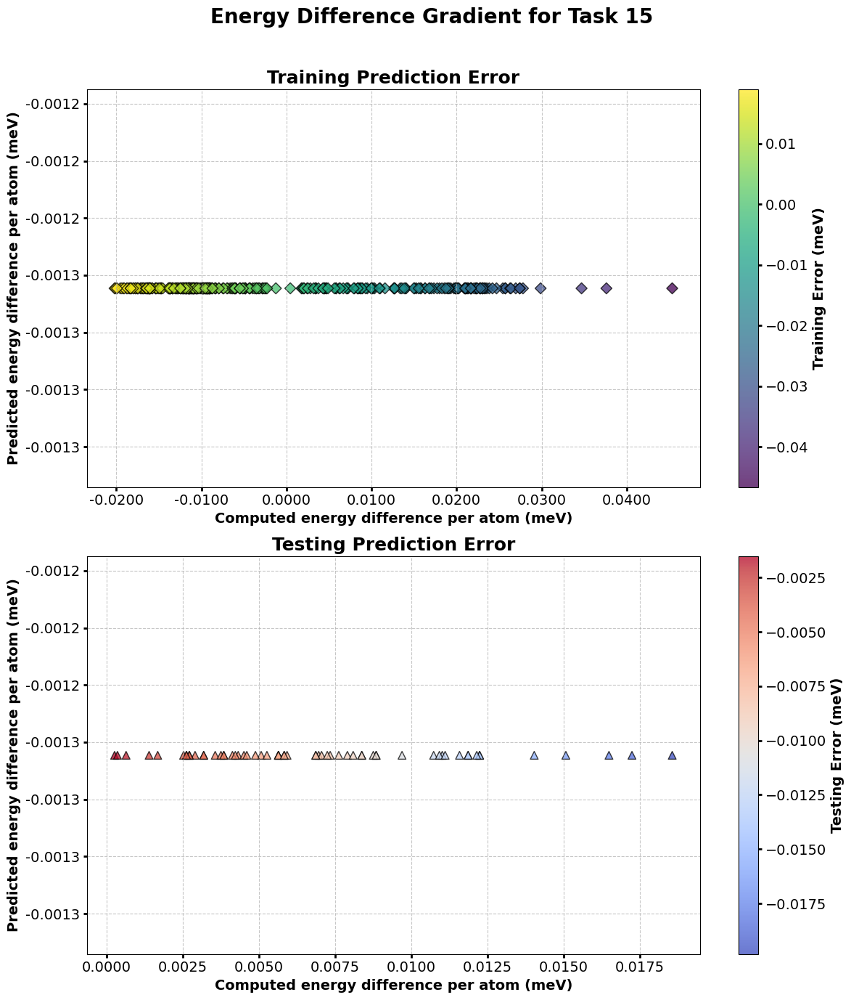

Training Task 3
(346, 416, 2, 1)
torch.Size([346, 832]) torch.Size([1, 346])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

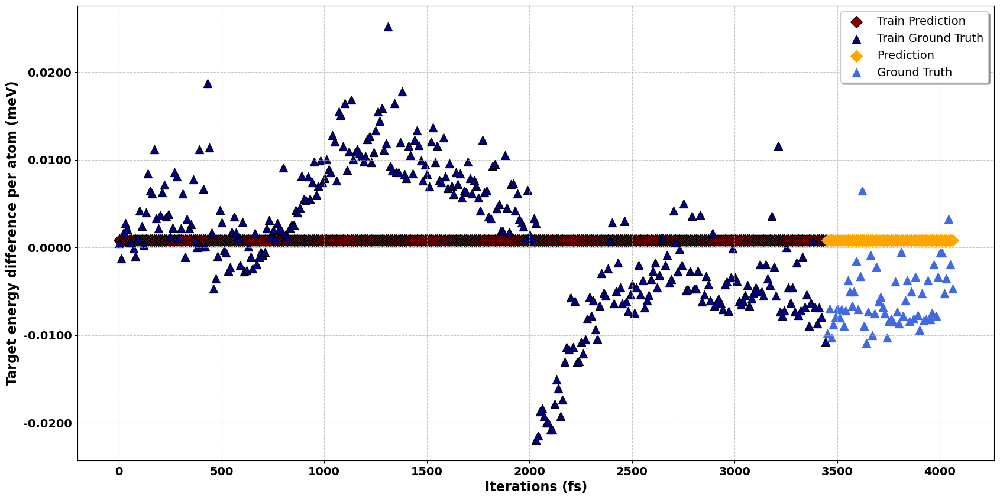

<Figure size 640x480 with 0 Axes>

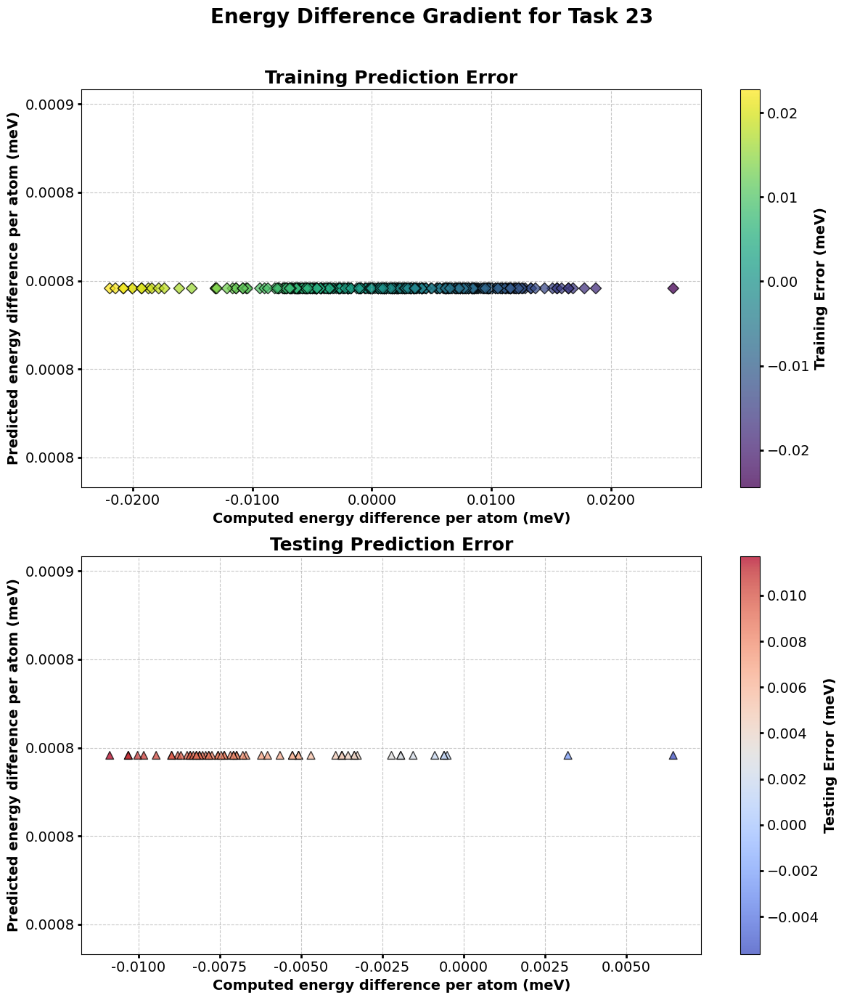

Training Task 4
(348, 416, 2, 1)
torch.Size([348, 832]) torch.Size([1, 348])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

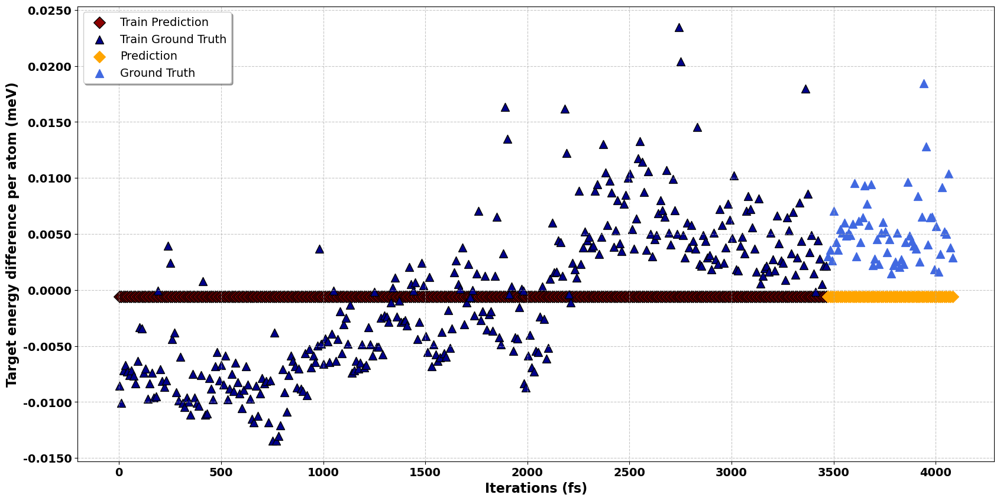

<Figure size 640x480 with 0 Axes>

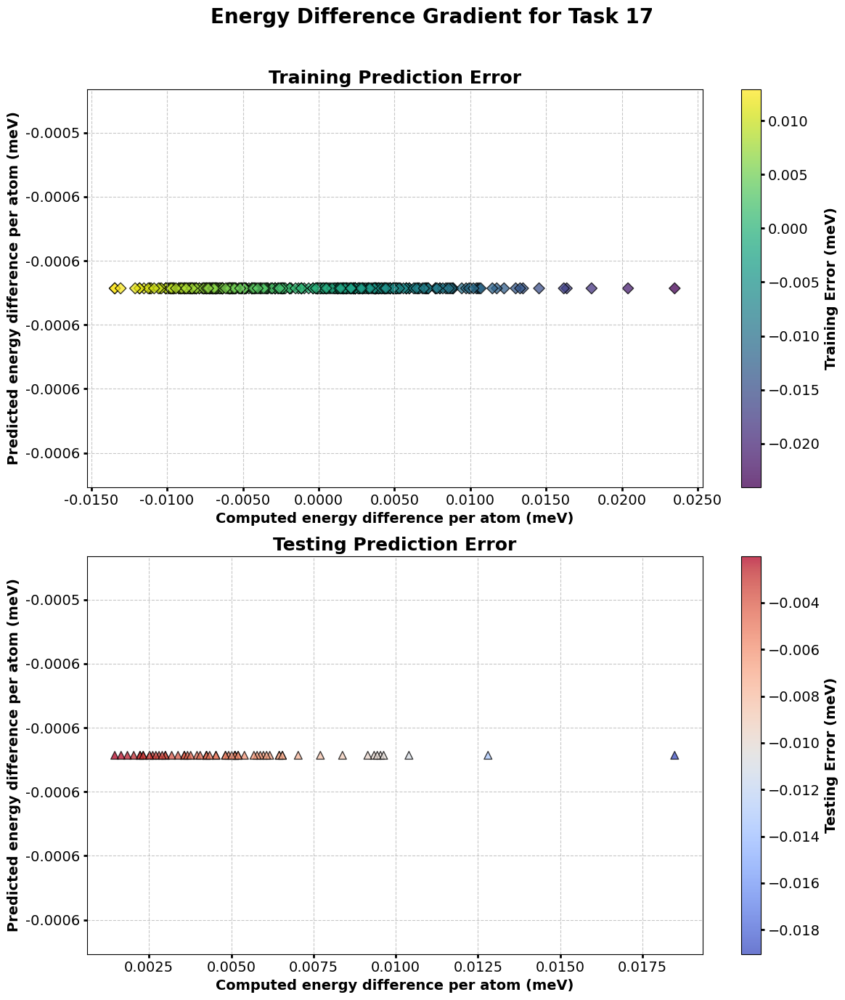

Training Task 5
(376, 416, 2, 1)
torch.Size([376, 832]) torch.Size([1, 376])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

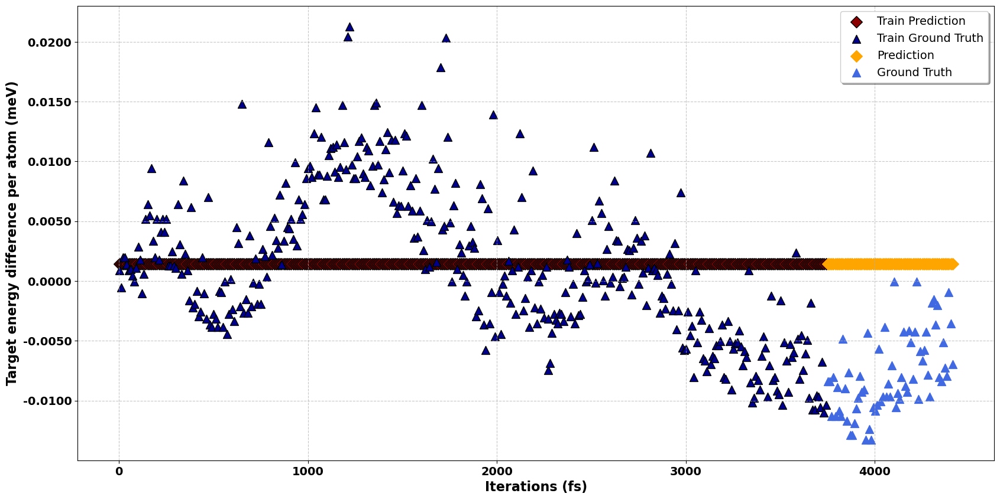

<Figure size 640x480 with 0 Axes>

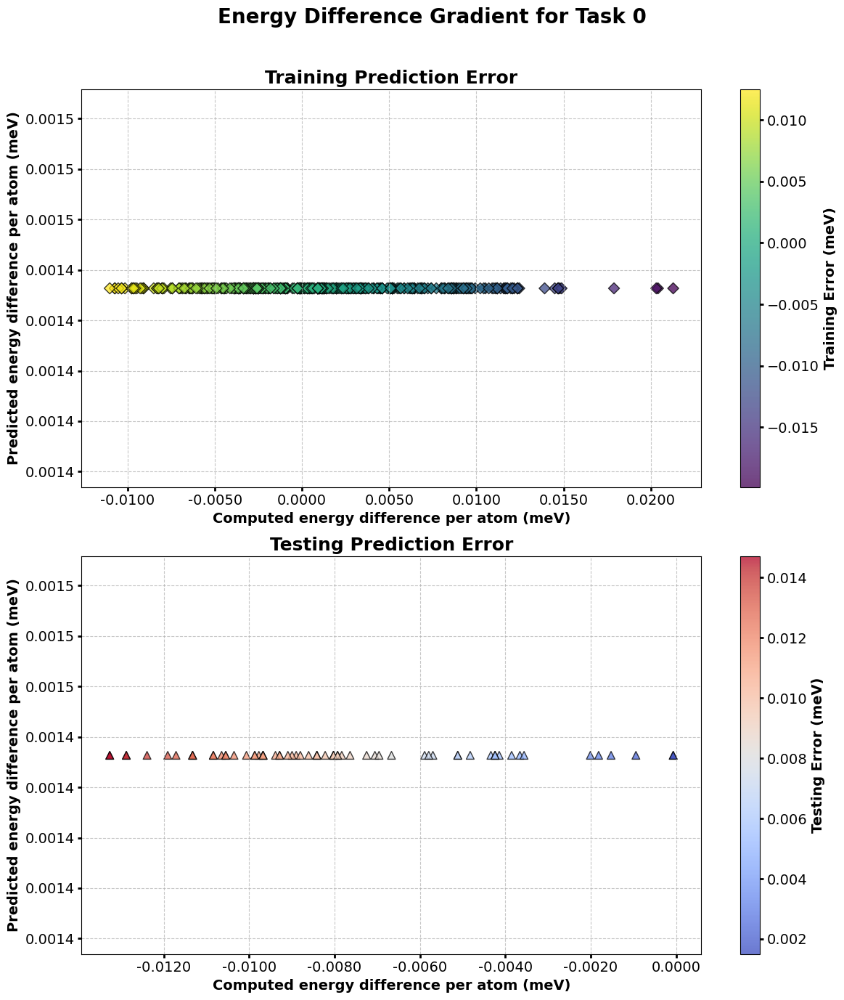

Training Task 6
(355, 416, 2, 1)
torch.Size([355, 832]) torch.Size([1, 355])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

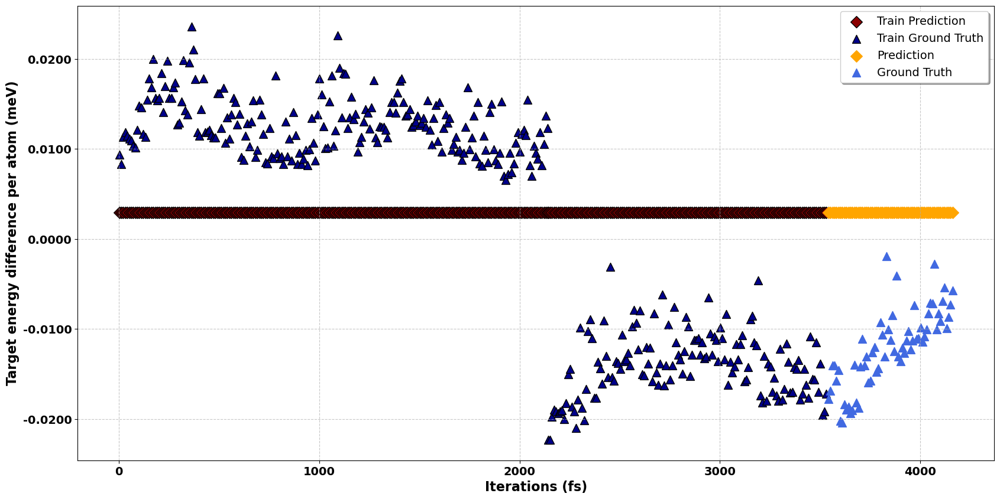

<Figure size 640x480 with 0 Axes>

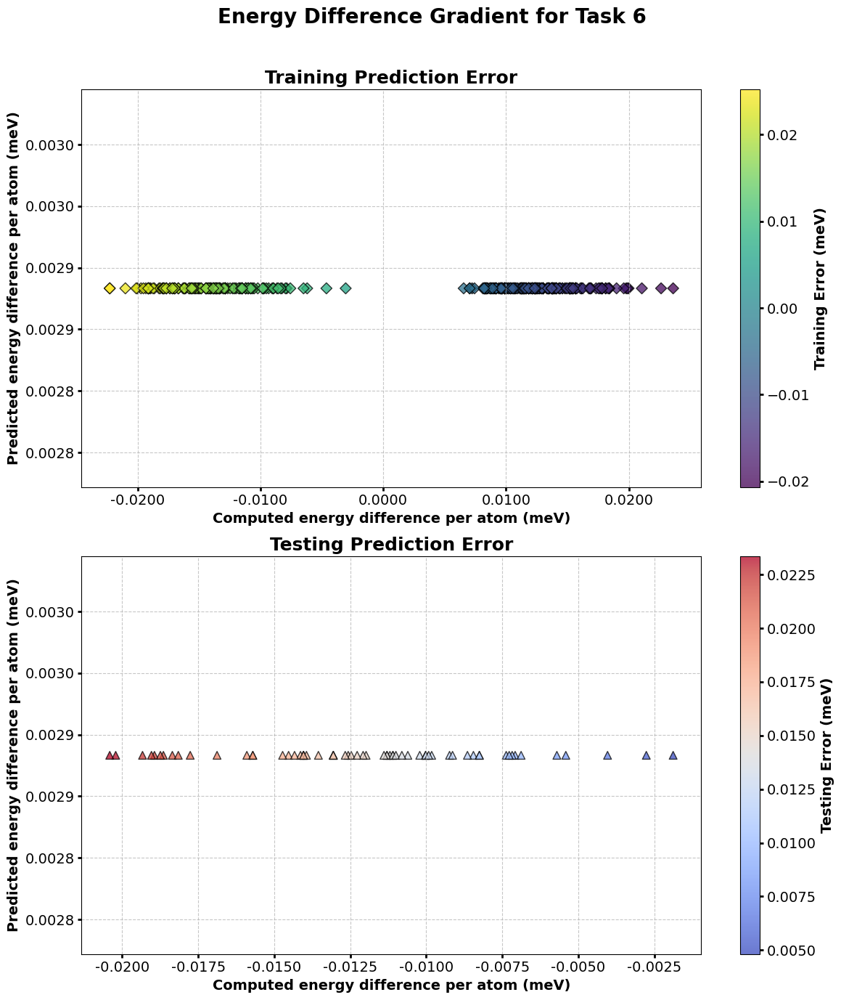

Training Task 7
(379, 416, 2, 1)
torch.Size([379, 832]) torch.Size([1, 379])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

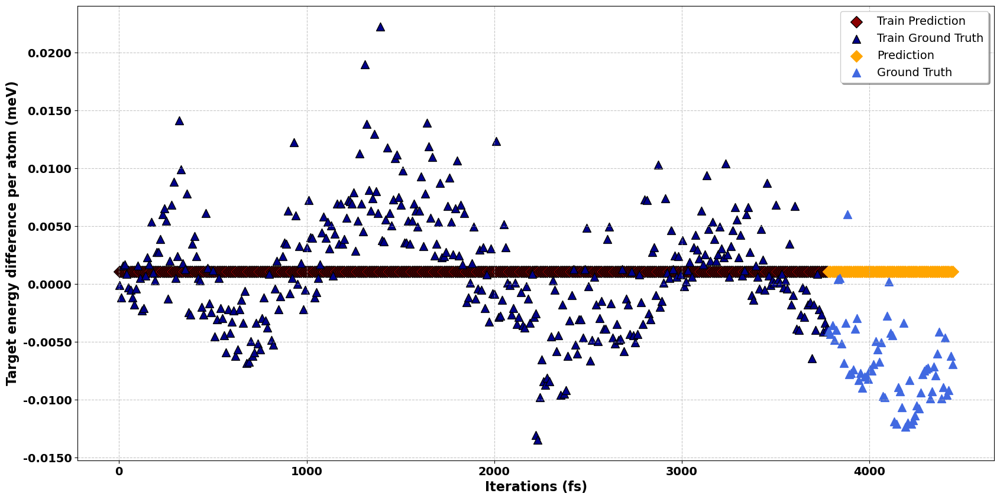

<Figure size 640x480 with 0 Axes>

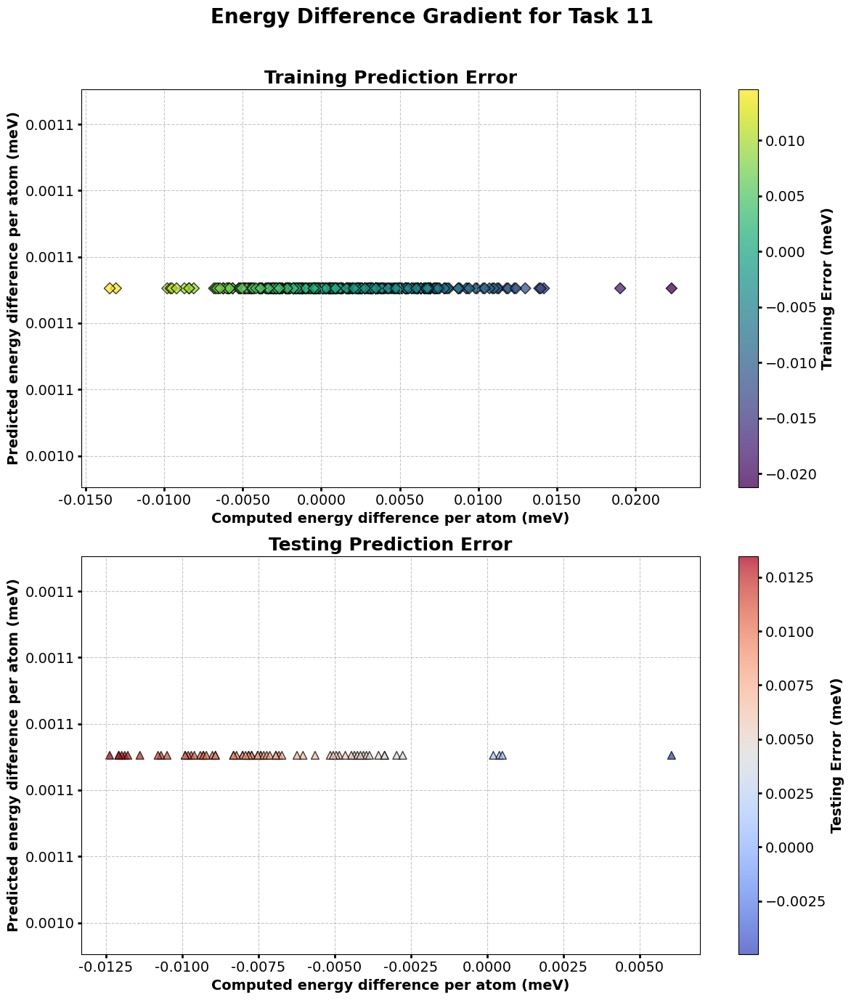

Training Task 8
(379, 416, 2, 1)
torch.Size([379, 832]) torch.Size([1, 379])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

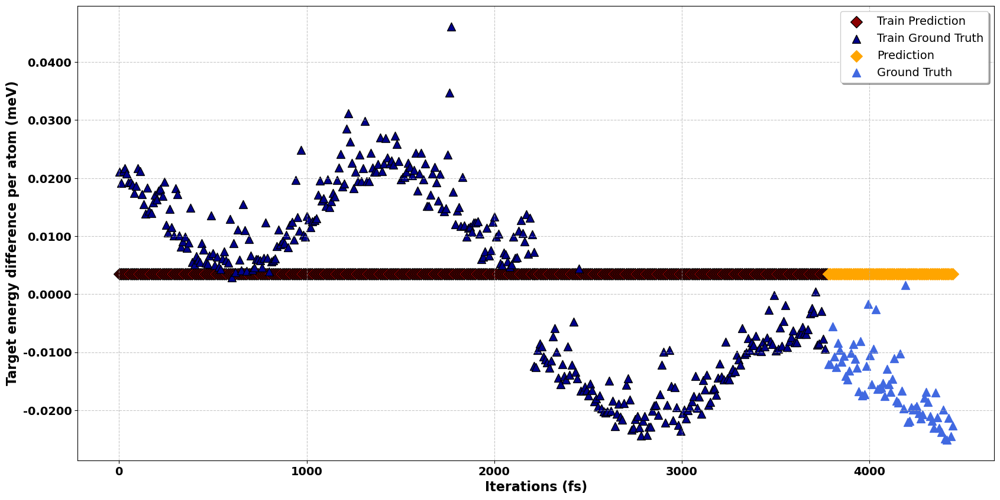

<Figure size 640x480 with 0 Axes>

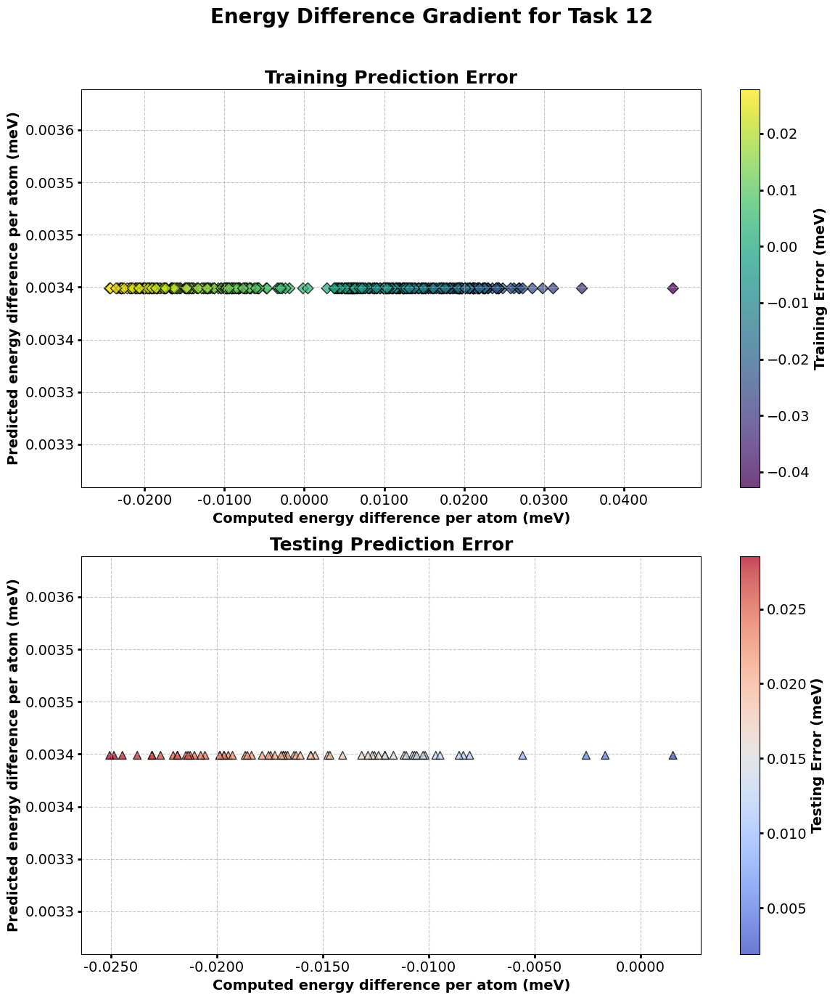

Training Task 9
(384, 416, 2, 1)
torch.Size([384, 832]) torch.Size([1, 384])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

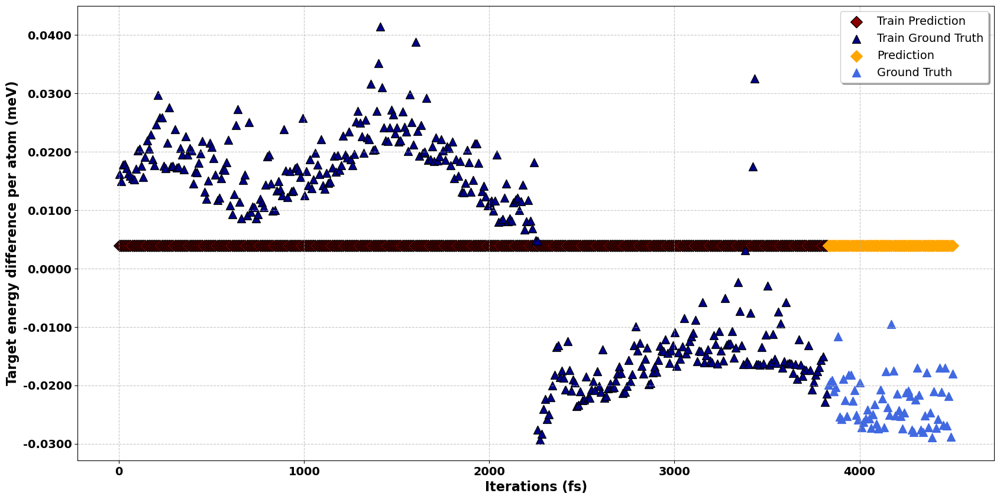

<Figure size 640x480 with 0 Axes>

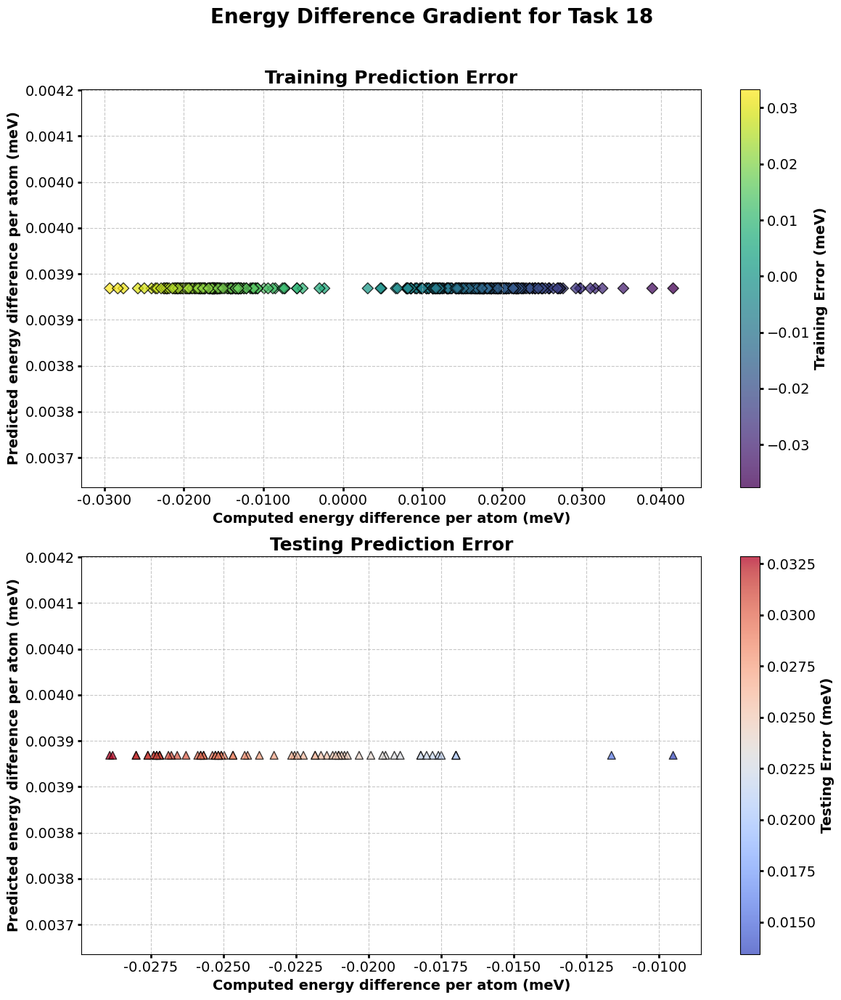

Training Task 10
(232, 416, 2, 1)
torch.Size([232, 832]) torch.Size([1, 232])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

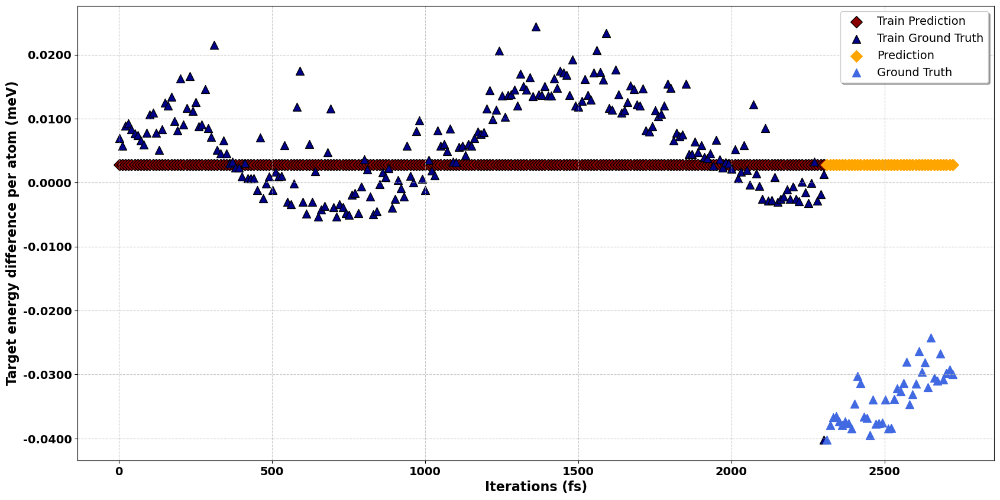

<Figure size 640x480 with 0 Axes>

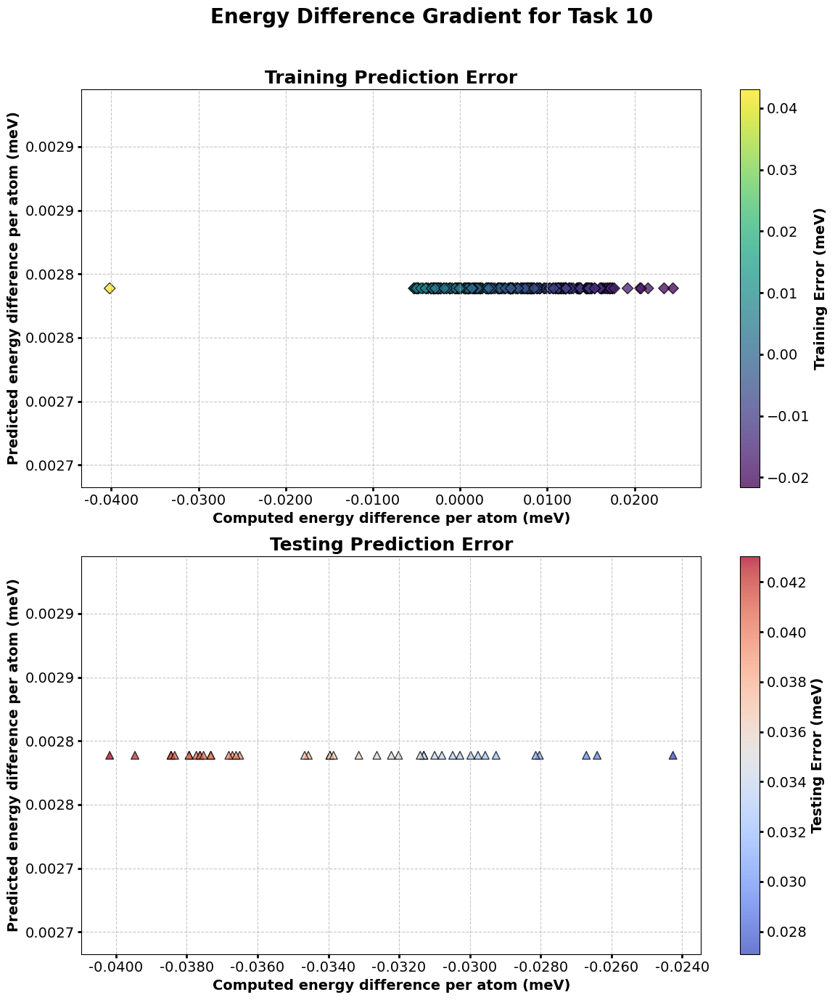

Training Task 11
(388, 416, 2, 1)
torch.Size([388, 832]) torch.Size([1, 388])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

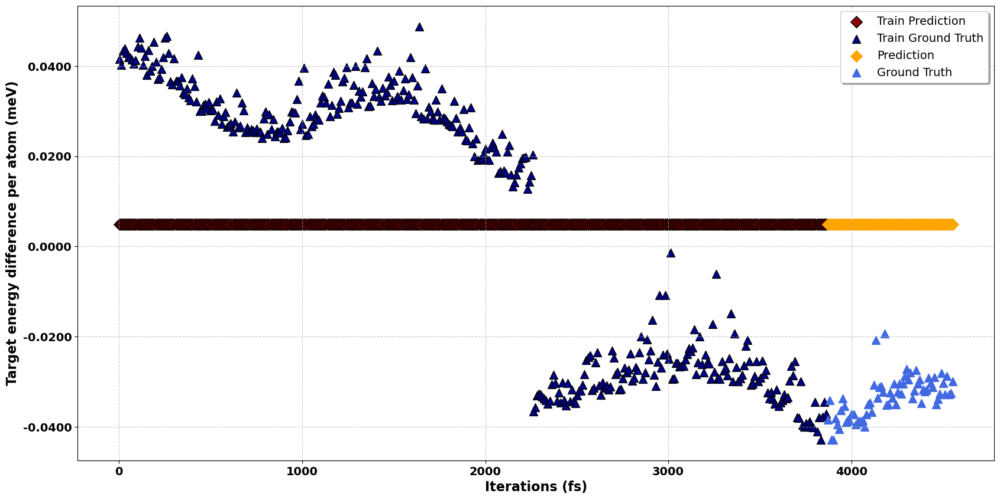

<Figure size 640x480 with 0 Axes>

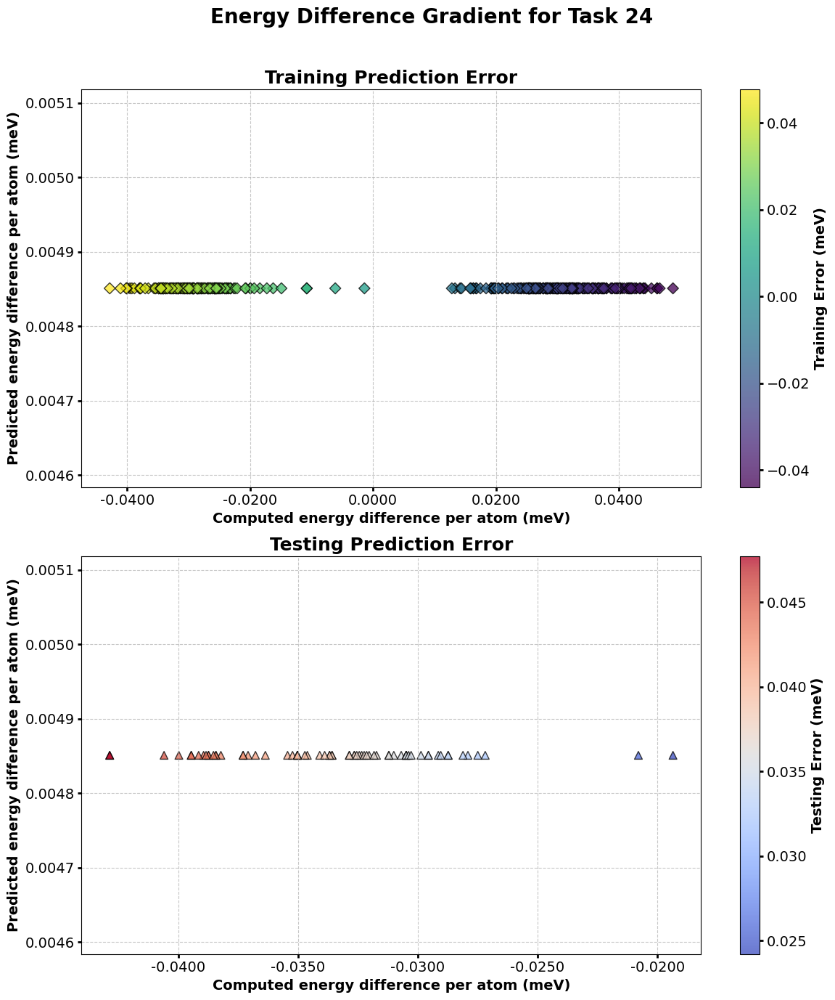

Training Task 12
(410, 416, 2, 1)
torch.Size([410, 832]) torch.Size([1, 410])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

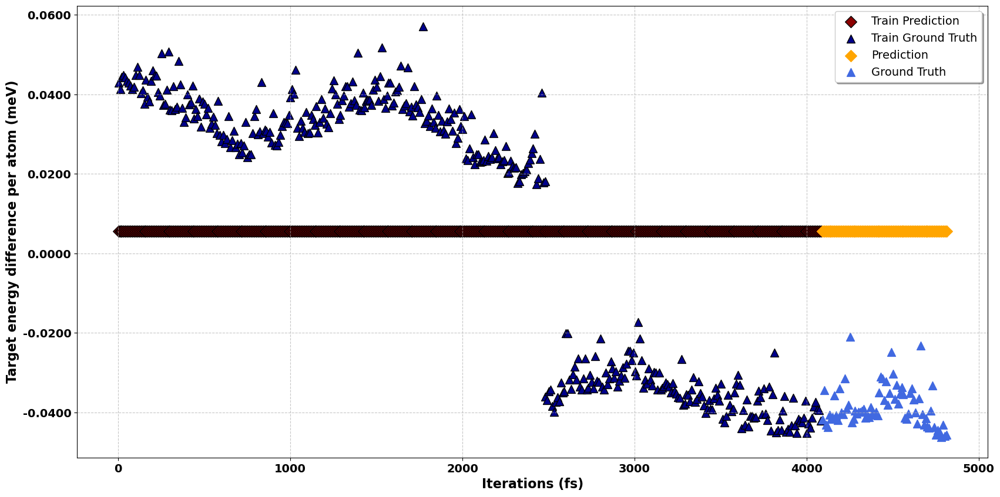

<Figure size 640x480 with 0 Axes>

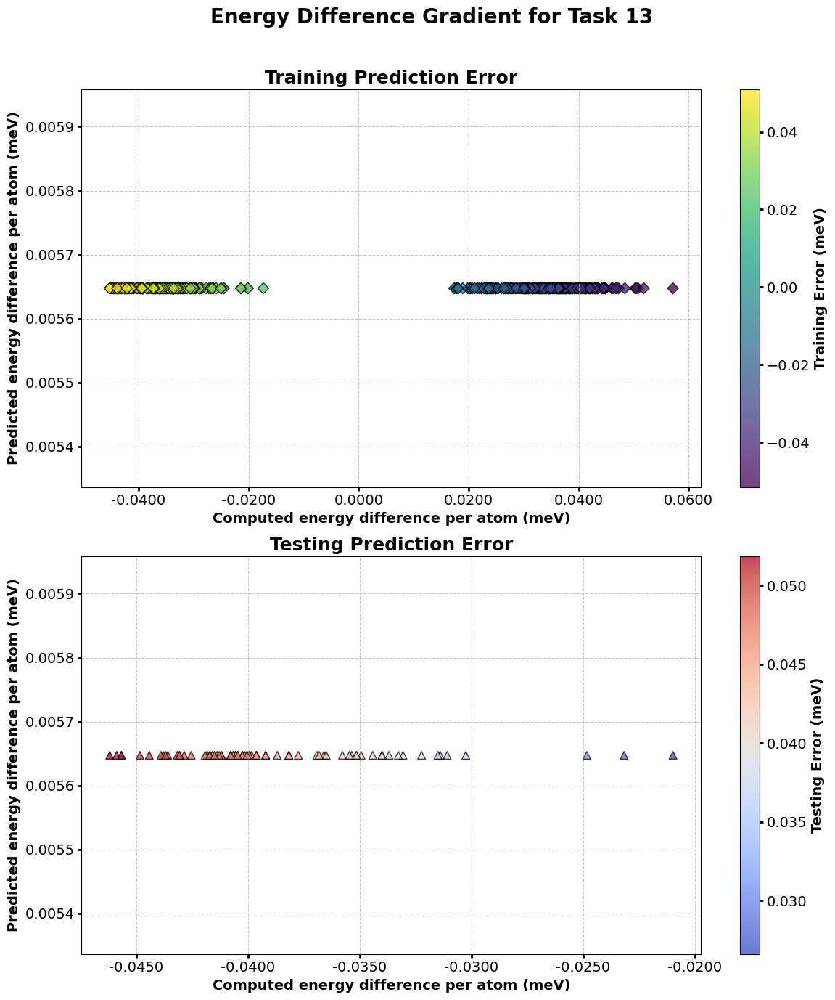

Training Task 13
(420, 416, 2, 1)
torch.Size([420, 832]) torch.Size([1, 420])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

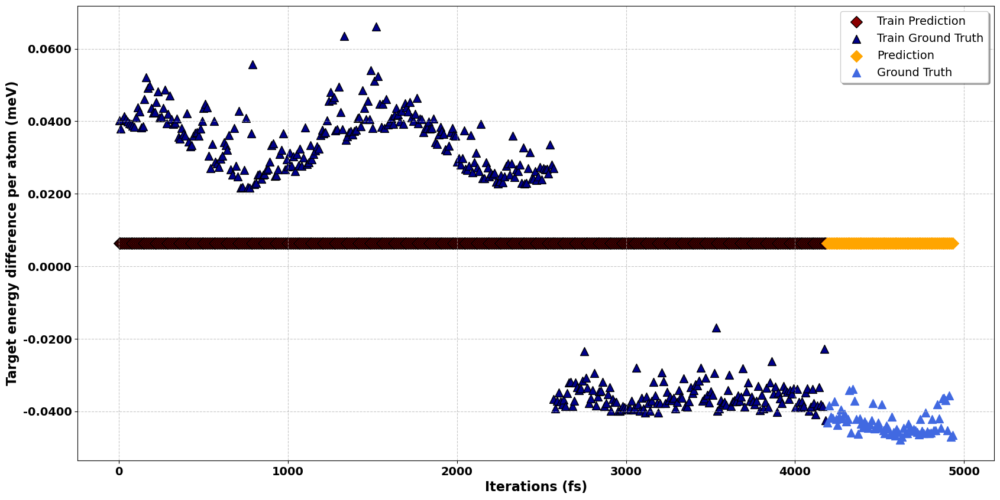

<Figure size 640x480 with 0 Axes>

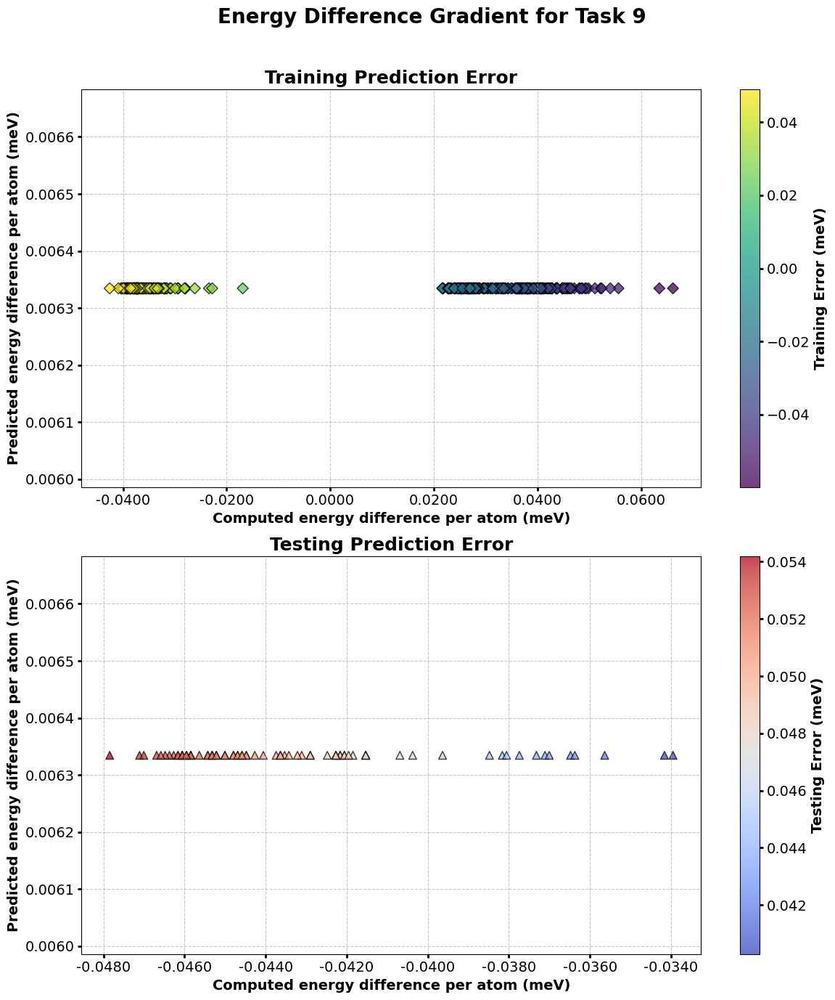

Training Task 14
(401, 416, 2, 1)
torch.Size([401, 832]) torch.Size([1, 401])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

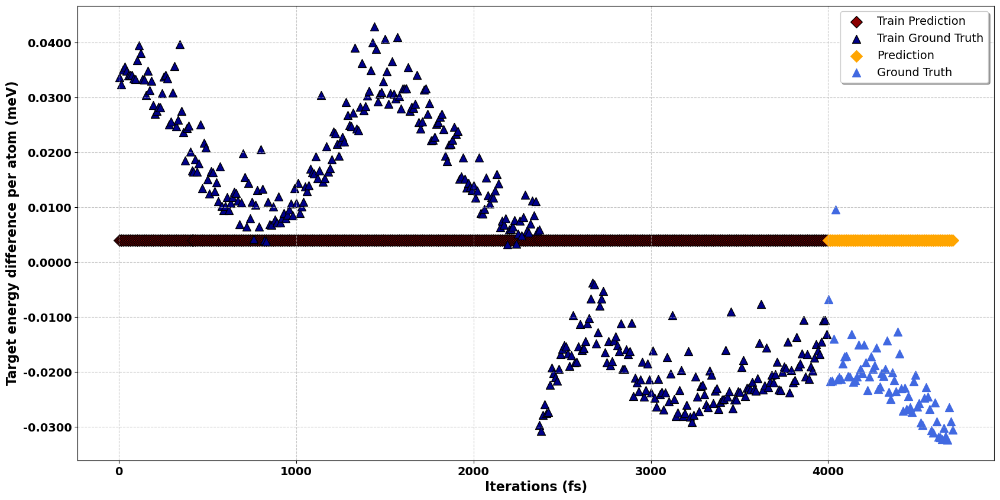

<Figure size 640x480 with 0 Axes>

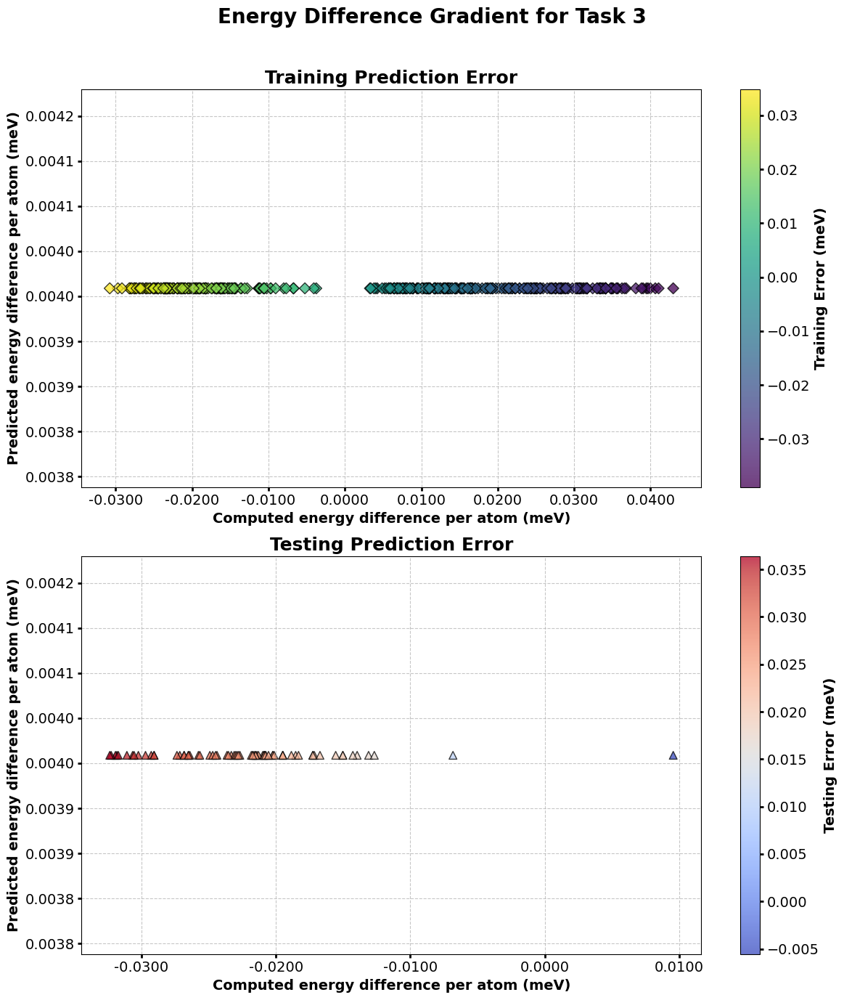

Training Task 15
(394, 416, 2, 1)
torch.Size([394, 832]) torch.Size([1, 394])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

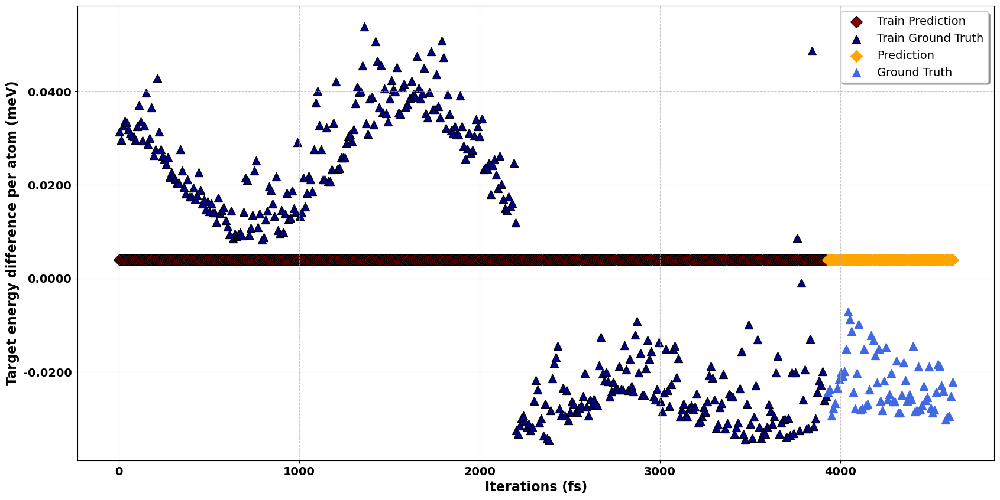

<Figure size 640x480 with 0 Axes>

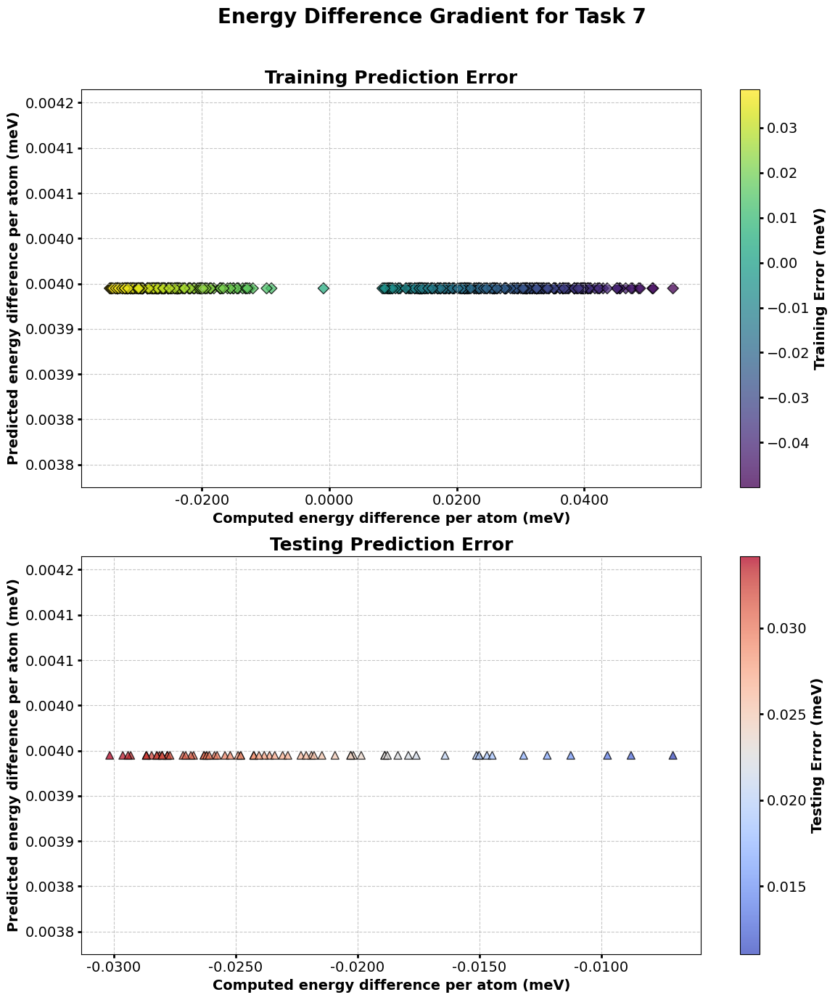

Training Task 16
(414, 416, 2, 1)
torch.Size([414, 832]) torch.Size([1, 414])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

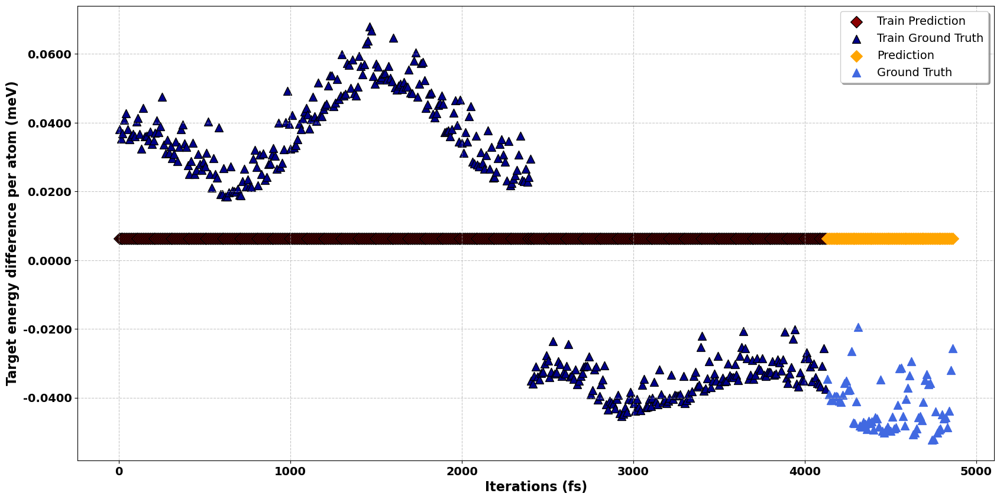

<Figure size 640x480 with 0 Axes>

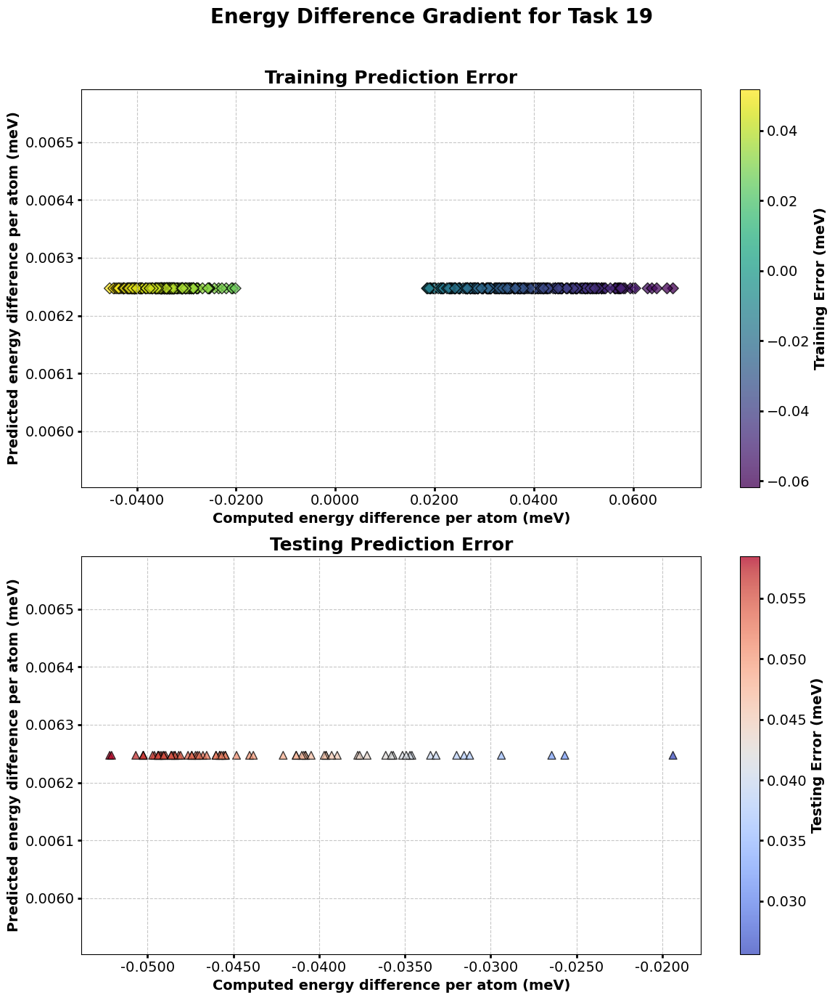

Training Task 17
(417, 416, 2, 1)
torch.Size([417, 832]) torch.Size([1, 417])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

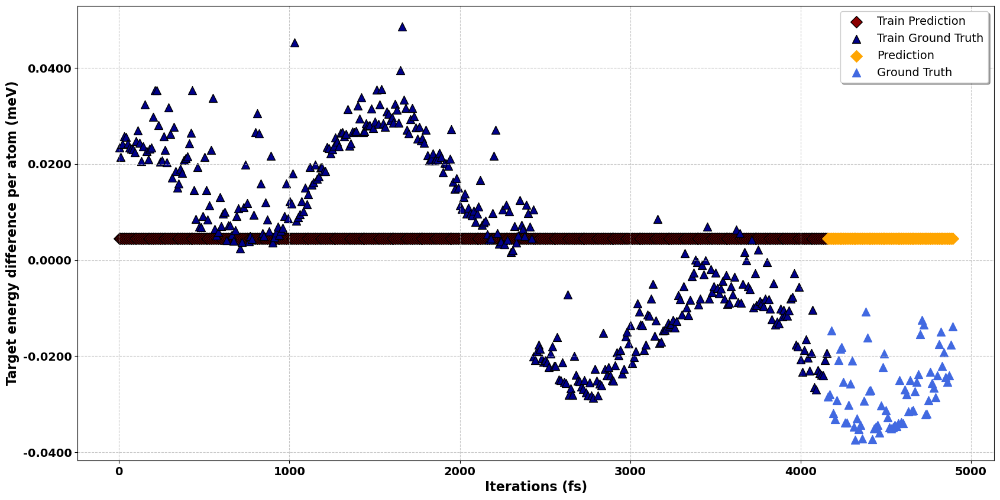

<Figure size 640x480 with 0 Axes>

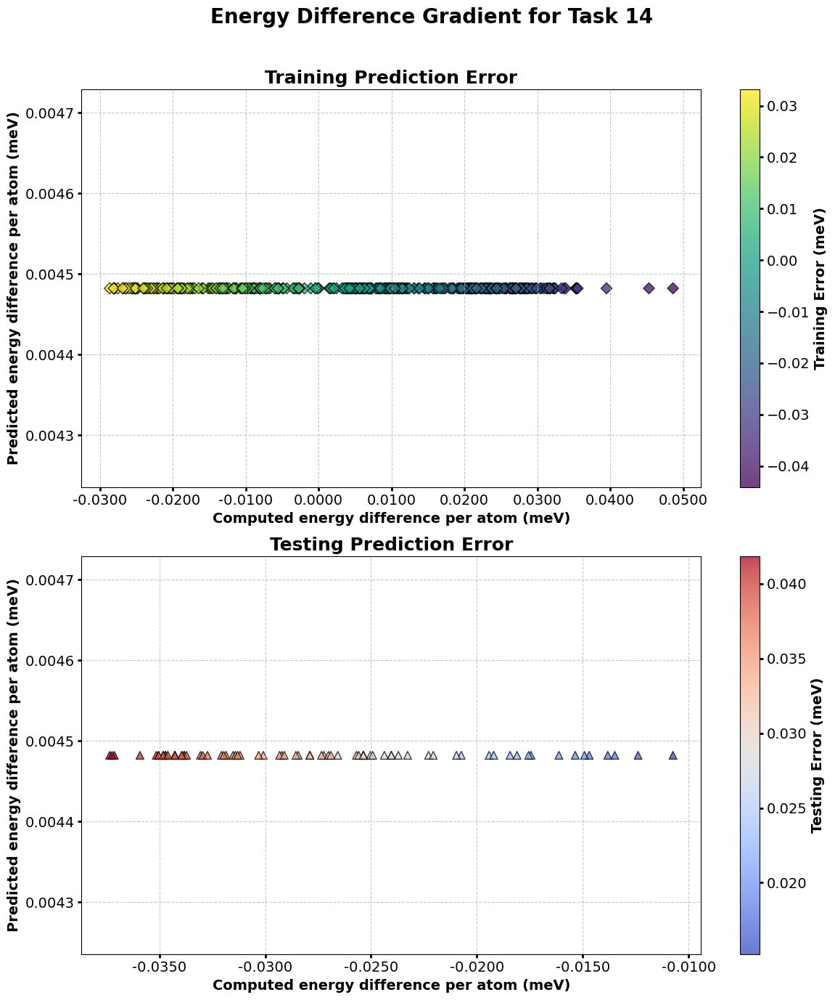

Training Task 18
(420, 416, 2, 1)
torch.Size([420, 832]) torch.Size([1, 420])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

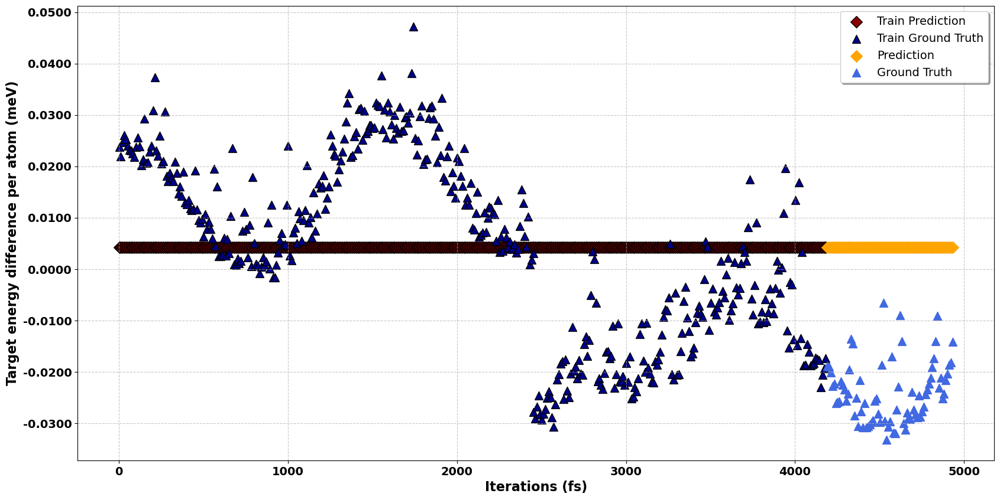

<Figure size 640x480 with 0 Axes>

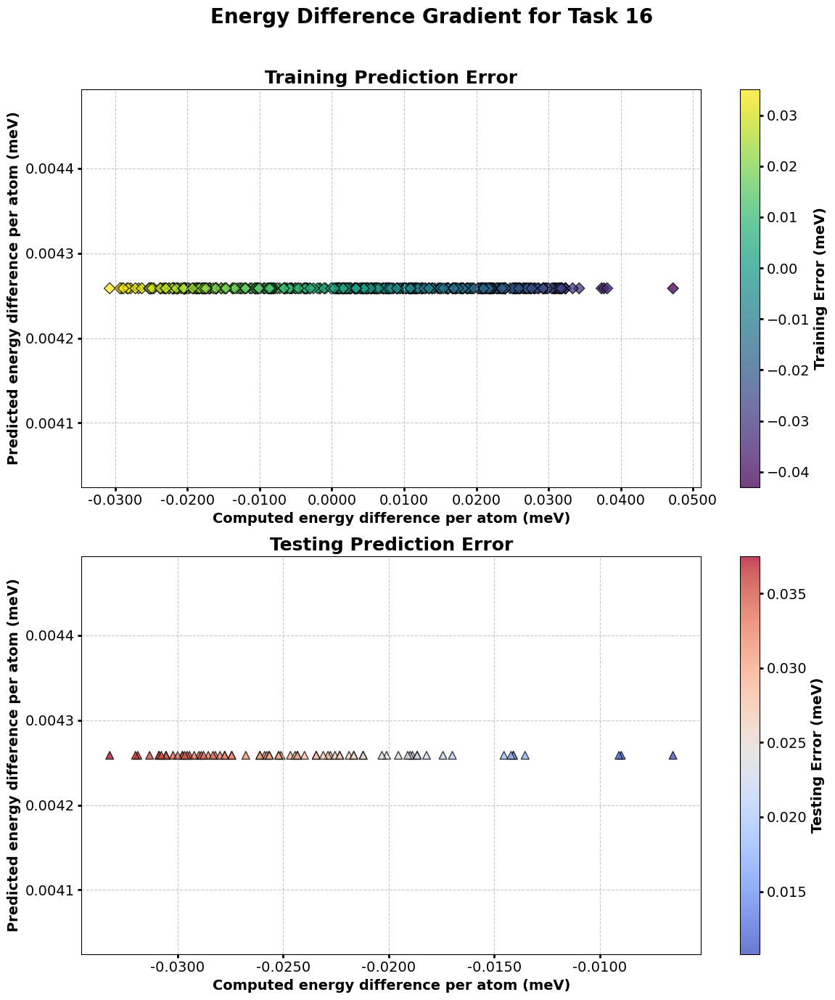

Training Task 19
(416, 416, 2, 1)
torch.Size([416, 832]) torch.Size([1, 416])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


<Figure size 640x480 with 0 Axes>

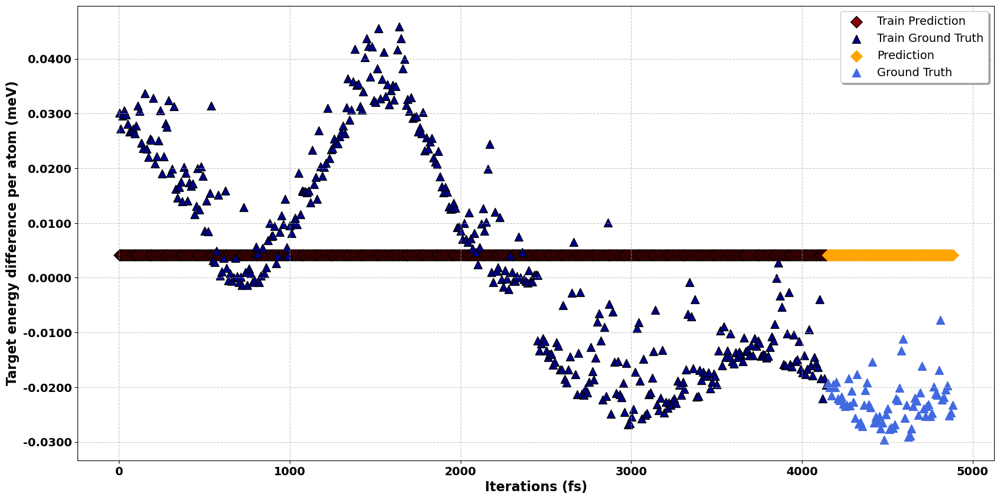

<Figure size 640x480 with 0 Axes>

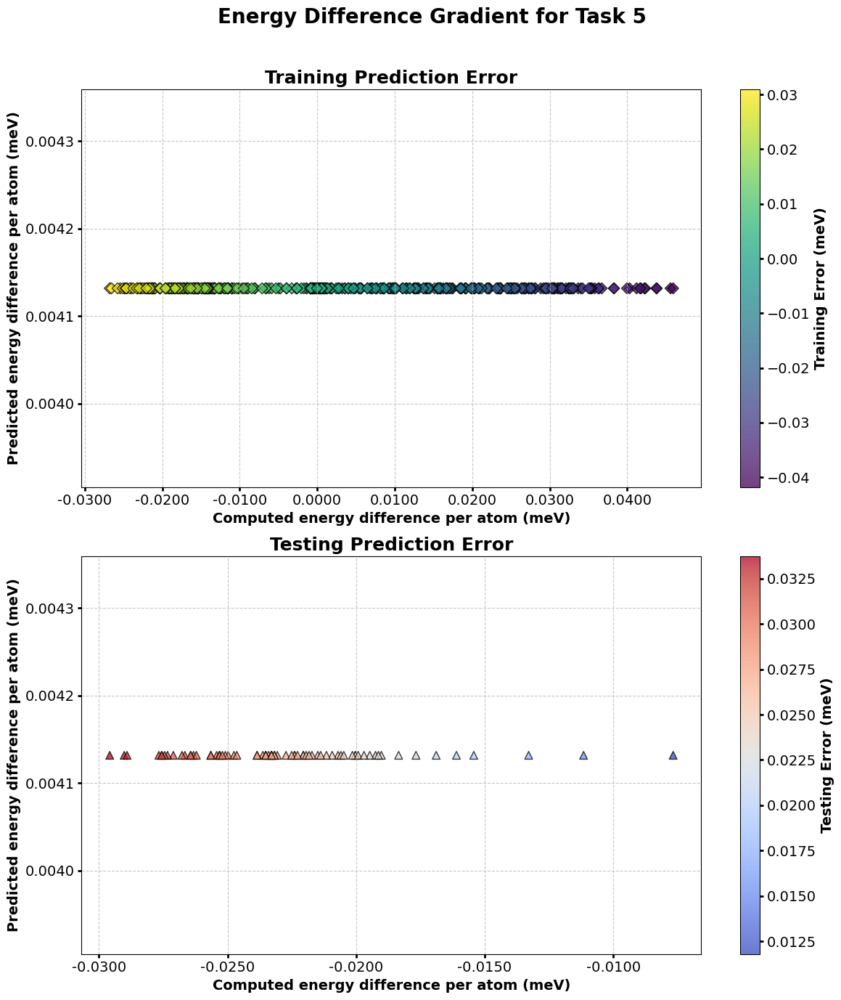

<Figure size 640x480 with 0 Axes>

In [19]:
datadim = 832
embedim = 2 
training_cycles = 100
n_tasks = 25
lr = 1e-2
augmentation = True
########### NOT USING THE BELOW FOR THIS AS IT IS DEFAULT RUN ################
'''

reptile = 'Reptile'

model_mod = torch.nn.Sequential(
                            torch.nn.Linear(datadim,2048),
                            torch.nn.ReLU(),
                            # torch.nn.Linear(10240,2048),
                            # torch.nn.ReLU(),
                            torch.nn.Linear(2048,1024),
                            torch.nn.ReLU(),
                            torch.nn.Linear(1024, 256),
                            torch.nn.ReLU(),
                            *(list(model_reptile.children())),)

scaler = False
'''

train_tasks, test_tasks = sequential_train_and_test_task(n_tasks,ind_to_val)
title = "Default Feature Extractor without scaling, Sequential tasks \n Reconstruction Graph"

results = single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,training_cycles=training_cycles,datadim=datadim,lr=lr,augmentation=augmentation)
# np.save(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/data_for_plot_generations/Data_defaultFE_noScaling.npy",results)

Simulated Images

In [17]:
def decimal_formatter_mod(x, pos):
    """ Format ticks to 2 decimal places. """
    return f'{x/1e-3:.4f}'

# @title Modified plotting functions
def mod_reconstruction_graph_plot(
    iterations_train, train_mean, y_train,
    iterations_test, mean, y_test,
    ind_to_val, title, task,
    scaler_flag, feature_extractor,
    training_cycles, lr, augmentation
):
    plt.figure(figsize=(20, 10))

    # Scatter plots
    plt.scatter(
        np.array(iterations_train), train_mean,
        c='darkred', marker='D', s=100, label="Train Prediction", edgecolor='k'
    )
    plt.scatter(
        np.array(iterations_train), y_train.reshape(-1, 1),
        c='darkblue', marker='^', s=100, label="Train Ground Truth", edgecolor='k'
    )
    plt.scatter(
        np.array(iterations_test), mean.reshape(1, -1),
        c='orange', marker='D', s=100, label="Prediction"
    )
    plt.scatter(
        np.array(iterations_test), y_test.reshape(1, -1),
        c='royalblue', marker='^', s=100, label="Ground Truth"
    )

    # Titles and labels with enhanced styles
    #plt.title(f"{title} from Task {task}", fontsize=22, fontweight='bold', color='darkgreen')
    plt.xlabel("Iterations (fs)", fontsize=16, fontweight='bold')
    plt.ylabel("Target energy difference per atom (meV)", fontsize=16, fontweight='bold')

    # Customize ticks
    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')

    # Add grid lines
    plt.grid(True, linestyle='--', alpha=0.7)

    # Customize legend
    plt.legend(fontsize=14, loc='best', frameon=True, shadow=True, fancybox=True)

    # Add background color
    #plt.gca().set_facecolor('lightgray')
    plt.gca().set_facecolor('white')
    #plt.gca().xaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))
    plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))

    # Save figure (uncomment if needed)
    #plt.savefig(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/single_tasks/reconstruction_graphs/Task{ind_to_val[task]}_Norm{scaler_flag}_{feature_extractor}_aug{augmentation}_training{training_cycles}_lr{lr}_reconstruction.png")

    plt.show()
    plt.clf()

def single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,**kwargs):
    datadim = kwargs.get("datadim", 43264)
    embedim = 2
    training_cycles = kwargs.get("training_cycles", 150)
    lr = kwargs.get("lr", 1e-2)
    scaler_flag = kwargs.get("scaler",False)
    results = {int(ind_to_val[task]):[] for task in train_tasks}
    feature_extractor = kwargs.get("reptile","default_FE")
    augmentation = kwargs.get("augmentation",True)
    print(feature_extractor)
    model_sample = torch.nn.Sequential(
                                torch.nn.Linear(datadim,10240),
                                torch.nn.ReLU(),
                                torch.nn.Linear(10240,2048),
                                torch.nn.ReLU(),
                                torch.nn.Linear(2048,1024),
                                torch.nn.ReLU(),
                                torch.nn.Linear(1024, 256),
                                torch.nn.ReLU(),
                                *(list(fcFeatureExtractor(256,embedim).children())),)

    model_mod = kwargs.get("model_mod",model_sample)
    

    for task in train_tasks:
        input_image = image_mask[task][0] #np.concatenate([image_mask[task][1][:,:,0],image_mask[task][1][:,:,1]],axis=1)
        print(f"Training Task {ind_to_val[task]}")
        (X_train, X_test, y_train, y_test, iterations_train, iterations_test) = train_test_split(
            input_image, energy_to_ind[task]["target_total_energy_per_atom"], energy_to_ind[task]['Iteration'], test_size=0.15, shuffle=False, random_state=2)
        # X_train, y_train = image_mask[0][0], energy_to_ind[0]["target_energy"]
        
        print(X_train.shape)
        
        X_train = np.squeeze(X_train)
        X_test = np.squeeze(X_test)

        s1,s2,s3 = X_train.shape
        X_train = X_train.reshape(-1,s2*s3)
        X_test = X_test.reshape(-1,s2*s3)


        y_train = np.array(y_train).reshape(1,-1)
        y_test = np.array(y_test).reshape(1,-1) 

        if scaler_flag:
            X_train = scaler_fun.fit_transform(X_train)
            X_test = scaler_fun.fit_transform(X_test)
        
        X , y = torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32)
        y = y.reshape(1,-1)    

        print(X.shape,y.shape)
        dklgp = dklgpreg.dklGPR(datadim,embedim,hidden_dim=[1000,500,50],feature_extract=copy.deepcopy(model_mod),precision="single")#aoi.models.dklGPR(data_dim, embedim=2, precision="double")
        dklgp.fit(X, y, training_cycles=training_cycles, lr=lr)

        training_loss = list(dklgp.train_loss)
        
        with torch.no_grad():
            train_mean, train_var = dklgp.predict(X)
            mean, var = dklgp.predict(X_test)
        
        # torch.save(dklgp,f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/single_tasks/model/Task{ind_to_val[task]}_Norm{scaler_flag}_{feature_extractor}_training{training_cycles}_lr{lr}_model.pt")
        clear_gpu_cache()
        print("Pred: ",mean.shape,y_test.shape)
        # Reconstruction Graph
        mod_reconstruction_graph_plot(iterations_train,train_mean,y_train,iterations_test,mean,y_test,ind_to_val,title,task,scaler_flag,feature_extractor,training_cycles,lr,augmentation)

        # Gradient Plotting
        #color_gradient_difference_plot(y_test.reshape(-1,1),mean.reshape(-1,1),ind_to_val[task],feature_extractor,scaler_flag,augmentation)
        #distribution_plotting(y_test.reshape(-1,1),mean.reshape(-1,1),ind_to_val[task],feature_extractor,scaler_flag)
        # color_gradient_difference_plot_modified(y_test.reshape(-1,1), mean, train_mean, y_train.reshape(-1,1), task, feature_extractor, scaler_flag,augmentation)
        #Training Loss plotting
        # mod_plot_training_loss(training_loss,ind_to_val[task],scaler_flag,feature_extractor,training_cycles,lr,augmentation)

        results[int(ind_to_val[task])] = [iterations_train,iterations_test,train_mean,mean,y_train,y_test,feature_extractor,training_loss,scaler_flag,ind_to_val,title,training_cycles,lr]
    return results

default_FE
Training Task 1
(338, 1, 208, 208)
torch.Size([338, 43264]) torch.Size([1, 338])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (60,) (1, 60)


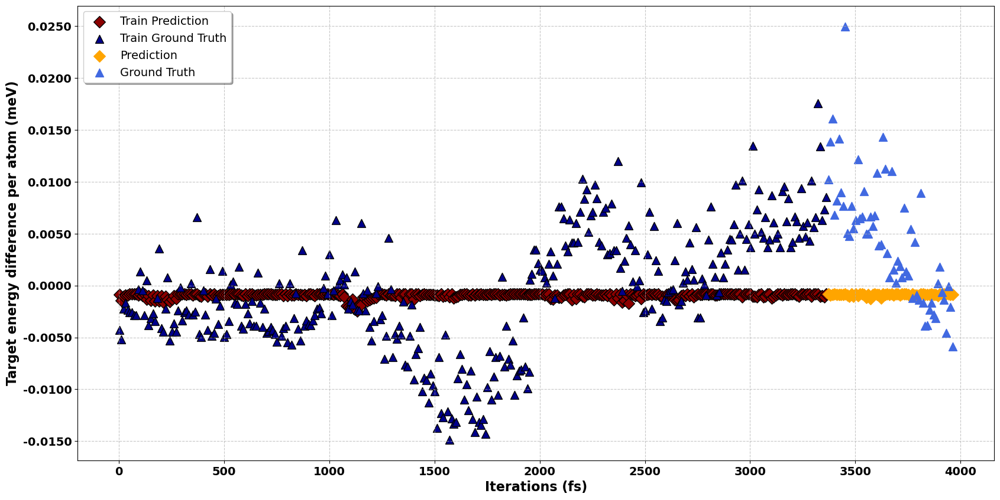

Training Task 2
(343, 1, 208, 208)
torch.Size([343, 43264]) torch.Size([1, 343])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (61,) (1, 61)


<Figure size 640x480 with 0 Axes>

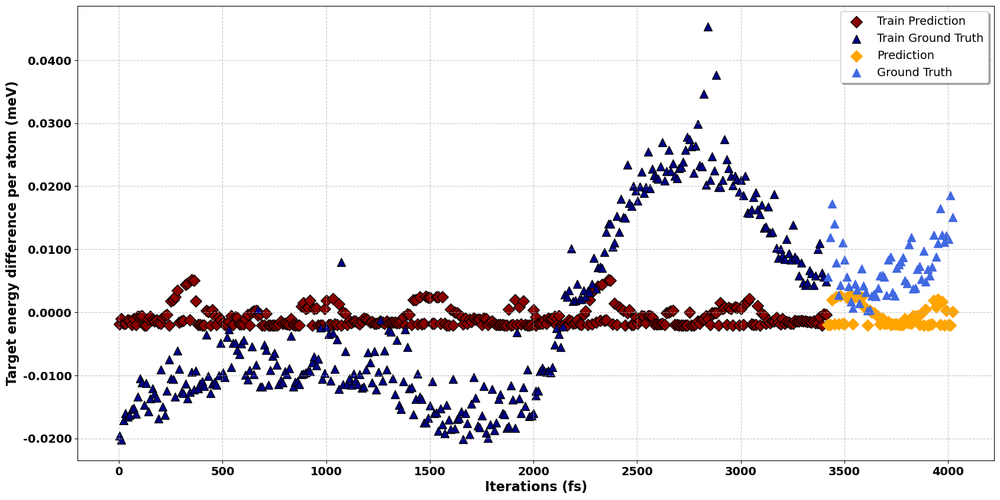

Training Task 3
(346, 1, 208, 208)
torch.Size([346, 43264]) torch.Size([1, 346])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (62,) (1, 62)


<Figure size 640x480 with 0 Axes>

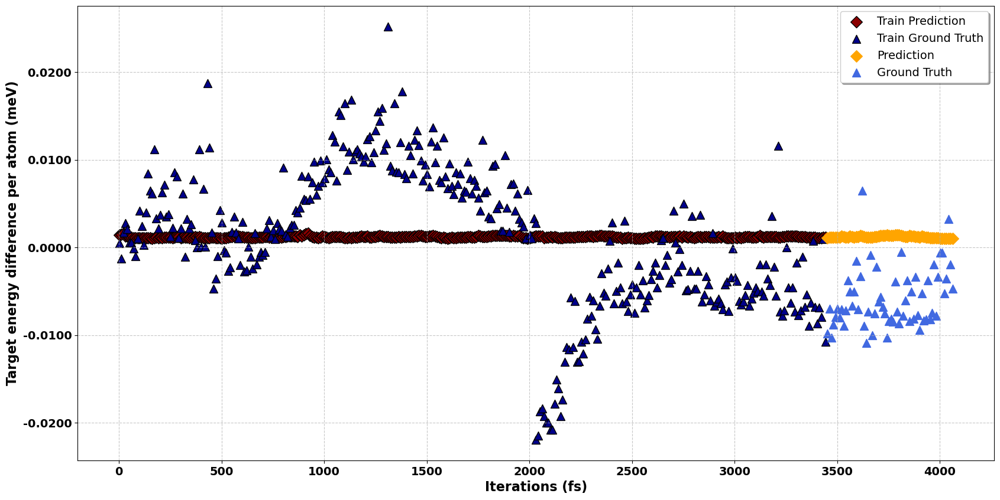

Training Task 4
(348, 1, 208, 208)
torch.Size([348, 43264]) torch.Size([1, 348])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (62,) (1, 62)


<Figure size 640x480 with 0 Axes>

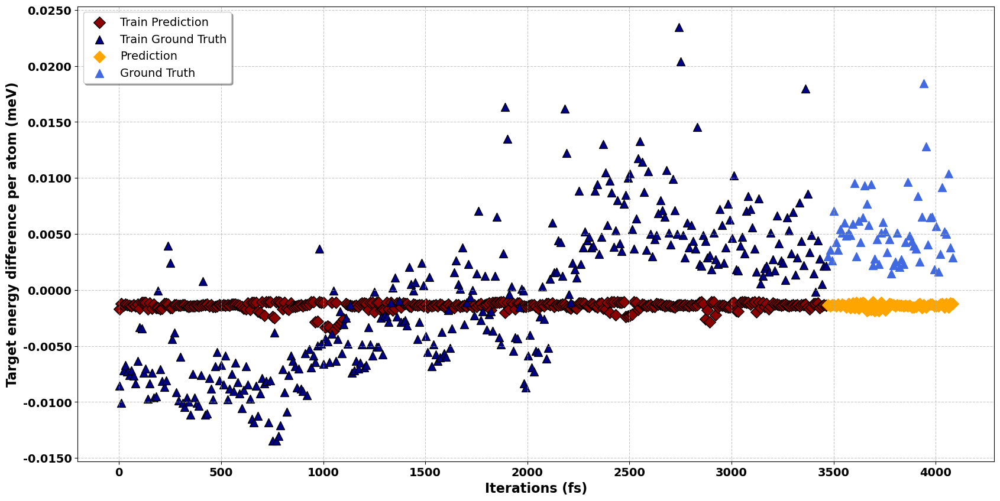

Training Task 5
(376, 1, 208, 208)
torch.Size([376, 43264]) torch.Size([1, 376])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (67,) (1, 67)


<Figure size 640x480 with 0 Axes>

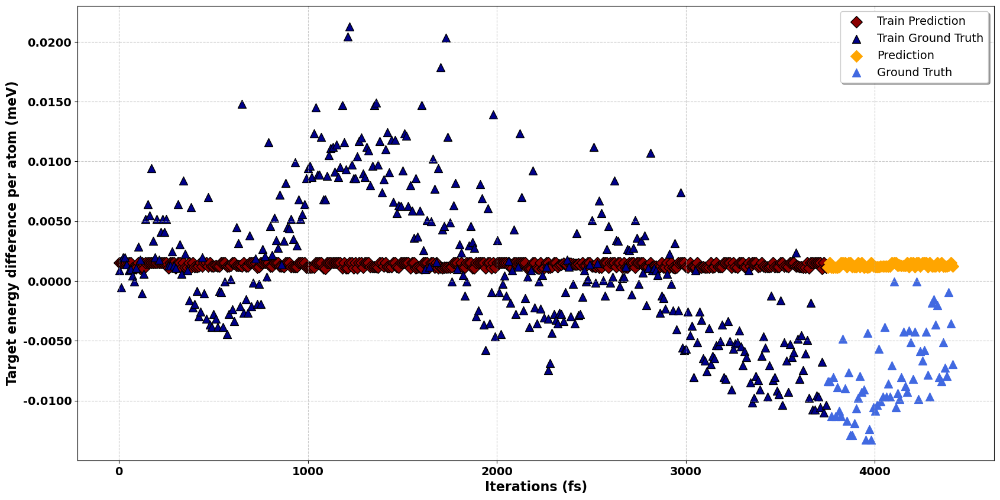

Training Task 6
(355, 1, 208, 208)
torch.Size([355, 43264]) torch.Size([1, 355])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (63,) (1, 63)


<Figure size 640x480 with 0 Axes>

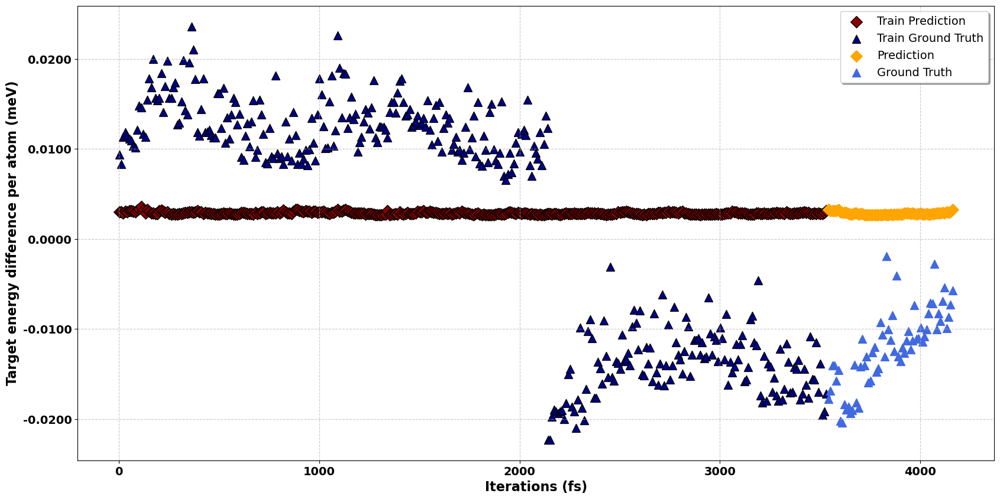

Training Task 7
(379, 1, 208, 208)
torch.Size([379, 43264]) torch.Size([1, 379])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (67,) (1, 67)


<Figure size 640x480 with 0 Axes>

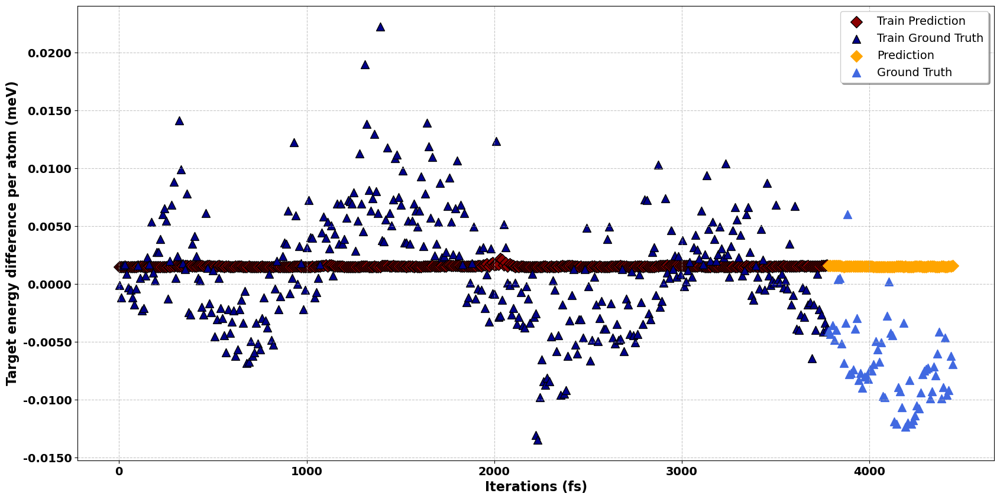

Training Task 8
(379, 1, 208, 208)
torch.Size([379, 43264]) torch.Size([1, 379])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (67,) (1, 67)


<Figure size 640x480 with 0 Axes>

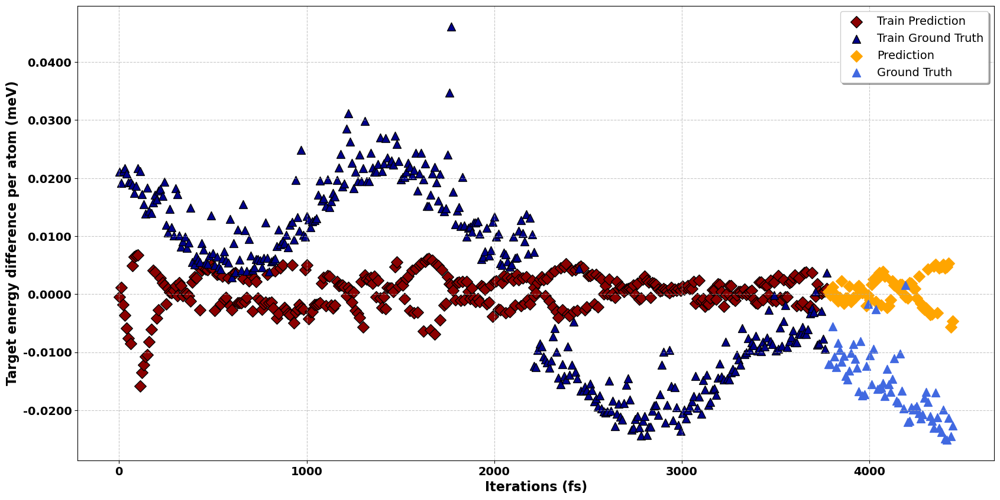

Training Task 9
(384, 1, 208, 208)
torch.Size([384, 43264]) torch.Size([1, 384])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (68,) (1, 68)


<Figure size 640x480 with 0 Axes>

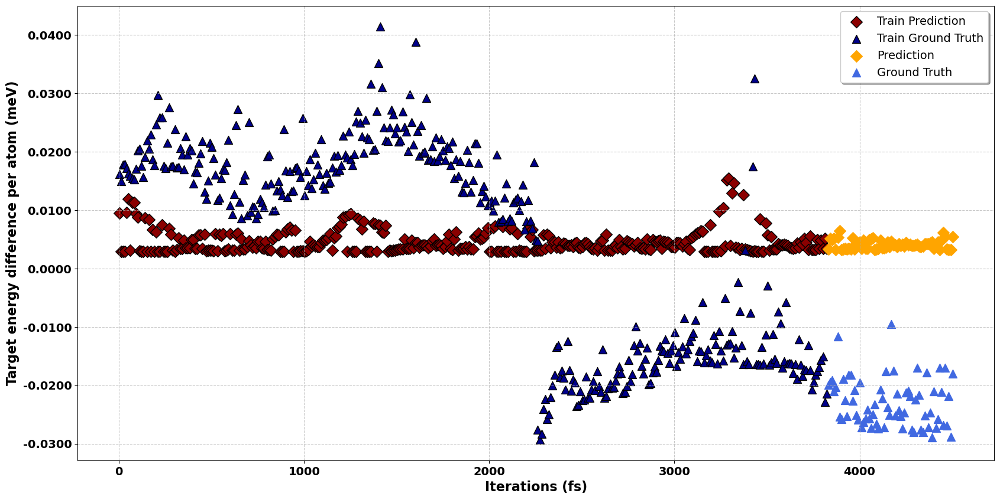

Training Task 10
(232, 1, 208, 208)
torch.Size([232, 43264]) torch.Size([1, 232])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (42,) (1, 42)


<Figure size 640x480 with 0 Axes>

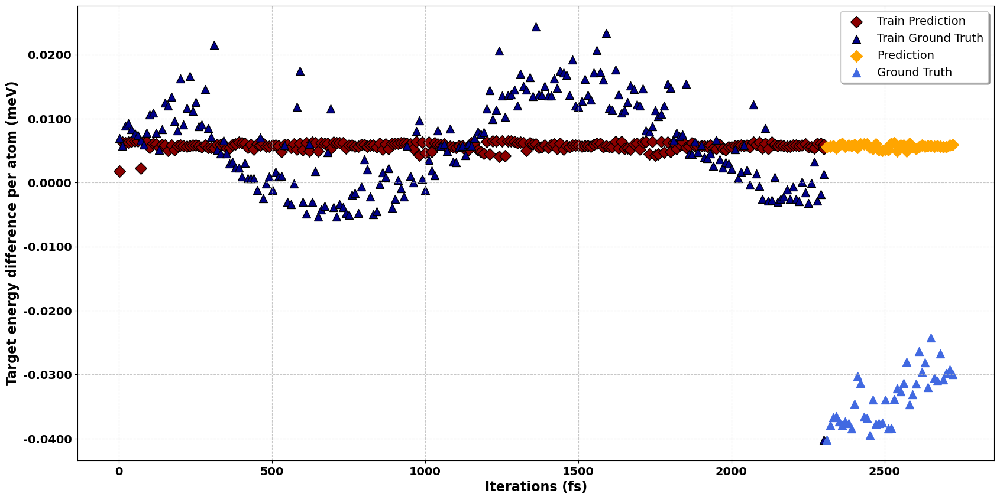

Training Task 11
(388, 1, 208, 208)
torch.Size([388, 43264]) torch.Size([1, 388])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (69,) (1, 69)


<Figure size 640x480 with 0 Axes>

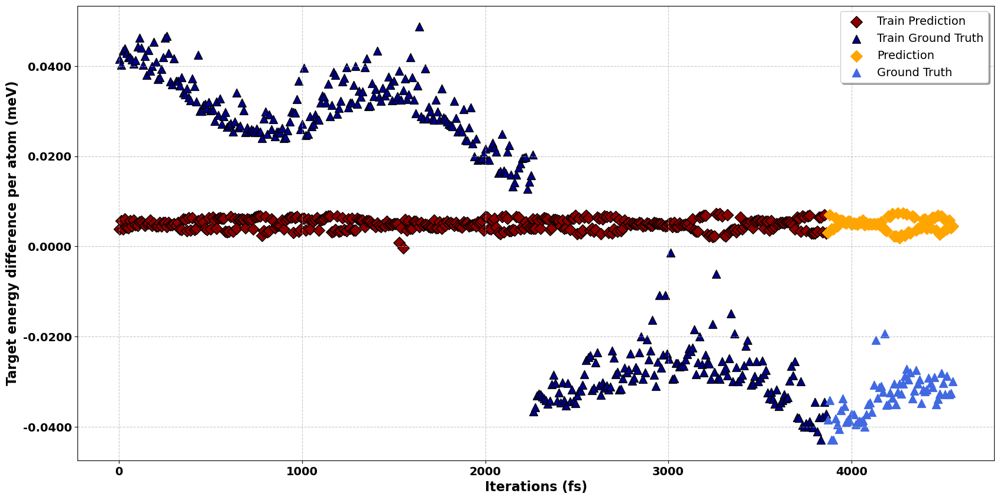

Training Task 12
(410, 1, 208, 208)
torch.Size([410, 43264]) torch.Size([1, 410])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (73,) (1, 73)


<Figure size 640x480 with 0 Axes>

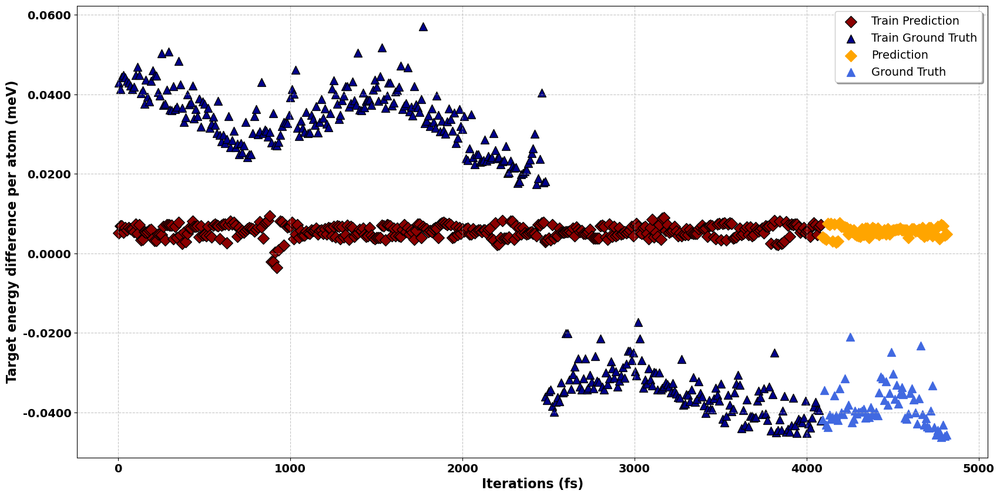

Training Task 13
(420, 1, 208, 208)
torch.Size([420, 43264]) torch.Size([1, 420])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (75,) (1, 75)


<Figure size 640x480 with 0 Axes>

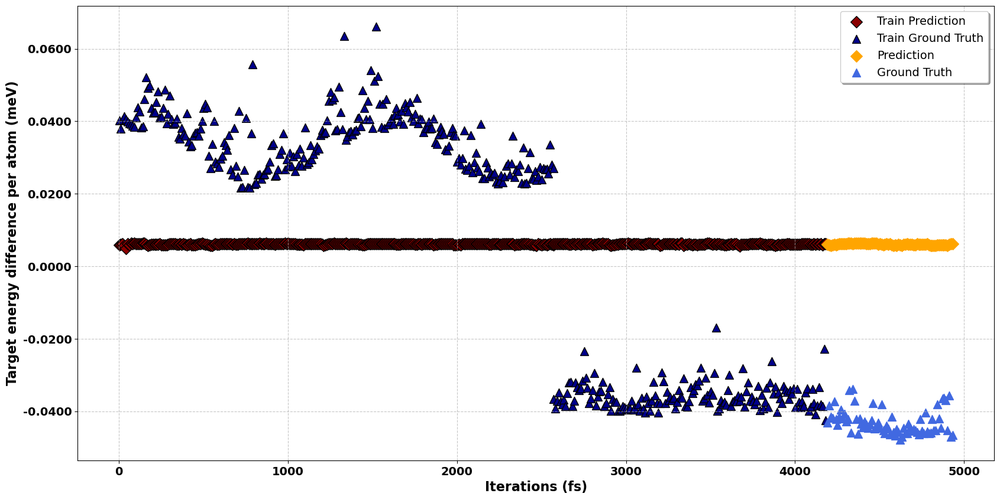

Training Task 14
(401, 1, 208, 208)
torch.Size([401, 43264]) torch.Size([1, 401])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (71,) (1, 71)


<Figure size 640x480 with 0 Axes>

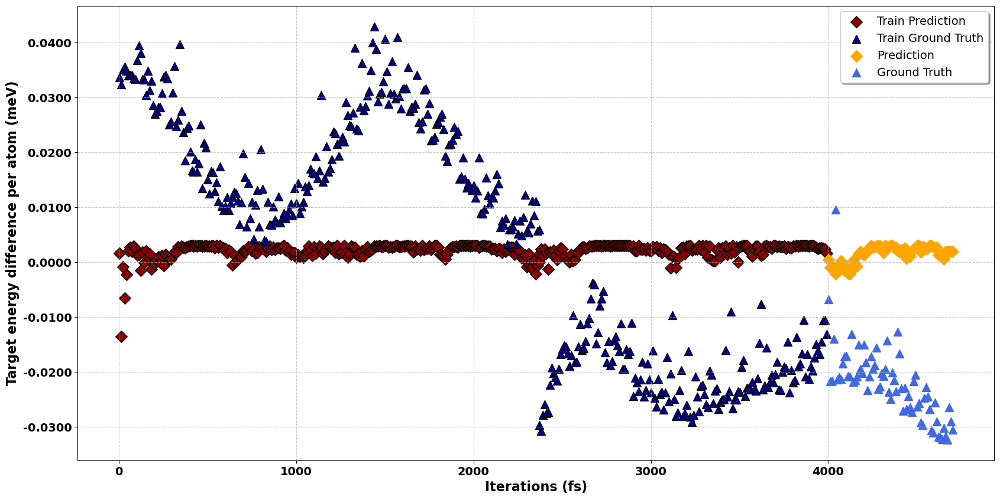

Training Task 15
(394, 1, 208, 208)
torch.Size([394, 43264]) torch.Size([1, 394])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (70,) (1, 70)


<Figure size 640x480 with 0 Axes>

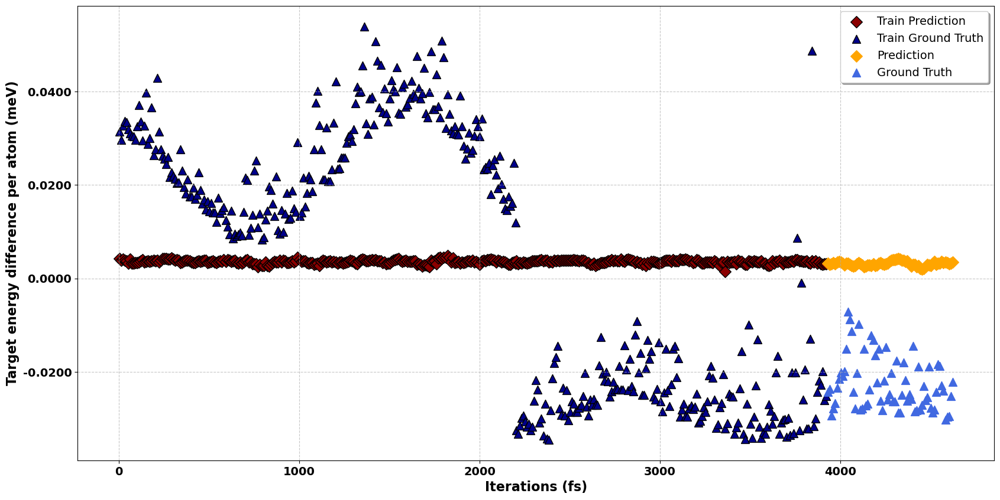

Training Task 16
(414, 1, 208, 208)
torch.Size([414, 43264]) torch.Size([1, 414])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (74,) (1, 74)


<Figure size 640x480 with 0 Axes>

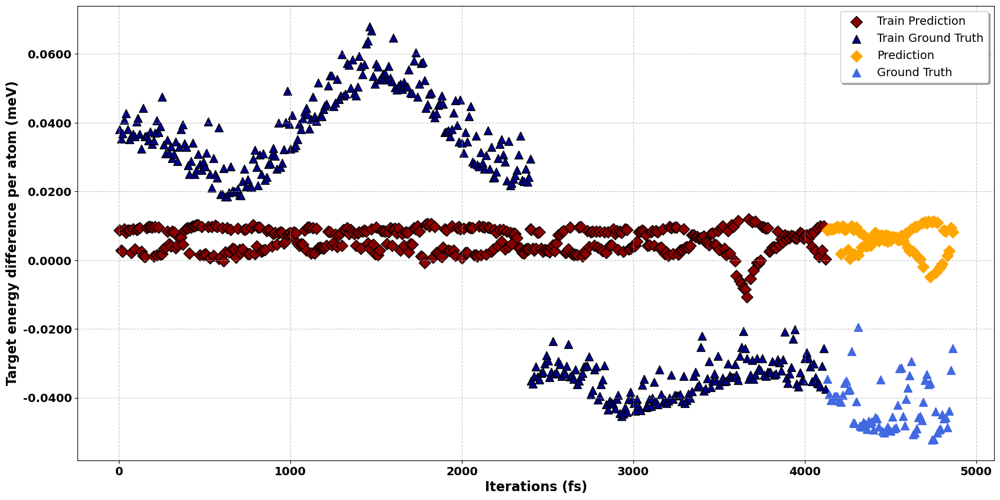

Training Task 17
(417, 1, 208, 208)
torch.Size([417, 43264]) torch.Size([1, 417])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (74,) (1, 74)


<Figure size 640x480 with 0 Axes>

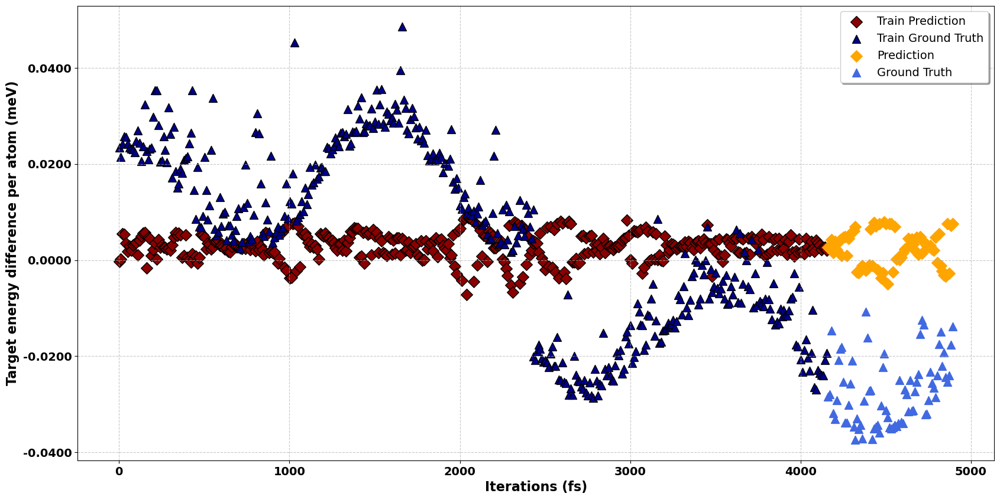

Training Task 18
(420, 1, 208, 208)
torch.Size([420, 43264]) torch.Size([1, 420])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (75,) (1, 75)


<Figure size 640x480 with 0 Axes>

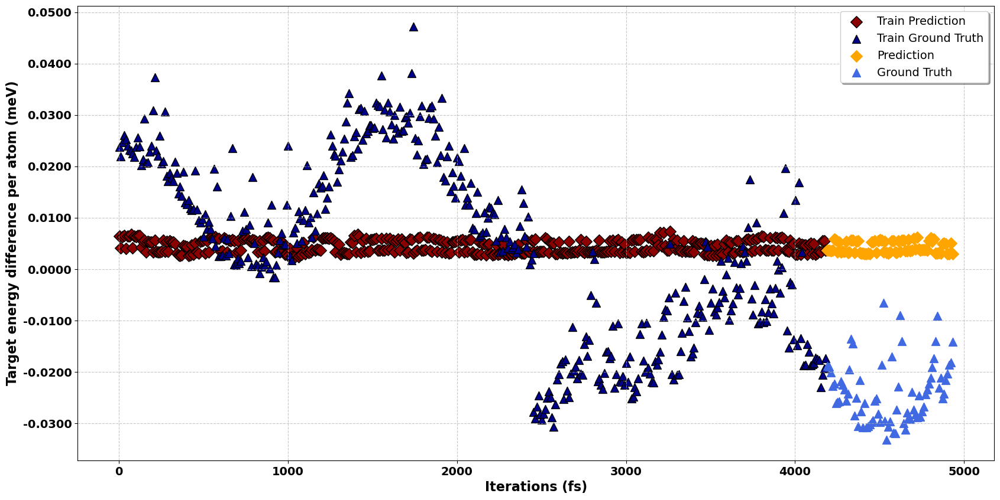

Training Task 19
(416, 1, 208, 208)
torch.Size([416, 43264]) torch.Size([1, 416])
dtype : torch.float32


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


Pred:  (74,) (1, 74)


<Figure size 640x480 with 0 Axes>

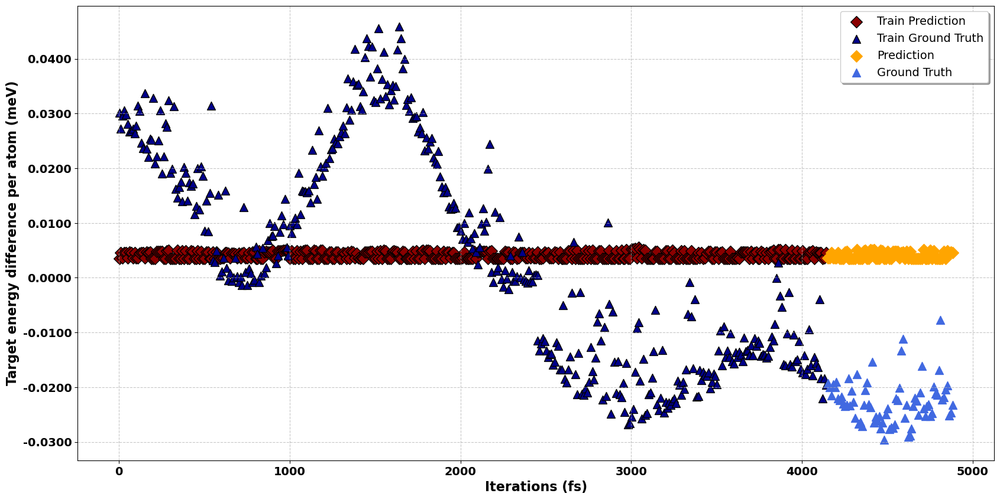

<Figure size 640x480 with 0 Axes>

In [85]:
datadim = 43264
embedim = 2 
training_cycles = 100
n_tasks = 25
lr = 1e-2
augmentation = True
########### NOT USING THE BELOW FOR THIS AS IT IS DEFAULT RUN ################
'''

reptile = 'Reptile'

model_mod = torch.nn.Sequential(
                            torch.nn.Linear(datadim,2048),
                            torch.nn.ReLU(),
                            # torch.nn.Linear(10240,2048),
                            # torch.nn.ReLU(),
                            torch.nn.Linear(2048,1024),
                            torch.nn.ReLU(),
                            torch.nn.Linear(1024, 256),
                            torch.nn.ReLU(),
                            *(list(model_reptile.children())),)

scaler = False
'''

train_tasks, test_tasks = sequential_train_and_test_task(n_tasks,ind_to_val)
title = "Default Feature Extractor without scaling, Sequential tasks \n Reconstruction Graph"

results = single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,training_cycles=training_cycles,datadim=datadim,lr=lr,augmentation=augmentation)
# np.save(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/data_for_plot_generations/Data_defaultFE_noScaling.npy",results)

CNN Model

In [20]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from matplotlib.ticker import FuncFormatter
from torch.nn import Module
from torch.nn import Conv2d
from torch.nn import Linear
from torch.nn import MaxPool2d
from torch.nn import ReLU
from torch.nn import LogSoftmax
from torch import flatten

class LeNet(nn.Module):
	def __init__(self, numChannels, classes):
		# call the parent constructor
		super(LeNet, self).__init__()
		# initialize first set of CONV => RELU => POOL layers
		self.conv1 = Conv2d(in_channels=numChannels, out_channels=20,
			kernel_size=(50, 50))
		self.relu1 = ReLU()
		self.maxpool1 = MaxPool2d(kernel_size=(20, 20), stride=(2, 2))
		# initialize second set of CONV => RELU => POOL layers
		self.conv2 = Conv2d(in_channels=20, out_channels=10,
			kernel_size=(20, 20))
		self.relu2 = ReLU()
		self.maxpool2 = MaxPool2d(kernel_size=(10, 10), stride=(2, 2))
		# initialize first (and only) set of FC => RELU layers
		# self.fc = Linear(in_features=120050,out_features=4096),
		# self.relu = ReLU()
		# self.fcc = Linear(in_features=4096,out_features=800),
		# self.reluu = ReLU()
		self.fc1 = Linear(in_features=4410, out_features=2048)
		self.relu3 = ReLU()

		self.fc2 = Linear(in_features=2048, out_features=512)
		self.relu4 = ReLU()

		self.fc4 = Linear(in_features=512, out_features=256)
		self.relu5 = ReLU()
		# initialize our softmax classifier
		self.fc3 = Linear(in_features=256, out_features=128)
		self.relu6 = ReLU()
		self.fc5 = Linear(in_features=128, out_features=1)
		#self.logSoftmax = LogSoftmax(dim=1)
        #*(list(fcFeatureExtractor(256,embedim).children()))
	def forward(self, x):
		# pass the input through our first set of CONV => RELU =>
		# POOL layers
		x = self.conv1(x)
		x = self.relu1(x)
		x = self.maxpool1(x)
		# pass the output from the previous layer through the second
		# set of CONV => RELU => POOL layers
		x = self.conv2(x)
		x = self.relu2(x)
		x = self.maxpool2(x)
		# flatten the output from the previous layer and pass it
		# through our only set of FC => RELU layers
		x = flatten(x, 1)
		print("Shape: ",x.shape)
		# x = self.fc(x) 
		# x = self.relu(x)
		# x = self.fcc(x)
		# x = self.reluu(x)
		x = self.fc1(x)
		x = self.relu3(x)

		x = self.fc2(x)
		x = self.relu4(x)

		x = self.fc4(x)
		x = self.relu5(x)

		# x = self.fc2(x)
		# x = self.relu4(x)


		# pass the output to our softmax classifier to get our output
		# predictions
		x = self.fc3(x)
		x = self.relu6(x)
		
		output = self.fc5(x)
		# output = self.logSoftmax(x)
		# return the output predictions
		return output

In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from matplotlib.ticker import FuncFormatter
from torch.nn import Module
from torch.nn import Conv2d
from torch.nn import Linear
from torch.nn import MaxPool2d
from torch.nn import ReLU
from torch.nn import LogSoftmax
from torch import flatten

embedim = 2

def decimal_formatter_mod(x, pos):
    """ Format ticks to 2 decimal places. """
    return f'{x/1e-3:.4f}'

def mod_reconstruction_graph_plot(
    iterations_train, train_mean, y_train,
    iterations_test, mean, y_test,
    ind_to_val, title, task,
    scaler_flag, feature_extractor,
    training_cycles, lr, augmentation
):
    plt.figure(figsize=(20, 10))

    plt.scatter(
        np.array(iterations_train), train_mean,
        c='darkred', marker='D', s=100, label="Train Prediction", edgecolor='k'
    )
    plt.scatter(
        np.array(iterations_train), y_train.reshape(-1, 1),
        c='darkblue', marker='^', s=100, label="Train Ground Truth", edgecolor='k'
    )
    plt.scatter(
        np.array(iterations_test), mean.reshape(1, -1),
        c='orange', marker='D', s=100, label="Prediction"
    )
    plt.scatter(
        np.array(iterations_test), y_test.reshape(1, -1),
        c='royalblue', marker='^', s=100, label="Ground Truth"
    )

    plt.xlabel("Iterations (fs)", fontsize=16, fontweight='bold')
    plt.ylabel("Target energy difference per atom (meV)", fontsize=16, fontweight='bold')
    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.legend(fontsize=14, loc='best', frameon=True, shadow=True, fancybox=True)
    plt.gca().set_facecolor('white')
    plt.gca().yaxis.set_major_formatter(FuncFormatter(decimal_formatter_mod))
    plt.show()
    plt.clf()

class SimpleCNN(nn.Module):
    def __init__(self, input_dim, embedim):
        super(SimpleCNN, self).__init__()
        self.conv1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.fc1 = nn.Linear(128 * (input_dim // 8) * (input_dim // 8), 1024)
        self.fc2 = nn.Linear(1024, embedim)
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2, padding=0)

    def forward(self, x):
        x = self.pool(self.relu(self.conv1(x)))
        x = self.pool(self.relu(self.conv2(x)))
        x = self.pool(self.relu(self.conv3(x)))
        x = x.view(x.size(0), -1)
        x = self.relu(self.fc1(x))
        x = self.fc2(x)
        return x

def single_model_training_and_validation_mask(train_tasks, ind_to_val, image_mask, energy_to_ind, title, **kwargs):
    datadim = kwargs.get("datadim", 64)
    embedim = 2
    training_cycles = kwargs.get("training_cycles", 10)
    lr = kwargs.get("lr", 1e-2)
    scaler_flag = kwargs.get("scaler", False)
    results = {int(ind_to_val[task]): [] for task in train_tasks}
    feature_extractor = kwargs.get("reptile", "default_FE")
    augmentation = kwargs.get("augmentation", True)
    print(feature_extractor)
    
    
    for task in train_tasks:
        input_image = image_mask[task][0]
        print(f"Training Task {ind_to_val[task]}")
        (X_train, X_test, y_train, y_test, iterations_train, iterations_test) = train_test_split(
            input_image, energy_to_ind[task]["target_total_energy_per_atom"], energy_to_ind[task]['Iteration'], test_size=0.15, shuffle=False, random_state=2)
        
        print(X_train.shape)
        
        X_train = np.squeeze(X_train)
        X_test = np.squeeze(X_test)

        s1, s2, s3 = X_train.shape
        X_train = X_train.reshape(-1, s2, s3)
        X_test = X_test.reshape(-1, s2, s3)

        print(X_train.shape)
        num_channels = X_train.shape[-1]
        print(num_channels)
        model_sample = LeNet(1, embedim)
        model_mod = kwargs.get("model_mod", model_sample)

        y_train = np.array(y_train).reshape(1, -1)
        y_test = np.array(y_test).reshape(1, -1)

        if scaler_flag:
            X_train = scaler_fun.fit_transform(X_train)
            X_test = scaler_fun.fit_transform(X_test)
        
        X_train = X_train[:, np.newaxis, :, :]
        X_test = X_test[:, np.newaxis, :, :]
        
        X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
        X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
        y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
        y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

        print(X_train_tensor.shape, y_train_tensor.shape)

        optimizer = optim.Adam(model_mod.parameters(), lr=lr)
        criterion = nn.MSELoss()

        
        for epoch in range(training_cycles):
            model_mod.train()
            optimizer.zero_grad()
            outputs = model_mod(X_train_tensor)
            print("Outputs: ",outputs.shape)
            loss = criterion(outputs, y_train_tensor)
            loss.backward()
            optimizer.step()
        
        model_mod.eval()
        with torch.no_grad():
            train_mean = model_mod(X_train_tensor).numpy()
            mean = model_mod(X_test_tensor).numpy()
        
        clear_gpu_cache()
        print("Pred: ", mean.shape, y_test.shape)
        
        mod_reconstruction_graph_plot(iterations_train, train_mean, y_train, iterations_test, mean, y_test, ind_to_val, title, task, scaler_flag, feature_extractor, training_cycles, lr, augmentation)
        color_gradient_difference_plot_modified(y_test.reshape(-1,1), mean, train_mean, y_train.reshape(-1,1), task, feature_extractor, scaler_flag,augmentation)
        #Training Loss plotting
        # mod_plot_training_loss(training_loss,ind_to_val[task],scaler_flag,feature_extractor,training_cycles,lr,augmentation)
        results[int(ind_to_val[task])] = [iterations_train, iterations_test, train_mean, mean, y_train, y_test, feature_extractor, scaler_flag, ind_to_val, title, training_cycles, lr]
    return results


In [22]:
clear_gpu_cache()

In [23]:
datadim = 43264
embedim = 2 
training_cycles = 30
n_tasks = 25
lr = 1e-2
torch.set_default_device("cpu")
augmentation = True
########### NOT USING THE BELOW FOR THIS AS IT IS DEFAULT RUN ################
'''

reptile = 'Reptile'

model_mod = torch.nn.Sequential(
                            torch.nn.Linear(datadim,2048),
                            torch.nn.ReLU(),
                            # torch.nn.Linear(10240,2048),
                            # torch.nn.ReLU(),
                            torch.nn.Linear(2048,1024),
                            torch.nn.ReLU(),
                            torch.nn.Linear(1024, 256),
                            torch.nn.ReLU(),
                            *(list(model_reptile.children())),)

scaler = False
'''

train_tasks, test_tasks = sequential_train_and_test_task(n_tasks,ind_to_val)
title = "Default Feature Extractor without scaling, Sequential tasks \n Reconstruction Graph"

results = single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,training_cycles=training_cycles,datadim=datadim,lr=lr,augmentation=augmentation)
# np.save(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/data_for_plot_generations/Data_defaultFE_noScaling.npy",results)

default_FE
Training Task 1
(338, 1, 208, 208)
(338, 208, 208)
208
torch.Size([338, 1, 208, 208]) torch.Size([1, 338])
Shape:  torch.Size([338, 4410])
Outputs:  torch.Size([338, 1])


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: Using a target size (torch.Size([1, 338])) that is different to the input size (torch.Size([338, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return func(*args, **kwargs)


Shape:  torch.Size([338, 4410])
Outputs:  torch.Size([338, 1])
Shape:  torch.Size([338, 4410])
Outputs:  torch.Size([338, 1])
Shape:  torch.Size([338, 4410])
Outputs:  torch.Size([338, 1])


Autoencoder - Decoder for reconstructing images

In [60]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader


class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, stride=2, padding=1),  # 1x28x28 -> 64x14x14
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 64x14x14 -> 128x7x7
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(256),
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # 128x8x8 -> 64x16x16
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1),  # 64x16x16 -> 1x32x32
            nn.Sigmoid()  # Use sigmoid for pixel values in [0, 1]
        )
    
    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Instantiate the model
autoencoder = Autoencoder()

In [83]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, stride=2, padding=1),  # 1x28x28 -> 64x14x14
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 64x14x14 -> 128x7x7
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.Conv2d(256, 64, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 16, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(16)
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(16, 64, kernel_size=4, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64, 256, kernel_size=3, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1),  # 128x8x8 -> 64x16x16
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64, 1, kernel_size=2, stride=2, padding=1),  # 64x16x16 -> 1x32x32
            nn.Sigmoid()  # Use sigmoid for pixel values in [0, 1]
        )
    def forward(self, x):
            x = self.encoder(x)
            x = self.decoder(x)
            return x

# Instantiate the model
autoencoder = Autoencoder()

In [61]:
def show_images(original, reconstructed):
    fig, axes = plt.subplots(2, 10, figsize=(15, 3))
    for i in range(10):
        axes[0, i].imshow(original[i].squeeze(), cmap='gray' , label = "Original")
        axes[0, i].axis('off')
        axes[1, i].imshow(reconstructed[i].squeeze(), cmap='viridis', label = "Reconstructed")
        axes[1, i].axis('off')
    plt.legend()
    plt.show()

In [62]:

def single_model_training_and_validation_mask(train_tasks, ind_to_val, image_mask, energy_to_ind, title, **kwargs):
    datadim = kwargs.get("datadim", 64)
    embedim = 2
    training_cycles = kwargs.get("training_cycles", 10)
    lr = kwargs.get("lr", 1e-2)
    scaler_flag = kwargs.get("scaler", False)
    results = {int(ind_to_val[task]): [] for task in train_tasks}
    feature_extractor = kwargs.get("reptile", "default_FE")
    augmentation = kwargs.get("augmentation", True)
    print(feature_extractor)
    
    
    for task in train_tasks:
        input_image = image_mask[task][0]
        print(f"Training Task {ind_to_val[task]}")
        (X_train, X_test, y_train, y_test, iterations_train, iterations_test) = train_test_split(
            input_image, energy_to_ind[task]["target_total_energy_per_atom"], energy_to_ind[task]['Iteration'], test_size=0.15, shuffle=True, random_state=2)
        
        print(X_train.shape)
        
        X_train = np.squeeze(X_train)
        X_test = np.squeeze(X_test)

        s1, s2, s3 = X_train.shape
        X_train = X_train.reshape(-1, s2, s3)
        X_test = X_test.reshape(-1, s2, s3)

        print(X_train.shape)
        num_channels = X_train.shape[-1]
        print(num_channels)
        # model_sample = LeNet(1, embedim)
        # model_mod = kwargs.get("model_mod", model_sample)

        y_train = np.array(y_train).reshape(1, -1)
        y_test = np.array(y_test).reshape(1, -1)

        if scaler_flag:
            X_train = scaler_fun.fit_transform(X_train)
            X_test = scaler_fun.fit_transform(X_test)
        
        X_train = X_train[:, np.newaxis, :, :]
        X_test = X_test[:, np.newaxis, :, :]
        
        X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
        X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
        y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
        y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

        print(X_train_tensor.shape, y_train_tensor.shape)

        autoencoder = Autoencoder()
        criterion = nn.MSELoss()
        optimizer = optim.Adam(autoencoder.parameters(), lr=1e-3)
        
        for epoch in range(training_cycles):
            
            optimizer.zero_grad()
            outputs = autoencoder(X_train_tensor)
            print("Outputs: ",outputs.shape)
            loss = criterion(outputs, X_train_tensor)
            loss.backward()
            optimizer.step()
            print(f'Epoch [{epoch+1}/{training_cycles}], Loss: {loss.item():.4f}')
        
        #model_mod.eval()
        with torch.no_grad():
            print("TEST SET SIZE: ",X_test_tensor.shape)
            #train_mean = model_mod(X_train_tensor).numpy()
            #mean = model_mod(X_test_tensor).numpy()
            reconstructed = autoencoder(X_test_tensor)

        show_images(X_test_tensor,reconstructed)
        
        clear_gpu_cache()
        #print("Pred: ", mean.shape, y_test.shape)
        #break
        #mod_reconstruction_graph_plot(iterations_train, train_mean, y_train, iterations_test, mean, y_test, ind_to_val, title, task, scaler_flag, feature_extractor, training_cycles, lr, augmentation)
        break
        #results[int(ind_to_val[task])] = [iterations_train, iterations_test, train_mean, mean, y_train, y_test, feature_extractor, scaler_flag, ind_to_val, title, training_cycles, lr]
    #return results
    return autoencoder

default_FE
Training Task 1
(338, 1, 208, 208)
(338, 208, 208)
208
torch.Size([338, 1, 208, 208]) torch.Size([1, 338])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [1/100], Loss: 0.3181
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [2/100], Loss: 0.2414
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [3/100], Loss: 0.1755
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [4/100], Loss: 0.1396
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [5/100], Loss: 0.1180
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [6/100], Loss: 0.1044
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [7/100], Loss: 0.0951
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [8/100], Loss: 0.0879
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [9/100], Loss: 0.0818
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [10/100], Loss: 0.0767
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [11/100], Loss: 0.0723
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [12/100], Loss: 0.0684
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [13/

/tmp/ipykernel_2196643/111277269.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


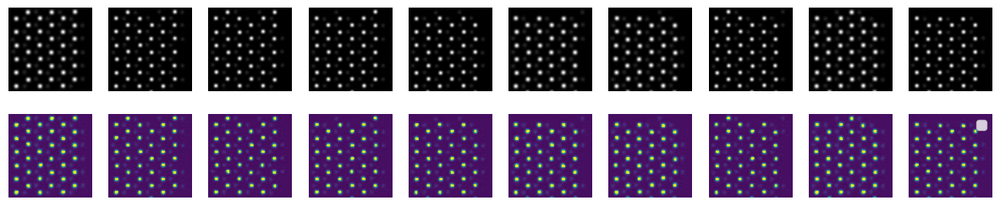

In [63]:
datadim = 64
embedim = 2 
training_cycles = 100
n_tasks = 25
lr = 1e-2
torch.set_default_device("cpu")
augmentation = True
########### NOT USING THE BELOW FOR THIS AS IT IS DEFAULT RUN ################
'''

reptile = 'Reptile'

model_mod = torch.nn.Sequential(
                            torch.nn.Linear(datadim,2048),
                            torch.nn.ReLU(),
                            # torch.nn.Linear(10240,2048),
                            # torch.nn.ReLU(),
                            torch.nn.Linear(2048,1024),
                            torch.nn.ReLU(),
                            torch.nn.Linear(1024, 256),
                            torch.nn.ReLU(),
                            *(list(model_reptile.children())),)

scaler = False
'''

train_tasks, test_tasks = sequential_train_and_test_task(n_tasks,ind_to_val)
title = "Default Feature Extractor without scaling, Sequential tasks \n Reconstruction Graph"

results = single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,training_cycles=training_cycles,datadim=datadim,lr=lr,augmentation=augmentation)
# np.save(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/data_for_plot_generations/Data_defaultFE_noScaling.npy",results)

In [64]:
torch.save(autoencoder,"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/autoencoder.pt")

default_FE
Training Task 1
(338, 1, 208, 208)
(338, 208, 208)
208
torch.Size([338, 1, 208, 208]) torch.Size([1, 338])
Outputs:  torch.Size([338, 1, 208, 208])


Epoch [1/30], Loss: 0.2500
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [2/30], Loss: 0.1821
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [3/30], Loss: 0.1324
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [4/30], Loss: 0.1121
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [5/30], Loss: 0.1012
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [6/30], Loss: 0.0938
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [7/30], Loss: 0.0876
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [8/30], Loss: 0.0818
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [9/30], Loss: 0.0766
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [10/30], Loss: 0.0720
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [11/30], Loss: 0.0681
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [12/30], Loss: 0.0646
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [13/30], Loss: 0.0615
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [14/30], Loss: 0.0588
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [15/30], Loss: 0.0564
Outputs:  torch

/tmp/ipykernel_1985952/111277269.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


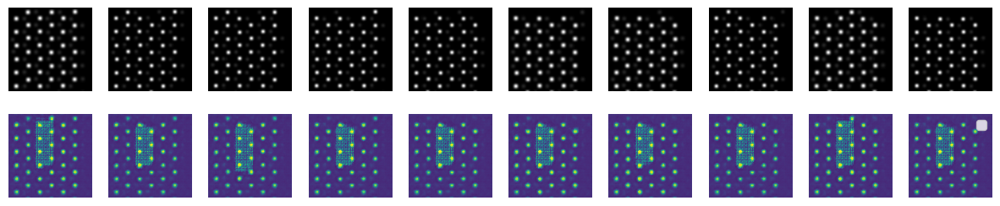

In [88]:
datadim = 64
embedim = 2 
training_cycles = 30
n_tasks = 25
lr = 1e-2
torch.set_default_device("cpu")
augmentation = True
########### NOT USING THE BELOW FOR THIS AS IT IS DEFAULT RUN ################
'''

reptile = 'Reptile'

model_mod = torch.nn.Sequential(
                            torch.nn.Linear(datadim,2048),
                            torch.nn.ReLU(),
                            # torch.nn.Linear(10240,2048),
                            # torch.nn.ReLU(),
                            torch.nn.Linear(2048,1024),
                            torch.nn.ReLU(),
                            torch.nn.Linear(1024, 256),
                            torch.nn.ReLU(),
                            *(list(model_reptile.children())),)

scaler = False
'''

train_tasks, test_tasks = sequential_train_and_test_task(n_tasks,ind_to_val)
title = "Default Feature Extractor without scaling, Sequential tasks \n Reconstruction Graph"

results = single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,training_cycles=training_cycles,datadim=datadim,lr=lr,augmentation=augmentation)
# np.save(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/data_for_plot_generations/Data_defaultFE_noScaling.npy",results)

Autoencoder with Regression

In [116]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader

class AutoencoderWithRegression(nn.Module):
    def __init__(self):
        super(AutoencoderWithRegression, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, stride=2, padding=1),  # 1x28x28 -> 64x14x14
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 64x14x14 -> 128x7x7
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.Conv2d(256, 64, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 16, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(16)
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(16, 64, kernel_size=4, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64, 256, kernel_size=3, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(256),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1),  # 128x8x8 -> 64x16x16
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64, 1, kernel_size=2, stride=2, padding=1),  # 64x16x16 -> 1x32x32
            nn.Sigmoid()  # Use sigmoid for pixel values in [0, 1]
        )
        # Regression layer
        self.regressor = nn.Sequential(
            nn.Linear(784,512),
            nn.ReLU(),
            nn.Linear(512, 128),  # Assuming the encoder output is [batch_size, 256, 4, 4]
            nn.ReLU(),
            nn.Linear(128, 1)  # Regression output
        )
    
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        # Flatten the encoded output for the regression layer
        flattened = encoded.view(encoded.size(0), -1)
        print(flattened.shape)
        regression_output = self.regressor(flattened)
        return decoded, regression_output

# Instantiate the model
autoencoder_with_regression = AutoencoderWithRegression()


In [117]:

def single_model_training_and_validation_mask(train_tasks, ind_to_val, image_mask, energy_to_ind, title, **kwargs):
    datadim = kwargs.get("datadim", 64)
    embedim = 2
    training_cycles = kwargs.get("training_cycles", 10)
    lr = kwargs.get("lr", 1e-2)
    scaler_flag = kwargs.get("scaler", False)
    results = {int(ind_to_val[task]): [] for task in train_tasks}
    feature_extractor = kwargs.get("reptile", "default_FE")
    augmentation = kwargs.get("augmentation", True)
    print(feature_extractor)
    
    
    for task in train_tasks:
        input_image = image_mask[task][0]
        print(f"Training Task {ind_to_val[task]}")
        (X_train, X_test, y_train, y_test, iterations_train, iterations_test) = train_test_split(
            input_image, energy_to_ind[task]["target_total_energy_per_atom"], energy_to_ind[task]['Iteration'], test_size=0.15, shuffle=False, random_state=2)
        
        print(X_train.shape)
        
        X_train = np.squeeze(X_train)
        X_test = np.squeeze(X_test)

        s1, s2, s3 = X_train.shape
        X_train = X_train.reshape(-1, s2, s3)
        X_test = X_test.reshape(-1, s2, s3)

        print(X_train.shape)
        num_channels = X_train.shape[-1]
        print(num_channels)
        # model_sample = LeNet(1, embedim)
        # model_mod = kwargs.get("model_mod", model_sample)

        y_train = np.array(y_train).reshape(1, -1)
        y_test = np.array(y_test).reshape(1, -1)

        if scaler_flag:
            X_train = scaler_fun.fit_transform(X_train)
            X_test = scaler_fun.fit_transform(X_test)
        
        X_train = X_train[:, np.newaxis, :, :]
        X_test = X_test[:, np.newaxis, :, :]
        
        X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
        X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
        y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
        y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

        print(X_train_tensor.shape, y_train_tensor.shape)

        autoencoder_with_regression = AutoencoderWithRegression()
        criterion = nn.MSELoss()
        reg_criterion = nn.MSELoss()
        optimizer = optim.Adam(autoencoder_with_regression.parameters(), lr=1e-2)
        
        for epoch in range(training_cycles):
            
            optimizer.zero_grad()
            outputs, regression_output = autoencoder_with_regression(X_train_tensor)
            print("Outputs: ",outputs.shape)
            recons_loss = criterion(outputs, X_train_tensor)
            print(f'Epoch [{epoch+1}/{training_cycles}], Reconstruction Loss: {recons_loss.item():.4f}')
            reg_loss = reg_criterion(regression_output, y_train_tensor)
            print(f'Epoch [{epoch+1}/{training_cycles}], Regression Loss: {reg_loss.item():.4f}')
            loss = recons_loss + reg_loss
            loss.backward()
            #reg_loss.backward()
            #recons_loss.backward()
            optimizer.step()
            print(f'Epoch [{epoch+1}/{training_cycles}], Combined Loss: {loss.item():.4f}')
        
        #model_mod.eval()
        with torch.no_grad():
            #train_mean = model_mod(X_train_tensor).numpy()
            #mean = model_mod(X_test_tensor).numpy()
            reconstructed, regressed = autoencoder_with_regression(X_test_tensor)
            test_loss = criterion(regressed,y_test_tensor)
        print(f'Test Loss: {test_loss.item():.4f}')

        show_images(X_test_tensor,reconstructed)
        
        clear_gpu_cache()
        #print("Pred: ", mean.shape, y_test.shape)
        
        mod_reconstruction_graph_plot(iterations_train, regression_output.detach().cpu().numpy(), y_train_tensor.detach().cpu().numpy(), iterations_test, regressed.detach().cpu().numpy(), y_test_tensor.detach().cpu().numpy(), ind_to_val, title, task, scaler_flag, feature_extractor, training_cycles, lr, augmentation)
        break
        #results[int(ind_to_val[task])] = [iterations_train, iterations_test, train_mean, mean, y_train, y_test, feature_extractor, scaler_flag, ind_to_val, title, training_cycles, lr]
    #return results

default_FE
Training Task 1
(338, 1, 208, 208)
(338, 208, 208)
208
torch.Size([338, 1, 208, 208]) torch.Size([1, 338])
torch.Size([338, 784])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [1/30], Reconstruction Loss: 0.3044
Epoch [1/30], Regression Loss: 0.0187


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: Using a target size (torch.Size([1, 338])) that is different to the input size (torch.Size([338, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return func(*args, **kwargs)


Epoch [1/30], Combined Loss: 0.3232
torch.Size([338, 784])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [2/30], Reconstruction Loss: 0.2219
Epoch [2/30], Regression Loss: 44.8389
Epoch [2/30], Combined Loss: 45.0608
torch.Size([338, 784])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [3/30], Reconstruction Loss: 0.1723
Epoch [3/30], Regression Loss: 438.4778
Epoch [3/30], Combined Loss: 438.6501
torch.Size([338, 784])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [4/30], Reconstruction Loss: 0.1191
Epoch [4/30], Regression Loss: 0.0010
Epoch [4/30], Combined Loss: 0.1201
torch.Size([338, 784])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [5/30], Reconstruction Loss: 0.1028
Epoch [5/30], Regression Loss: 0.0000
Epoch [5/30], Combined Loss: 0.1028
torch.Size([338, 784])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [6/30], Reconstruction Loss: 0.0930
Epoch [6/30], Regression Loss: 0.0000
Epoch [6/30], Combined Loss: 0.0930
torch.Size([338, 784])
Outputs:  torch.Size([338, 1, 208, 

/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: Using a target size (torch.Size([1, 60])) that is different to the input size (torch.Size([60, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return func(*args, **kwargs)
/tmp/ipykernel_1985952/111277269.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


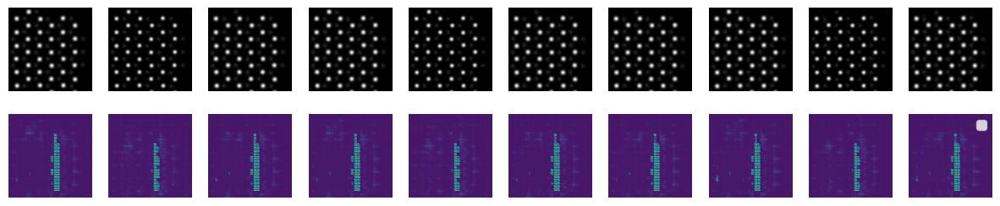

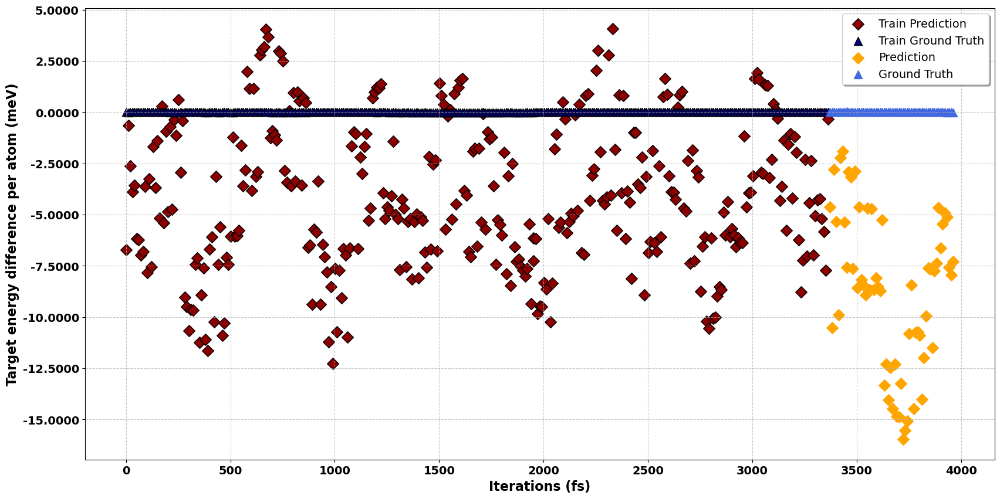

<Figure size 640x480 with 0 Axes>

In [111]:
datadim = 64
embedim = 2 
training_cycles = 50
n_tasks = 25
lr = 1e-2
torch.set_default_device("cpu")
augmentation = True
########### NOT USING THE BELOW FOR THIS AS IT IS DEFAULT RUN ################
'''

reptile = 'Reptile'

model_mod = torch.nn.Sequential(
                            torch.nn.Linear(datadim,2048),
                            torch.nn.ReLU(),
                            # torch.nn.Linear(10240,2048),
                            # torch.nn.ReLU(),
                            torch.nn.Linear(2048,1024),
                            torch.nn.ReLU(),
                            torch.nn.Linear(1024, 256),
                            torch.nn.ReLU(),
                            *(list(model_reptile.children())),)

scaler = False
'''

train_tasks, test_tasks = sequential_train_and_test_task(n_tasks,ind_to_val)
title = "Default Feature Extractor without scaling, Sequential tasks \n Reconstruction Graph"

results = single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,training_cycles=training_cycles,datadim=datadim,lr=lr,augmentation=augmentation)
# np.save(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/data_for_plot_generations/Data_defaultFE_noScaling.npy",results)

In [112]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader

# Add the CMF part
# CNN with nearest neighbours - Ayana's NB

class AutoencoderRegressor(nn.Module):
    def __init__(self):
        super(AutoencoderRegressor, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, stride=2, padding=1),  # 1x28x28 -> 64x14x14
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 64x14x14 -> 128x7x7
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(256),
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # 128x8x8 -> 64x16x16
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1),  # 64x16x16 -> 1x32x32
            nn.Sigmoid()  # Use sigmoid for pixel values in [0, 1]
        )
        self.regressor = nn.Sequential(
            nn.Linear(173056,10240),
            # nn.ReLU(),
            # nn.Linear(102400,51200),
            # nn.ReLU(),
            # nn.Linear(51200,10240),
            nn.ReLU(),
            nn.Linear(10240,4098),
            nn.ReLU(),
            nn.Linear(4098,784),
            nn.ReLU(),
            nn.Linear(784,512),
            nn.ReLU(),
            nn.Linear(512, 128),  # Assuming the encoder output is [batch_size, 256, 4, 4]
            nn.ReLU(),
            nn.Linear(128, 1)  # Regression output
        )
   
    
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        # Flatten the encoded output for the regression layer
        flattened = encoded.view(encoded.size(0), -1)
        print(flattened.shape)
        regression_output = self.regressor(flattened)
        return decoded, regression_output
# Instantiate the model
enc_reg = AutoencoderRegressor()

In [113]:

def single_model_training_and_validation_mask(train_tasks, ind_to_val, image_mask, energy_to_ind, title, **kwargs):
    datadim = kwargs.get("datadim", 64)
    embedim = 2
    training_cycles = kwargs.get("training_cycles", 10)
    lr = kwargs.get("lr", 1e-2)
    scaler_flag = kwargs.get("scaler", False)
    results = {int(ind_to_val[task]): [] for task in train_tasks}
    feature_extractor = kwargs.get("reptile", "default_FE")
    augmentation = kwargs.get("augmentation", True)
    print(feature_extractor)
    
    
    for task in train_tasks:
        input_image = image_mask[task][0]
        print(f"Training Task {ind_to_val[task]}")
        (X_train, X_test, y_train, y_test, iterations_train, iterations_test) = train_test_split(
            input_image, energy_to_ind[task]["target_total_energy_per_atom"], energy_to_ind[task]['Iteration'], test_size=0.15, shuffle=False, random_state=2)
        
        print(X_train.shape)
        
        X_train = np.squeeze(X_train)
        X_test = np.squeeze(X_test)

        s1, s2, s3 = X_train.shape
        X_train = X_train.reshape(-1, s2, s3)
        X_test = X_test.reshape(-1, s2, s3)

        print(X_train.shape)
        num_channels = X_train.shape[-1]
        print(num_channels)
        # model_sample = LeNet(1, embedim)
        # model_mod = kwargs.get("model_mod", model_sample)

        y_train = np.array(y_train).reshape(1, -1)
        y_test = np.array(y_test).reshape(1, -1)

        if scaler_flag:
            X_train = scaler_fun.fit_transform(X_train)
            X_test = scaler_fun.fit_transform(X_test)
        
        X_train = X_train[:, np.newaxis, :, :]
        X_test = X_test[:, np.newaxis, :, :]
        
        X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
        X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
        y_train_tensor = torch.tensor(y_train, dtype=torch.float32)
        y_test_tensor = torch.tensor(y_test, dtype=torch.float32)

        print(X_train_tensor.shape, y_train_tensor.shape)

        autoencoder_regression = AutoencoderRegressor()
        criterion = nn.MSELoss()
        reg_criterion = nn.MSELoss()
        optimizer = optim.Adam(autoencoder_regression.parameters(), lr=1e-2)
        
        for epoch in range(training_cycles):
            
            optimizer.zero_grad()
            outputs, regression_output = autoencoder_regression(X_train_tensor)
            print("Outputs: ",outputs.shape)
            recons_loss = criterion(outputs, X_train_tensor)
            print(f'Epoch [{epoch+1}/{training_cycles}], Reconstruction Loss: {recons_loss.item():.4f}')
            reg_loss = reg_criterion(regression_output, y_train_tensor)
            print(f'Epoch [{epoch+1}/{training_cycles}], Regression Loss: {reg_loss.item():.4f}')
            loss = recons_loss + reg_loss
            loss.backward()
            #reg_loss.backward()
            #recons_loss.backward()
            optimizer.step()
            print(f'Epoch [{epoch+1}/{training_cycles}], Combined Loss: {loss.item():.4f}')
        
        #model_mod.eval()
        with torch.no_grad():
            #train_mean = model_mod(X_train_tensor).numpy()
            #mean = model_mod(X_test_tensor).numpy()
            reconstructed, regressed = autoencoder_regression(X_test_tensor)
            test_loss = criterion(regressed,y_test_tensor)
        print(f'Test Loss: {test_loss.item():.4f}')

        show_images(X_test_tensor,reconstructed)
        
        clear_gpu_cache()
        #print("Pred: ", mean.shape, y_test.shape)
        
        mod_reconstruction_graph_plot(iterations_train, regression_output.detach().cpu().numpy(), y_train_tensor.detach().cpu().numpy(), iterations_test, regressed.detach().cpu().numpy(), y_test_tensor.detach().cpu().numpy(), ind_to_val, title, task, scaler_flag, feature_extractor, training_cycles, lr, augmentation)
        break
        #results[int(ind_to_val[task])] = [iterations_train, iterations_test, train_mean, mean, y_train, y_test, feature_extractor, scaler_flag, ind_to_val, title, training_cycles, lr]
    #return results


default_FE
Training Task 1
(338, 1, 208, 208)
(338, 208, 208)
208
torch.Size([338, 1, 208, 208]) torch.Size([1, 338])
torch.Size([338, 173056])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [1/30], Reconstruction Loss: 0.3368
Epoch [1/30], Regression Loss: 0.0014
Epoch [1/30], Combined Loss: 0.3382
torch.Size([338, 173056])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [2/30], Reconstruction Loss: 0.2451
Epoch [2/30], Regression Loss: 5579850383360.0000
Epoch [2/30], Combined Loss: 5579850383360.0000
torch.Size([338, 173056])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [3/30], Reconstruction Loss: 0.2981
Epoch [3/30], Regression Loss: 107251064.0000
Epoch [3/30], Combined Loss: 107251064.0000
torch.Size([338, 173056])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [4/30], Reconstruction Loss: 0.2302
Epoch [4/30], Regression Loss: 2905963.5000
Epoch [4/30], Combined Loss: 2905963.7500
torch.Size([338, 173056])
Outputs:  torch.Size([338, 1, 208, 208])
Epoch [5/30], Reconstruction Lo

/tmp/ipykernel_1985952/111277269.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


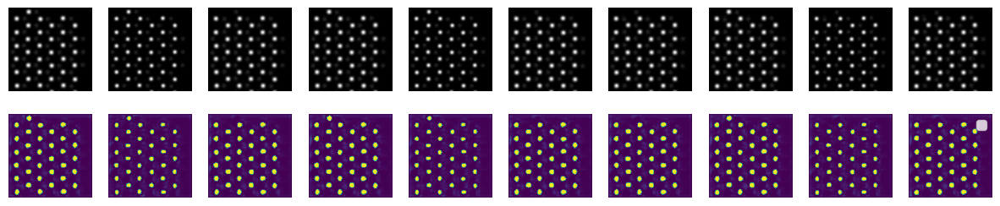

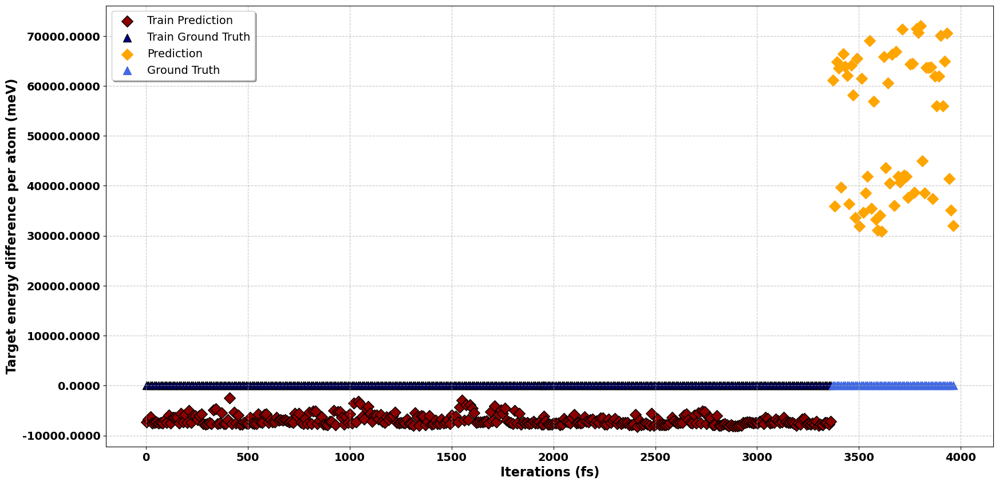

<Figure size 640x480 with 0 Axes>

In [115]:
datadim = 64
embedim = 2 
training_cycles = 30
n_tasks = 25
lr = 1e-2
torch.set_default_device("cpu")
augmentation = True
########### NOT USING THE BELOW FOR THIS AS IT IS DEFAULT RUN ################
'''

reptile = 'Reptile'

model_mod = torch.nn.Sequential(
                            torch.nn.Linear(datadim,2048),
                            torch.nn.ReLU(),
                            # torch.nn.Linear(10240,2048),
                            # torch.nn.ReLU(),
                            torch.nn.Linear(2048,1024),
                            torch.nn.ReLU(),
                            torch.nn.Linear(1024, 256),
                            torch.nn.ReLU(),
                            *(list(model_reptile.children())),)

scaler = False
'''

train_tasks, test_tasks = sequential_train_and_test_task(n_tasks,ind_to_val)
title = "Default Feature Extractor without scaling, Sequential tasks \n Reconstruction Graph"

results = single_model_training_and_validation_mask(train_tasks,ind_to_val,image_mask,energy_to_ind,title,training_cycles=training_cycles,datadim=datadim,lr=lr,augmentation=augmentation)
# np.save(f"/lustre/saranath/Techcon24/AIMD/Sim2Experiment/results/data_for_plot_generations/Data_defaultFE_noScaling.npy",results)

MNIST

Epoch [1/10], Loss: 0.8349
Epoch [2/10], Loss: 0.8393
Epoch [3/10], Loss: 0.8407
Epoch [4/10], Loss: 0.8373
Epoch [5/10], Loss: 0.8304
Epoch [6/10], Loss: 0.8297
Epoch [7/10], Loss: 0.8321
Epoch [8/10], Loss: 0.8343
Epoch [9/10], Loss: 0.8310
Epoch [10/10], Loss: 0.8408


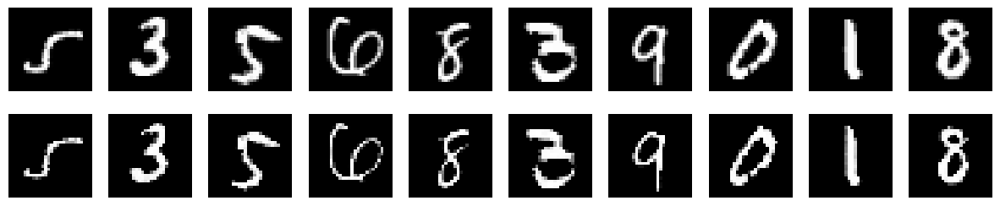

In [137]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader

import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader

class ImprovedAutoencoder(nn.Module):
    def __init__(self):
        super(ImprovedAutoencoder, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 64, kernel_size=3, stride=2, padding=1),  # 1x28x28 -> 64x14x14
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 64x14x14 -> 128x7x7
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # 128x7x7 -> 256x4x4
            nn.ReLU(),
            nn.BatchNorm2d(256),
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 256x4x4 -> 128x8x8
            nn.ReLU(),
            nn.BatchNorm2d(128),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1),  # 128x8x8 -> 64x16x16
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.ConvTranspose2d(64, 1, kernel_size=2, stride=2, padding=1),  # 64x16x16 -> 1x32x32
            nn.Sigmoid()  # Use sigmoid for pixel values in [0, 1]
        )
    
    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

# Instantiate the model
autoencoder = ImprovedAutoencoder()


# Define loss function and optimizer
criterion = nn.MSELoss()
optimizer = optim.Adam(autoencoder.parameters(), lr=1e-3)

# Load data (MNIST as an example)
transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])
train_dataset = MNIST(root='./data', train=True, transform=transform, download=True)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    for data in train_loader:
        inputs, _ = data
        optimizer.zero_grad()
        outputs = autoencoder(inputs)
        loss = criterion(outputs, inputs)
        loss.backward()
        optimizer.step()
    
    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')
import matplotlib.pyplot as plt

# Test with one batch of images
test_batch = next(iter(train_loader))[0]
with torch.no_grad():
    reconstructed = autoencoder(test_batch)

# Display original and reconstructed images
def show_images(original, reconstructed):
    fig, axes = plt.subplots(2, 10, figsize=(15, 3))
    for i in range(10):
        axes[0, i].imshow(original[i].squeeze(), cmap='gray')
        axes[0, i].axis('off')
        axes[1, i].imshow(reconstructed[i].squeeze(), cmap='gray')
        axes[1, i].axis('off')
    plt.show()

show_images(test_batch, reconstructed)


Experimental Data Training

In [30]:
import atomai as aoi
#@title import

from typing import Tuple, Optional, Dict, Union, List
import numpy as np
import matplotlib.pyplot as plt

import torch
import math
import scipy.spatial as spatial
import json
from skimage.transform import resize

from scipy.spatial import cKDTree
from scipy.signal import convolve2d as conv2

from copy import deepcopy as dc
import matplotlib.gridspec as gridspec

import glob
from skimage import color

import time
import random

from PIL import Image
import imutils
# from shapely.geometry import Polygon, MultiPolygon, mapping, shape
from scipy import ndimage
from skimage.draw import polygon
from skimage import color
from skimage import draw

import cv2
from skimage.filters import threshold_minimum, roberts, prewitt, threshold_otsu, unsharp_mask
from skimage.measure import label, regionprops
from skimage.morphology import opening, square, closing

from PIL import Image

import imutils
from shapely.geometry import Polygon, MultiPolygon, mapping, shape

from scipy import ndimage

import atomai as aoi
import matplotlib.patches as patches

# Functions
#@title Functions

def normalize(image, scale = [0,1]):

    scale_range = scale[1] - scale[0]
    return scale_range*(image-np.min(image))/np.ptp(image) + scale[0]

def ApplyHamming(imgsrc, winsize):
    #Applies a Hamming window to the input imgsec, returns the window after filter applied.
    bw2d = np.outer(np.hamming(winsize), np.ones(winsize))
    bw2d = np.sqrt(bw2d * bw2d.T)
    imgsrc *= bw2d
    return imgsrc

def take_FFT(img, zoom, power = 1, blur = 0, center_remove = 1, blur_subtract = 1, final_power = 2, hamming=True):
  fftimg = np.log(
    np.abs(
        np.fft.fftshift(
            np.fft.fft2(img**power)
            )
        )
    )
  c1,c2 = int(fftimg.shape[0]/2), int(fftimg.shape[1]/2)
  if center_remove > 0:
    fftimg[int(c1-center_remove):int(c1+center_remove),
           int(c2-center_remove):int(c2+center_remove)] = 0
  Z = int(fftimg.shape[0]/zoom/2)
  fftimg = fftimg[int(c1-Z):int(c1+Z),
                  int(c2-Z):int(c2+Z)]
  if blur_subtract > 0:
    fftblur = ndimage.gaussian_filter(fftimg, sigma = blur_subtract)
    fftimg = fftimg - fftblur
  if hamming:
    fftimg = ApplyHamming(fftimg,fftimg.shape[0])
  fftimg = ndimage.gaussian_filter(fftimg, blur)
  fftimg = normalize(fftimg**final_power)

  return fftimg

# def normalize(img):
#     return (img - np.min(img))/np.ptp(img)
def get_imgstack(imgdata: np.ndarray,
                 coord: np.ndarray,
                 r: int) -> Tuple[np.ndarray]:
    """
    Extracts subimages centered at specified coordinates
    for a single image
    Args:
        imgdata (3D numpy array):
            Prediction of a neural network with dimensions
            :math:`height \\times width \\times n channels`
        coord (N x 2 numpy array):
            (x, y) coordinates
        r (int):
            Window size
    Returns:
        2-element tuple containing
        - Stack of subimages
        - (x, y) coordinates of their centers
    """
    img_cr_all = []
    com = []
    for c in coord:
        cx = int(np.around(c[0]))
        cy = int(np.around(c[1]))
        if r % 2 != 0:
            img_cr = np.copy(
                imgdata[cx-r//2:cx+r//2+1,
                        cy-r//2:cy+r//2+1])
        else:
            img_cr = np.copy(
                imgdata[cx-r//2:cx+r//2,
                        cy-r//2:cy+r//2])
        if img_cr.shape[0:2] == (int(r), int(r)) and not np.isnan(img_cr).any():
            img_cr_all.append(img_cr[None, ...])
            com.append(c[None, ...])
    if len(img_cr_all) == 0:
        return None, None
    img_cr_all = np.concatenate(img_cr_all, axis=0)
    com = np.concatenate(com, axis=0)
    return img_cr_all, com

def extract_subimages(imgdata: np.ndarray,
                      coordinates: Union[Dict[int, np.ndarray], np.ndarray],
                      window_size: int, coord_class: int = 0) -> Tuple[np.ndarray]:

    if isinstance(coordinates, np.ndarray):
        coordinates = np.concatenate((
            coordinates, np.zeros((coordinates.shape[0], 1))), axis=-1)
        coordinates = {0: coordinates}
    if np.ndim(imgdata) == 2:
        imgdata = imgdata[None, ..., None]
    subimages_all, com_all, frames_all = [], [], []
    for i, (img, coord) in enumerate(
            zip(imgdata, coordinates.values())):
        coord_i = coord[np.where(coord[:, 2] == coord_class)][:, :2]
        stack_i, com_i = get_imgstack(img, coord_i, window_size)
        if stack_i is None:
            continue
        subimages_all.append(stack_i)
        com_all.append(com_i)
        frames_all.append(np.ones(len(com_i), int) * i)
    if len(subimages_all) > 0:
        subimages_all = np.concatenate(subimages_all, axis=0)
        com_all = np.concatenate(com_all, axis=0)
        frames_all = np.concatenate(frames_all, axis=0)

    return subimages_all, com_all, frames_all

def extract_patches_and_spectra(hdata: np.ndarray, *args: np.ndarray,
                                coordinates: np.ndarray = None,
                                window_size: int = None,
                                avg_pool: int = 2,
                                **kwargs: Union[int, List[int]]
                                ) -> Tuple[np.ndarray]:
    """
    Extracts image patches and associated spectra
    (corresponding to patch centers) from hyperspectral dataset
    Args:
        hdata:
            3D or 4D hyperspectral data
        *args:
            2D image for patch extraction. If not provided, then
            patches will be extracted from hyperspectral data
            averaged over a specified band (range of "slices")
        coordinates:
            2D numpy array with xy coordinates
        window_size:
            Image patch size
        avg_pool:
            Kernel size and stride for average pooling in spectral dimension(s)
        **band:
            Range of slices in hyperspectral data to average over
            for producing a 2D image if the latter is not provided as a separate
            argument. For 3D data, it can be integer (use a single slice)
            or a 2-element list. For 4D data, it can be integer or a 4-element list.
        Returns:
            3-element tuple with image patches, associated spectra and coordinates
    """
    F = torch.nn.functional
    if hdata.ndim not in (3, 4):
        raise ValueError("Hyperspectral data must 3D or 4D")
    if len(args) > 0:
        img = args[0]
        if img.ndim != 2:
            raise ValueError("Image data must be 2D")
    else:
        band = kwargs.get("band", 0)
        if hdata.ndim == 3:
            if isinstance(band, int):
                band = [band, band+1]
            img = hdata[..., band[0]:band[1]].mean(-1)
        else:
            if isinstance(band, int):
                band = [band, band+1, band, band+1]
            elif isinstance(band, list) and len(band) == 2:
                band = [*band, *band]
            img = hdata[..., band[0]:band[1], band[2]:band[3]].mean((-2, -1))
    patches, coords, _ = extract_subimages(img, coordinates, window_size)
    patches = patches.squeeze()
    spectra = []
    for c in coords:
        spectra.append(hdata[int(c[0]), int(c[1])])
    avg_pool = 2*[avg_pool] if (isinstance(avg_pool, int) & hdata.ndim == 4) else avg_pool
    torch_pool = F.avg_pool1d if hdata.ndim == 3 else F.avg_pool2d
    spectra = torch.tensor(spectra).cpu().unsqueeze(1)
    spectra = torch_pool(spectra, avg_pool, avg_pool).squeeze().numpy()
    return patches, spectra, coords

def plot_scalebar(axis, image, pixelsize_m, length_nm, dist_from_corner, **kwargs):

    ratio    = kwargs.get("ratio", 6)
    scalebar_style = kwargs.get("scalebar_style", "fixed") # fixed or percent
    sblength = length_nm/pixelsize_m
    sbheight = sblength/ratio
    d1,d2 = image.shape
    dist_from_corner = (dist_from_corner*d1)/100

    if scalebar_style == 'percent':
        sblength = (length_nm * d1)
        sbheight = sblength/ratio
        actual_length = sblength*pixelsize_m
    else:
        actual_length = length_nm
    o1,o2 = d2 - dist_from_corner - sblength, d1-dist_from_corner-sbheight
    axis.add_patch(patches.Rectangle((o1,o2),sblength, sbheight, color = 'w', ec='k'))
    # print(f"scalebar length: {actual_length} nm")

    return actual_length

def normalize(image, scale = [0,1]):

    scale_range = scale[1] - scale[0]
    return scale_range*(image-np.min(image))/np.ptp(image) + scale[0]

def normalize_individually(stack, scale = [0,1]):
    # scale = 1 or 255 for now
	# scale_range = scale[1] - scale[0]
    normalized_stack = np.copy(stack)
    for ii in range(len(stack)):
        normalized_stack[ii] = normalize(stack[ii], scale)
    return normalized_stack

def virtual_annular(r1,r2,data4Din,**kwargs):

  offset = kwargs.get("offset", [0,0])

  d1,d2,d3,d4 = data4Din.shape
  virtualimg = np.zeros((d1,d2))

  mask = np.zeros_like(data4Din[0,0])
  c1,c2 = int(data4Din[0,0].shape[0]/2), int(data4Din[0,0].shape[1]/2)
  c1 += offset[0]
  c2 += offset[1]
  rr1,cc1 = draw.disk((c1,c2),r1,shape = data4Din[0,0].shape)
  rr2,cc2 = draw.disk((c1,c2),r2,shape = data4Din[0,0].shape)
  mask[rr2,cc2] = 1
  mask[rr1,cc1] = 0

  for ii in range(virtualimg.shape[0]):
    for jj in range(virtualimg.shape[1]):
      virtualimg[ii,jj] = np.sum(mask*data4Din[ii,jj])

  return virtualimg, mask

#

def get_neighbormean(imgarr,coordinate):
  a1,a2,_ = coordinate
  all_c = np.zeros((3**2,2)).astype(int)
  all_c[0,:] = a1-1,a2+1
  all_c[1,:] = a1,  a2+1
  all_c[2,:] = a1+1,a2+1
  all_c[3,:] = a1-1,a2
  all_c[4,:] = a1,a2
  all_c[5,:] = a1+1,a2
  all_c[6,:] = a1-1,a2-1
  all_c[7,:] = a1,a2-1
  all_c[8,:] = a1+1,a2-1

  imgarr = normalize(imgarr)
  ints = []
  for cc in all_c:
    ints.append(imgarr[cc[0],cc[1]])
  ints = np.asarray(ints)

  return np.mean(ints)

def load_globals(filename):
    meta = json.load(open(filename, "r"))['spatial_calibrations'][0]['units']
    meta = meta.replace("\n", "")
    meta = meta.replace("'", '"')
    meta = meta.replace('array(', '')
    meta = meta.replace("]])", "]]")
    globals = meta.split("All coordinates")[0]
    globals = globals.replace("},", "}}")
    globals = globals.replace('}} "', '}}')
    GLOBALS = json.loads(globals)['All parameters']
    return GLOBALS

def load_coords(filename):
    meta = json.load(open(filename, "r"))['spatial_calibrations'][0]['units']
    meta = meta.replace("\n", "")
    meta = meta.replace("'", '"')
    meta = meta.replace('array(', '')
    meta = meta.replace("]])", "]]")
    coords = meta.split("All coordinates")[1][3:]
    coords = coords.replace('{0', '{"0"')
    coords = coords.replace('...,', '')
    coords = coords.replace('.        ', '')
    coords = coords.replace('}, "Blast', ', "Blast')
    COORDS = json.loads(coords)
    return COORDS

def LoadMovie(filename):
    mov    = np.load(filename)
    movj = json.load(open(filename[:-3]+'json','r'))
    mov_scale = movj['spatial_calibrations'][1]['scale']
    return mov, mov_scale

def ready_images(images, FOV, resizefactor, powerfactor):
  newsize = int(FOV*10/resizefactor)

  if images.ndim == 2:
    newimages = np.zeros((newsize, newsize))
    imgdata = aoi.utils.cv_resize(images, (newsize, newsize))
    newimages = normalize((imgdata - imgdata.min())**powerfactor)

  elif images.ndim == 3:
    newimages = np.zeros((len(images), newsize, newsize))
    for ii,image in enumerate(images):
      imgdata = aoi.utils.cv_resize(image, (newsize, newsize))
      newimages[ii] = normalize((imgdata - imgdata.min())**powerfactor)

  return newimages



from IPython.core.display import Video
import imageio

# To stop warning logs during movie creation
import imageio.core.util
def silence_imageio_warning(*args, **kwargs):
    pass

imageio.core.util._precision_warn = silence_imageio_warning


#@title Functions (moar)



def make_THIRDS(maskfile):
	# if maskfile == "Mask_none.npy":

  mask = np.load(maskfile)
  cx,cy = ndimage.center_of_mass(mask)
  print([cx,cy])
  Mask_thirds = np.zeros((3, mask.shape[0], mask.shape[1]), dtype=np.double)

  # Mask_thirds[0] = np.zeros((mask_.shape[0], mask_.shape[1]), dtype=np.double)

  ##################################################

  x1,y1 = 0,0
  x2,y2 = cx,0
  x3,y3 = cx,cy
  x4,y4 = 0, Mask_thirds[0].shape[0]

  # fill polygon
  poly = np.array((
                  (x1,y1),
                  (x2,y2),
                  (x3,y3),
                  (x4,y4))
  )

  rr0, cc0 = polygon(poly[:, 1], poly[:, 0], Mask_thirds[0].shape)
  Mask_thirds[0][rr0, cc0] = 1

  ##################################################

  x1,y1 = cx,0
  x2,y2 = Mask_thirds[0].shape[0], 0
  x3,y3 = Mask_thirds[0].shape[0], Mask_thirds[0].shape[0]
  x4,y4 = cx, cy

  # fill polygon
  poly = np.array((
                  (x1,y1),
                  (x2,y2),
                  (x3,y3),
                  (x4,y4))
  )

  ##################################################

  rr1, cc1 = polygon(poly[:, 1], poly[:, 0], Mask_thirds[1].shape)
  Mask_thirds[1][rr1, cc1] = 1


  x1,y1 = cx,cy
  x2,y2 = Mask_thirds[1].shape[0], Mask_thirds[1].shape[0]
  x3,y3 = 0, Mask_thirds[1].shape[0]

  # fill polygon
  poly = np.array((
                  (x1,y1),
                  (x2,y2),
                  (x3,y3))
  )

  ###################################################

  rr2, cc2 = polygon(poly[:, 1], poly[:, 0], Mask_thirds[2].shape)
  Mask_thirds[2][rr2, cc2] = 1


  return Mask_thirds

def MoS2_coord_split(imagedata, coordinates, winsizefraction = 0.07, separation_threshold = 0.225, moly_thresh = 22):
# def MoS2_coord_split(imagedata, coordinates, winsizefraction = 0.07, sulfur_threshold = 0.225):
	'''
	Idea is to first separate everything by local GMM clustering. This seems to work well for MoS2,
	as the Mo atoms are generally cleaner (rounder) and larger in size.
	Then, with the remaining sulfurs, we then split these by intensity thresholding

	Doing this with 2 thresholds (one for Mo / all sulfurs, and one again for S1 and S2) did not
	work well. Perhaps some of the double sulfurs' intensity can match that of Mo. I'm not
	sure how or why, that doesn't seem to make sense. May need finer tuning with thresholding

	In any case, this route seemed to work quite well.

	Note, trying to extract slight intensity variations with a convolutional neural net is
	probably not the best approach. These are better at identifying geometric features,
	not intensities. i.e., we don't have a trained network with 3 (really, 4) classes
	out of the gate. Instead just a single class of ALL atoms, and refine from there.
	Therefore we have gone with this approach here.
	'''
	num_comps = 3
	windowsize = 1+(int(winsizefraction*imagedata.shape[1]/FOV))

	print("window size is: {} px".format(windowsize))

	######## SWITCH TO GPU VERSION of the GMM_LOCAL and THRESHOLDING ! ##########


	try:
		# time1 = time.time()
		separation_01 = aoi.stat.update_classes(coordinates,
		                                        imagedata,
		                                        method="gmm_local",
		                                        n_components = num_comps,
		                                        window_size = windowsize,
		                                        )

		classes = {}
		for ii in range(num_comps):
			classes[ii] =  np.argwhere(separation_01[0][:,2]==ii).squeeze()
		try:
			C1mean = np.mean(aoi.utils.get_intensities_(separation_01[0][classes[0]], imagedata, r=5))
			C2mean = np.mean(aoi.utils.get_intensities_(separation_01[0][classes[1]], imagedata, r=5))
			C3mean = np.mean(aoi.utils.get_intensities_(separation_01[0][classes[2]], imagedata, r=5))
		except IndexError:
			C1_ints, C2_ints, C3_ints = [], [], []
			for coord in separation_01[0]:
			    if coord[2] == 0:
			      C1_ints.append(get_neighbormean(imagedata, coord))
			    elif coord[2] == 1:
			      C2_ints.append(get_neighbormean(imagedata, coord))
			    elif coord[2] == 2:
			      C3_ints.append(get_neighbormean(imagedata, coord))
			C1mean, C2mean, C3mean = np.mean(C1_ints), np.mean(C2_ints), np.mean(C3_ints)


		thresh = separation_threshold

# Little long and probably a little clunky, but runs pretty fast # M.B.

		if C1mean > C2mean and C1mean > C3mean:
		  if abs(C2mean-C3mean) > thresh and abs(C2mean-C1mean) > thresh and abs(C1mean-C3mean) > thresh:
		    NW =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    if C2mean > C3mean:
		      Mo  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      S =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    else:
		      S  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      Mo =  separation_01[0][np.where(separation_01[0][:,2] == 2)]

		  elif abs(C2mean-C3mean) > thresh and abs(C2mean-C1mean) <= thresh:
		    S = separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    Mo = np.concatenate((Mo2, Mo1), axis=0)
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

		  elif abs(C2mean-C3mean) > thresh and abs(C3mean-C1mean) <= thresh:
		    S = separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    Mo = np.concatenate((Mo2, Mo1), axis=0)
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]


		  elif abs(C2mean-C3mean) <= thresh:
		    Mo =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]
		    if C2mean > C3mean:
		      S2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		      S1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      S = np.concatenate((S2, S1), axis=0)
		    else:
		      S2  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      S1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		      S = np.concatenate((S2, S1), axis=0)


		elif C2mean > C1mean and C2mean > C3mean:
		  if abs(C1mean-C3mean) > thresh and abs(C2mean-C1mean) > thresh and abs(C2mean-C3mean) > thresh:
		    NW =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    if C1mean > C3mean:
		      Mo  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		      S =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    else:
		      S  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		      Mo =  separation_01[0][np.where(separation_01[0][:,2] == 2)]

		  elif abs(C1mean-C3mean) > thresh and abs(C2mean-C1mean) <= thresh:
		    S = separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    Mo = np.concatenate((Mo2, Mo1), axis=0)
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

		  elif abs(C1mean-C3mean) > thresh and abs(C2mean-C3mean) <= thresh:
		    S = separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    Mo = np.concatenate((Mo2, Mo1), axis=0)
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

		  elif abs(C1mean-C3mean) <= thresh:
		    Mo =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]
		    if C1mean > C3mean:
		      S2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		      S1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		      S = np.concatenate((S2, S1), axis=0)
		    else:
		      S2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		      S1  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		      S = np.concatenate((S2, S1), axis=0)


		elif C3mean > C1mean and C3mean > C2mean:
		  if abs(C1mean-C2mean) > thresh and abs(C3mean-C1mean) > thresh and abs(C2mean-C3mean) > thresh:
		    NW =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    if C2mean > C1mean:
		      Mo  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      S =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    else:
		      S  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      Mo =  separation_01[0][np.where(separation_01[0][:,2] == 0)]

		  elif abs(C1mean-C2mean) > thresh and abs(C1mean-C3mean) <= thresh:
		    S = separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    Mo = np.concatenate((Mo2, Mo1), axis=0)
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

		  elif abs(C1mean-C2mean) > thresh and abs(C2mean-C3mean) <= thresh:
		    S = separation_01[0][np.where(separation_01[0][:,2] == 0)]
		    Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		    Mo = np.concatenate((Mo2, Mo1), axis=0)
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

		  elif abs(C1mean-C2mean) <= thresh:
		    Mo =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
		    NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]
		    if C1mean > C2mean:
		      S2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		      S1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      S = np.concatenate((S2, S1), axis=0)
		    else:
		      S2  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		      S1  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		      S = np.concatenate((S2, S1), axis=0)

		Mo_dist_sep = dc(Mo)
		Mo_dist_sep = np.array(Mo_dist_sep)

		Mo_dist = []
		Mo_ml = []
		Mo_svl = []

		for i1, c in enumerate(Mo_dist_sep[:,:2]):
		  d, i2 = spatial.cKDTree(Mo_dist_sep[:,:2]).query(c, k=3)
		  Mo_dist.append(d[-1])
		  if d[-1] > moly_thresh:
		    Mo_ml.append(c)
		  elif d[-1] <= moly_thresh:
		    Mo_svl.append(c)

		Mo_dist = np.array(Mo_dist)
		Mo_ml = np.array(Mo_ml)
		Mo_svl = np.array(Mo_svl)
		# if C1mean > C2mean:
		#   Mo =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		#   S  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
		# else:
		#   S  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
		#   Mo =  separation_01[0][np.where(separation_01[0][:,2] == 1)]

		# print(len(Mo))
		# time2 = time.time()
		# time_elapse = time2 - time1
		# print("First separation done in {0:.3f} seconds".format(time_elapse))
		S[:,2] = 0
		separation_02 = aoi.stat.update_classes(S,
		                                        imagedata,
		                                        method="threshold",
		                                        thresh=0.1,
		                                        window_size = 5
		                                        )

		classes = {}
		for ii in range(num_comps):
		  classes[ii] =  np.argwhere(separation_02[0][:,2]==ii).squeeze()
		try:
			C1mean = np.mean(aoi.utils.get_intensities_(separation_02[0][classes[0]], imagedata, r=5))
			C2mean = np.mean(aoi.utils.get_intensities_(separation_02[0][classes[1]], imagedata, r=5))
		except IndexError:
			C1_ints, C2_ints = [], []
			for coord in separation_02[0]:
			    if coord[2] == 0:
			      C1_ints.append(get_neighbormean(imagedata, coord))
			    elif coord[2] == 1:
			      C2_ints.append(get_neighbormean(imagedata, coord))
			C1mean, C2mean = np.mean(C1_ints), np.mean(C2_ints)


		if C1mean > C2mean:
		  S2 =  separation_02[0][np.where(separation_02[0][:,2] == 0)]
		  S1  = separation_02[0][np.where(separation_02[0][:,2] == 1)]
		else:
		  S1  = separation_02[0][np.where(separation_02[0][:,2] == 0)]
		  S2 =  separation_02[0][np.where(separation_02[0][:,2] == 1)]




	except AttributeError:
		print('----WARNING: Classfication failed----')
		Mo = coordinates[0]
		S1,S2,NW = np.zeros((1,3)), np.zeros((1,3)),np.zeros((1,3))


	return Mo_ml, Mo_svl, S1, S2, NW

def get_rect_aspectratio(points):
    p1,p2,p3,p4 = points

    d12 = np.linalg.norm(p1 - p2)
    d13 = np.linalg.norm(p1 - p3)
    d14 = np.linalg.norm(p1 - p4)
    ds = [d12, d13, d14]

    # diagonal will be largest length, so remove it
    diag = np.asarray(ds).argmax()
    ds.pop(diag)
    DS = np.asarray(ds)
    AR = DS.max()/DS.min()

    return AR

def detect_nanowires(image, mask_thirds, pixeldims=None, minareafract=0.05, maxareafract=0.95, opening_kernel = 2, iterations = 2, min_aspect_ratio = 5, blur = None, **kwargs):
    plot = kwargs.get('plot', False)
    save = kwargs.get('save', False)
    ## Hardcoded for now ##
    # Actually these don't do anything!
    # min_thresh = 0.00001
    # max_thresh = 0.9
    #######################

    if pixeldims == None:
		    pixeldims = image.shape

    pix_x, pix_y = pixeldims[0], pixeldims[1]
    shape1, shape2 = image.shape[0], image.shape[1]
    diff = int(np.abs(shape1-shape2)/2)

    if (shape1 - shape2) < 0:
        xtra = np.zeros((diff,shape2))
        newimage = np.concatenate((xtra,np.concatenate((image,xtra),axis=0)), axis=0)
    else:
        xtra = np.zeros((shape1, diff))
        newimage = np.concatenate((xtra,np.concatenate((image,xtra),axis=1)), axis=1)

    # Resize to this scan field and threshold (make binary image)
    resized_image_ = resize(newimage, (pix_x, pix_y))

    if blur == None:
        resized_image = resized_image_
    else:
        resized_image = ndimage.gaussian_filter(resized_image_, sigma = blur)


    dd1,dd2 = resized_image.shape[0], resized_image.shape[1]

    mask_01 = aoi.utils.cv_resize(mask_thirds[0], (dd1,dd2))
    mask_02 = aoi.utils.cv_resize(mask_thirds[1], (dd1,dd2))
    mask_03 = aoi.utils.cv_resize(mask_thirds[2], (dd1,dd2))

    Third_01 = image*mask_01
    Third_02 = image*mask_02
    Third_03 = image*mask_03


    Thirds_all = np.asarray([Third_01, Third_02, Third_03])
    new_images = np.zeros((3, dd1, dd2, 3))

	# Binaries   = {}
    Boxes      = {}
    # Rectangles = {}
    Contours   = {}
    RectAngles = {}

    for ii,img in enumerate(Thirds_all):

        thresh = threshold_otsu(img)
        binary = (img > thresh).astype(int)

        # let's do this in fractional coordinates.... 1/10th the image size is let's say the smallest feature we want to look at here
        min_contour_area = (minareafract*pix_x)**2
        max_contour_area = (maxareafract*pix_x)**2

        # convert to [0,255] scale for CV2 processing
        img255 = 255*(binary - np.min(binary))/np.ptp(binary).astype(int)

        LOW_THRESH = 255/2  # not needed, but cv2 seems to have different result with the binary stuff,
        # keep in middle for now

        # Convert to cv2 format (i.e., save as jpeg and open in cv2)
        # Yikes, is this OK to do? number of pixels and locations preserved?
        im = Image.fromarray(img255)
        im = im.convert("L")
        im.save("imgcv2.jpeg")

        testimage = cv2.imread("imgcv2.jpeg")

        # Read as grayscale
        gray = cv2.cvtColor(testimage, cv2.COLOR_BGR2GRAY)
        thresh = cv2.threshold(gray, LOW_THRESH, 255, cv2.THRESH_BINARY)[1]

        # MIN_THRESH = min_thresh*testimage.shape[0]*testimage.shape[1] # Avoid small contours of irregularities within particles
        # MAX_THRESH = max_thresh*testimage.shape[0]*testimage.shape[1] # Avoid large contour encompassing groups of particles

        MIN_THRESH = min_contour_area
        MAX_THRESH = max_contour_area

        # print(MIN_THRESH, MAX_THRESH)

        k_size = opening_kernel
        kernel = np.ones((k_size,k_size),np.uint8)
        thresh = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations)

        contours = cv2.findContours(thresh.copy(), cv2.RETR_TREE,
                              cv2.CHAIN_APPROX_SIMPLE)

        cnts_ = imutils.grab_contours(contours)

        Centers_x = []
        Centers_y = []
        ContourAreas_ = []
        # loop over the contours
        for c in cnts_:
            if cv2.contourArea(c) > MIN_THRESH and cv2.contourArea(c) < MAX_THRESH:
                approx = cv2.approxPolyDP(c, 0.01*cv2.arcLength(c, True), True)
                # cv2.drawContours(testimage, [approx], 0, (0,255,0), 2)
                x = approx.ravel()[0]
                y = approx.ravel()[1]
                  # compute the center of the contour by image moment
                M = cv2.moments(c)
                cX = int(M["m10"] / M["m00"])
                cY = int(M["m01"] / M["m00"])
                Centers_x.append(cX)
                Centers_y.append(cY)
                # draw the contour and center of the shape on the image
                # cv2.circle(testimage, (cX, cY), 3, (0, 0, 255), -1)
                ContourAreas_.append(cv2.contourArea(c))

        Centers = np.array([Centers_y, Centers_x]).T

        testimage = cv2.cvtColor(testimage, cv2.COLOR_BGR2RGB)
        ContourAreas = np.array(ContourAreas_)

        RectangleAngles = []
        RotRects = []
        boxes = []

        newimage2 = color.gray2rgb(np.copy(img))
        for contour in cnts_:
            if cv2.contourArea(contour) > MIN_THRESH and cv2.contourArea(contour) < MAX_THRESH:
                rotrect = cv2.minAreaRect(contour)
                RotRects.append(rotrect[:2])
                box_ = cv2.boxPoints(rotrect)
                boxes.append(box_)
                box = np.int0(box_)
                cv2.drawContours(testimage,[box],0,(0,255,0),2)
                cv2.drawContours(newimage2,[box],0,(0,255,0),2)
                RectangleAngles.append(rotrect[-1])
        boxes = np.asarray(boxes)
        # convert to numpy array
        RotRects = np.array([RotRects])[0]

        for kk in range(len(RectangleAngles)):
            if RectangleAngles[kk] < -45:
                RectangleAngles[kk] = (RectangleAngles[kk] + 90)
          # If adding 90 deg, then W and H swap! Need to swap them too
                RotRects[kk] = np.roll(RotRects[kk][1],1)
            else:
                RectangleAngles[kk] = RectangleAngles[kk]

        new_images[ii] = newimage2

        if plot == True:
            fig,(ax1,ax2) = plt.subplots(1,2,figsize=(14,7))
            ax1.imshow(thresh)
            ax2.imshow(newimage2)

        if save == True:
            segmented = np.sum(new_images,axis=0)
            rgb_ = xd.rgb(segmented[:,:,0], segmented[:,:,1], segmented[:,:,2])
            rgb_item = api.library.create_data_item_from_data_and_metadata(rgb_, title= "Segmented sum")
            for ii in range(3):
              rgb_ = xd.rgb(new_images[ii][:,:,0], new_images[ii][:,:,1], new_images[ii][:,:,2])
              rgb_item = api.library.create_data_item_from_data_and_metadata(rgb_, title= "Segment {}".format(ii+1))

        Boxes[ii] 		 	= boxes.squeeze()     # Vertices and ANGLE
        # Rectangles[ii] 	    = RotRects.squeeze()   # Centers
        RectAngles[ii] 		= RectangleAngles
        Contours[ii] 		= cnts_
        # print(RectangleAngles)

      # descriptor = api.create_data_descriptor(is_sequence=True, collection_dimension_count = 0, datum_dimension_count = 2)
      # segmented_thirds = api.create_data_and_metadata(new_images, data_descriptor = descriptor)
      # library_MASK_item = api.library.create_data_item_from_data_and_metadata(segmented_thirds, title='segmented thirds {}'.format(str(ii).zfill(3)))


    return  new_images, Thirds_all, Boxes, RectAngles, Contours
    # return  cnts_, testimage, binary, cnts_, RotRects, boxes

def nanowire_check(boxes, good_aspectratio = 3):

    ARs = []
    for box in boxes:
        ARs.append(get_rect_aspectratio(boxes[box]))
    ARs = np.asarray(ARs)

    if np.max(ARs) > good_aspectratio:
        print("Rectangle # {} is GOOD.".format(np.argmax(ARs)))
        growth_mode = 1
        return boxes[np.argmax(ARs)], growth_mode

    else:
        print("No rectangles satisfy _aspect ratio_ of {}".format(good_aspectratio))
        growth_mode = 0
        return np.zeros((1)), growth_mode

def mask_blastcoords(drift_xy, Mask_thirds):
  shifted_mask = np.copy(Mask_thirds)
# drift_xy = [30, -50]

  shifted_mask = np.roll(shifted_mask, drift_xy, axis = (1,2))

  if drift_xy[0] >= 0:
    shifted_mask[:,:drift_xy[0], :] = 0
  else:
    shifted_mask[:,drift_xy[0]:, :] = 0

  if drift_xy[1] >= 0:
    shifted_mask[:,:, :drift_xy[1]] = 0
  else:
    shifted_mask[:,:, drift_xy[1]:] = 0

# fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(15,5))
# ax1.imshow(shifted_mask[0])
# ax2.imshow(shifted_mask[1])
# ax3.imshow(shifted_mask[2])

  return shifted_mask

def mask_with_coordinates(coordinates, image, radius):

  mask = np.zeros_like(image)
  for ii,coord in enumerate(coordinates):
    a,b,_  = coord
    rr, cc =  draw.rectangle((int(a-radius),int(b-radius)), (int(a+radius),int(b+radius)), shape=mask.shape)
		# rr, cc = draw.disk((a,b),radius,shape=mask.shape)
    mask[rr, cc] = 1
  masked = mask*image

  return masked, mask

def MoS2_coord_split_v2(imagedata, labeled_img, coordinates, winsizefraction = 0.07, separation_threshold = 0.225, moly_thresh = 22):
# def MoS2_coord_split(imagedata, coordinates, winsizefraction = 0.07, sulfur_threshold = 0.225):
  '''
  Idea is to first separate everything by local GMM clustering. This seems to work well for MoS2,
  as the Mo atoms are generally cleaner (rounder) and larger in size.
  Then, with the remaining sulfurs, we then split these by intensity thresholding

  Doing this with 2 thresholds (one for Mo / all sulfurs, and one again for S1 and S2) did not
  work well. Perhaps some of the double sulfurs' intensity can match that of Mo. I'm not
  sure how or why, that doesn't seem to make sense. May need finer tuning with thresholding

  In any case, this route seemed to work quite well.

  Note, trying to extract slight intensity variations with a convolutional neural net is
  probably not the best approach. These are better at identifying geometric features,
  not intensities. i.e., we don't have a trained network with 3 (really, 4) classes
  out of the gate. Instead just a single class of ALL atoms, and refine from there.
  Therefore we have gone with this approach here.
  '''
  num_comps = 3
  windowsize = 1+(int(winsizefraction*imagedata.shape[1]/FOV))

  print("window size is: {} px".format(windowsize))

  ######## SWITCH TO GPU VERSION of the GMM_LOCAL and THRESHOLDING ! ##########

  # testdata = {}
  # testdata["coordinates"] = coordinates
  # testdata["imagedata"] = imagedata
  # np.save("testdata.npy",testdata)
  # os.chdir("")
  # dir_path = os.path.dirname(os.path.realpath(__file__))
  # cwd = os.getcwd()
  # print(cwd)

  try:
    # time1 = time.time()
    separation_01 = aoi.stat.update_classes(coordinates,
                                            imagedata,
                                            method="gmm_local",
                                            n_components = num_comps,
                                            window_size = windowsize,
                                            )







    # if saveGMM:
    # 	api.library.create_data_item_from_data()




    # C1_ints, C2_ints, C3_ints = [], [], []
    classes = {}
    for ii in range(num_comps):
      classes[ii] =  np.argwhere(separation_01[0][:,2]==ii).squeeze()
    try:
      C1mean = np.mean(aoi.utils.get_intensities_(separation_01[0][classes[0]], imagedata, r=5))
      C2mean = np.mean(aoi.utils.get_intensities_(separation_01[0][classes[1]], imagedata, r=5))
      C3mean = np.mean(aoi.utils.get_intensities_(separation_01[0][classes[2]], imagedata, r=5))
    except IndexError:
      C1_ints, C2_ints, C3_ints = [], [], []
      for coord in separation_01[0]:
          if coord[2] == 0:
            C1_ints.append(get_neighbormean(imagedata, coord))
          elif coord[2] == 1:
            C2_ints.append(get_neighbormean(imagedata, coord))
          elif coord[2] == 2:
            C3_ints.append(get_neighbormean(imagedata, coord))
      C1mean, C2mean, C3mean = np.mean(C1_ints), np.mean(C2_ints), np.mean(C3_ints)

    # print("total num of coordinates: {}".format(len(coordinates[0])))
    # print("C1s: {}".format(len(C1_ints)))
    # print("C2s: {}".format(len(C2_ints)))
    # print("C3s: {}".format(len(C3_ints)))

    thresh = separation_threshold

  # Little long and probably a little clunky, but runs pretty fast # M.B.

    if C1mean > C2mean and C1mean > C3mean:
      if abs(C2mean-C3mean) > thresh and abs(C2mean-C1mean) > thresh and abs(C1mean-C3mean) > thresh:
        NW =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
        if C2mean > C3mean:
          Mo  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          S =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        else:
          S  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          Mo =  separation_01[0][np.where(separation_01[0][:,2] == 2)]

      elif abs(C2mean-C3mean) > thresh and abs(C2mean-C1mean) <= thresh:
        S = separation_01[0][np.where(separation_01[0][:,2] == 2)]
        Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
        Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
        Mo = np.concatenate((Mo2, Mo1), axis=0)
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

      elif abs(C2mean-C3mean) > thresh and abs(C3mean-C1mean) <= thresh:
        S = separation_01[0][np.where(separation_01[0][:,2] == 1)]
        Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
        Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        Mo = np.concatenate((Mo2, Mo1), axis=0)
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]


      elif abs(C2mean-C3mean) <= thresh:
        Mo =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]
        if C2mean > C3mean:
          S2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
          S1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          S = np.concatenate((S2, S1), axis=0)
        else:
          S2  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          S1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
          S = np.concatenate((S2, S1), axis=0)


    elif C2mean > C1mean and C2mean > C3mean:
      if abs(C1mean-C3mean) > thresh and abs(C2mean-C1mean) > thresh and abs(C2mean-C3mean) > thresh:
        NW =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
        if C1mean > C3mean:
          Mo  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
          S =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        else:
          S  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
          Mo =  separation_01[0][np.where(separation_01[0][:,2] == 2)]

      elif abs(C1mean-C3mean) > thresh and abs(C2mean-C1mean) <= thresh:
        S = separation_01[0][np.where(separation_01[0][:,2] == 2)]
        Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
        Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
        Mo = np.concatenate((Mo2, Mo1), axis=0)
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

      elif abs(C1mean-C3mean) > thresh and abs(C2mean-C3mean) <= thresh:
        S = separation_01[0][np.where(separation_01[0][:,2] == 0)]
        Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
        Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        Mo = np.concatenate((Mo2, Mo1), axis=0)
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

      elif abs(C1mean-C3mean) <= thresh:
        Mo =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]
        if C1mean > C3mean:
          S2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
          S1  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
          S = np.concatenate((S2, S1), axis=0)
        else:
          S2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
          S1  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
          S = np.concatenate((S2, S1), axis=0)


    elif C3mean > C1mean and C3mean > C2mean:
      if abs(C1mean-C2mean) > thresh and abs(C3mean-C1mean) > thresh and abs(C2mean-C3mean) > thresh:
        NW =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        if C2mean > C1mean:
          Mo  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          S =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
        else:
          S  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          Mo =  separation_01[0][np.where(separation_01[0][:,2] == 0)]

      elif abs(C1mean-C2mean) > thresh and abs(C1mean-C3mean) <= thresh:
        S = separation_01[0][np.where(separation_01[0][:,2] == 1)]
        Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
        Mo = np.concatenate((Mo2, Mo1), axis=0)
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

      elif abs(C1mean-C2mean) > thresh and abs(C2mean-C3mean) <= thresh:
        S = separation_01[0][np.where(separation_01[0][:,2] == 0)]
        Mo2  =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        Mo1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
        Mo = np.concatenate((Mo2, Mo1), axis=0)
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]

      elif abs(C1mean-C2mean) <= thresh:
        Mo =  separation_01[0][np.where(separation_01[0][:,2] == 2)]
        NW = separation_01[0][np.where(separation_01[0][:,2] == 3)]
        if C1mean > C2mean:
          S2  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
          S1  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          S = np.concatenate((S2, S1), axis=0)
        else:
          S2  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
          S1  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
          S = np.concatenate((S2, S1), axis=0)

    Mo_dist_sep = dc(Mo)
    Mo_dist_sep = np.array(Mo_dist_sep)

    Mo_dist = []
    Mo_ml = []
    Mo_svl = []

    for i1, c in enumerate(Mo_dist_sep[:,:2]):
      d, i2 = spatial.cKDTree(Mo_dist_sep[:,:2]).query(c, k=3)
      Mo_dist.append(d[-1])
      if d[-1] > moly_thresh:
        Mo_ml.append(c)
      elif d[-1] <= moly_thresh:
        Mo_svl.append(c)

    Mo_dist = np.array(Mo_dist)
    Mo_ml = np.array(Mo_ml)
    Mo_svl = np.array(Mo_svl)
    # if C1mean > C2mean:
    #   Mo =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
    #   S  =  separation_01[0][np.where(separation_01[0][:,2] == 1)]
    # else:
    #   S  =  separation_01[0][np.where(separation_01[0][:,2] == 0)]
    #   Mo =  separation_01[0][np.where(separation_01[0][:,2] == 1)]

    # print(len(Mo))
    # time2 = time.time()
    # time_elapse = time2 - time1
    # print("First separation done in {0:.3f} seconds".format(time_elapse))
    S[:,2] = 0
    separation_02 = aoi.stat.update_classes(S,
                                            imagedata,
                                            method="threshold",
                                            thresh=0.1,
                                            window_size = 5
                                            )

    # C1_ints, C2_ints = [], []
    # for coord in separation_02[0]:
    #     if coord[2] == 0:
    #       C1_ints.append(get_neighbormean(imagedata, coord))
    #     elif coord[2] == 1:
    #       C2_ints.append(get_neighbormean(imagedata, coord))
    # C1mean, C2mean = np.mean(C1_ints), np.mean(C2_ints)

    classes = {}
    for ii in range(num_comps):
      classes[ii] =  np.argwhere(separation_02[0][:,2]==ii).squeeze()
    try:
      C1mean = np.mean(aoi.utils.get_intensities_(separation_02[0][classes[0]], imagedata, r=5))
      C2mean = np.mean(aoi.utils.get_intensities_(separation_02[0][classes[1]], imagedata, r=5))
    except IndexError:
      C1_ints, C2_ints = [], []
      for coord in separation_02[0]:
          if coord[2] == 0:
            C1_ints.append(get_neighbormean(imagedata, coord))
          elif coord[2] == 1:
            C2_ints.append(get_neighbormean(imagedata, coord))
      C1mean, C2mean = np.mean(C1_ints), np.mean(C2_ints)


    if C1mean > C2mean:
      S2 =  separation_02[0][np.where(separation_02[0][:,2] == 0)]
      S1  = separation_02[0][np.where(separation_02[0][:,2] == 1)]
    else:
      S1  = separation_02[0][np.where(separation_02[0][:,2] == 0)]
      S2 =  separation_02[0][np.where(separation_02[0][:,2] == 1)]

    # time3 = time.time()
    # time_elapse = time3 - time2
    # print("Second separation done in {0:.3f} seconds".format(time_elapse))

    # for kk,center in enumerate(Mo):
    # 	a,b,_ = center
    # 	rr, cc = draw.disk((a,b),radius_def1,shape=labeled_img.shape)
    # 	labeled_img[rr, cc] = [0.1,0.56,1]
    # for kk,center in enumerate(Mo_ml):
    # 	a,b = center
    # 	rr, cc = draw.disk((a,b),radius_def1,shape=labeled_img.shape)
    # 	labeled_img[rr, cc] = [0.1,0.56,1]
    # for kk,center in enumerate(Mo_svl):
    # 	a,b = center
    # 	rr, cc = draw.disk((a,b),radius_def1,shape=labeled_img.shape)
    # 	labeled_img[rr, cc] = [1,1,1]
    # for kk,center in enumerate(S1):
    # 	a,b,_ = center
    # 	rr, cc = draw.disk((a,b),radius_def1,shape=labeled_img.shape)
    # 	labeled_img[rr, cc] = [0.7,0,1]
    # for kk,center in enumerate(S2):
    # 	a,b,_ = center
    # 	rr, cc = draw.disk((a,b),radius_def1,shape=labeled_img.shape)
    # 	labeled_img[rr, cc] = [1,1,0]
    # for kk,center in enumerate(NW):
    # 	a,b,_ = center
    # 	rr, cc = draw.disk((a,b),radius_def1,shape=labeled_img.shape)
    # 	labeled_img[rr, cc] = [0.8,0.35,0]

    # time4 = time.time()
    # time_elapse = time4 - time3
    # print("Drawing done in {0:.3f} seconds".format(time_elapse))
  except AttributeError:
    print('----WARNING: Classfication failed----')
    Mo = coordinates[0]
    S1,S2,NW = np.zeros((1,3)), np.zeros((1,3)),np.zeros((1,3))

    # for kk,center in enumerate(Mo):
    # 	a,b,_ = center
    # 	rr, cc = draw.disk((a,b),radius_def1,shape=labeled_img.shape)
    # 	labeled_img[rr, cc] = [0,1,0]

  return Mo_ml, Mo_svl, S1, S2, NW

def remap_coord(coordinate, oldscale = [0,1], newscale = [-2.5,2.5]):

    newrange   = newscale[1] - newscale[0]
    oldrange   = oldscale[1] - oldscale[0]


    newx = ((coordinate[0] - oldscale[0]) * newrange/oldrange) + newscale[0]
    newy = ((coordinate[1] - oldscale[1]) * newrange/oldrange) + newscale[1]

    return newx, newy

coord = [1,1]
remap_coord(coord, oldscale = [0,400], newscale = [-2.5, 2.5])

(-2.4875, -2.4875)

In [31]:
#@title Color Mapping
from matplotlib.colors import LinearSegmentedColormap

Purple=130./255,53/255., 1.
Orange=1,120./255, 0
Blue=10./255,100/255., 1.
Red=200./255,20/255., 20/225.
Green=10./255,150./255, 80./255
Pink=255/255.,105/255., 180/255.
Gold=155/255.,205/255.,32/255.
Gray=159/255., 176/255., 184/255

# Turquoise=72/255., 229/255., 204/255.
# Brown=220/255., 142/255., 105/255.
# Forest=64/255., 169/255., 64/255.
# Royal=95/255., 55/255., 255/255.

colorlist = [Purple, Orange, Blue, Red, Green, Pink, Gold, Gray]

data1 = np.linspace(0, 1, 2500).reshape((50, 50)) # test space used to visualize colormaps below


Cmap_Purple = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Purple),(1,1,1)], N=100)
Cmap_Orange = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Orange),(1,1,1)], N=100)
Cmap_Blue = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Blue),(1,1,1)], N=100)
Cmap_Red = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Red),(1,1,1)], N=100)
Cmap_Green = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Green),(1,1,1)], N=100)
Cmap_Pink = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Pink),(1,1,1)], N=100)
Cmap_Gold = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Gold),(1,1,1)], N=100)
Cmap_Gray = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (Gray),(1,1,1)], N=100)

Cmap_list = [Cmap_Purple, Cmap_Orange, Cmap_Blue, Cmap_Red, Cmap_Green, Cmap_Pink, Cmap_Gold, Cmap_Gray]

Cmap_Blackbody = LinearSegmentedColormap.from_list('list', [(0, 0, 0.0), (0, 0.1, 0.75),(0.75,0,0.75),(1,0.75,0), (1,1,1)], N=100)

Exp Data Loading

In [32]:
!wget -nc -O Set01_MoS2_ORNL.zip https://www.dropbox.com/sh/xtfhbqodheuc4x0/AAA8VuNIM0M46rJhD3E0c714a
!unzip Set01_MoS2_ORNL.zip
!rm Set01_MoS2_ORNL.zip

--2024-08-08 08:18:06--  https://www.dropbox.com/sh/xtfhbqodheuc4x0/AAA8VuNIM0M46rJhD3E0c714a
Resolving www.dropbox.com (www.dropbox.com)... 162.125.13.18, 2620:100:601b:18::a27d:812
Connecting to www.dropbox.com (www.dropbox.com)|162.125.13.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /sh/raw/xtfhbqodheuc4x0/AAA8VuNIM0M46rJhD3E0c714a [following]
--2024-08-08 08:18:06--  https://www.dropbox.com/sh/raw/xtfhbqodheuc4x0/AAA8VuNIM0M46rJhD3E0c714a
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucf849fb1aa6e21d1506582078ac.dl.dropboxusercontent.com/zip_download_get/B7pL4q1agXUYvtG_I-V0O37IcM1U4wPEusSLVO5A0jcOHHpS1kc3mJlfRXapByVG4f2b5PyF1xHIOHmCfdgX3rSewrWEG1CpUSnIbb-ieBMA6g# [following]
--2024-08-08 08:18:07--  https://ucf849fb1aa6e21d1506582078ac.dl.dropboxusercontent.com/zip_download_get/B7pL4q1agXUYvtG_I-V0O37IcM1U4wPEusSLVO5A0jcOHHpS1kc3mJlfRXapByVG4f2b5PyF1xHIOHmCfdgX3rSewrWEG1C

In [33]:
image_files, metadata_files = [], []

image_files.append(glob.glob("O/ADF*.npy"))
image_files.append(glob.glob("O_2/ADF*.npy"))
image_files.append(glob.glob("O_3/ADF*.npy"))
image_files.append(glob.glob("O_4/ADF*.npy"))
image_files.append(glob.glob("R/ADF*.npy"))
image_files.append(glob.glob("N/ADF*.npy"))
image_files.append(glob.glob("L/ADF*.npy"))


metadata_files.append(glob.glob("O/labels*.json"))
metadata_files.append(glob.glob("O_2/labels*.json"))
metadata_files.append(glob.glob("O_3/labels*.json"))
metadata_files.append(glob.glob("O_4/labels*.json"))
metadata_files.append(glob.glob("R/labels*.json"))
metadata_files.append(glob.glob("N/labels*.json"))
metadata_files.append(glob.glob("L/labels*.json"))

print(image_files)
print(metadata_files)

[['O/ADF-stack-000.npy'], ['O_2/ADF-stack-000.npy'], ['O_3/ADF-stack-000.npy'], ['O_4/ADF-stack-000.npy'], ['R/ADF-stack-000.npy'], ['N/ADF-stack-000.npy'], ['L/ADF-stack-000.npy']]
[['O/labels_all_001.json', 'O/labels_all_006.json', 'O/labels_all_003.json', 'O/labels_all_007.json', 'O/labels_all_000.json', 'O/labels_all_002.json', 'O/labels_all_004.json', 'O/labels_all_005.json'], ['O_2/labels_all_001.json', 'O_2/labels_all_006.json', 'O_2/labels_all_003.json', 'O_2/labels_all_007.json', 'O_2/labels_all_000.json', 'O_2/labels_all_002.json', 'O_2/labels_all_004.json', 'O_2/labels_all_005.json'], ['O_3/labels_all_001.json', 'O_3/labels_all_003.json', 'O_3/labels_all_000.json', 'O_3/labels_all_002.json', 'O_3/labels_all_004.json', 'O_3/labels_all_005.json'], ['O_4/labels_all_001.json', 'O_4/labels_all_003.json', 'O_4/labels_all_000.json', 'O_4/labels_all_002.json'], ['R/labels_all_001.json', 'R/labels_all_003.json', 'R/labels_all_000.json', 'R/labels_all_002.json', 'R/labels_all_004.json

In [34]:
image_data = {}
for ii,f in enumerate(image_files):
    for F in range(len(f)):  # In case there are multiple numpys in each folder. Doesn't look like there are, anyway, here.
        image_data[ii] = np.load(f[F])

meta_data = {}
for ii,f in enumerate(metadata_files):
    for F in range(len(f)):  # In case there are multiple numpys in each folder. Doesn't look like there are, anyway, here.
        meta_data[ii] = load_globals(f[F])

# Probably the only part of the metadata that is actually needed here...
FOVs = []
for k,v in meta_data.items():
    FOVs.append(meta_data[k]['image_parameters'][0])

print(image_data.keys())
print(meta_data.keys())
print(f"field of view [nm]: {FOVs}")

dict_keys([0, 1, 2, 3, 4, 5, 6])
dict_keys([0, 1, 2, 3, 4, 5, 6])
field of view [nm]: [8.0, 8.0, 8.0, 8.0, 6.0, 7.0, 8.0]


In [35]:
# Join them all for convenience...

all_images = {}
all_fovs   = {}

idx = 0
for k,v in image_data.items():
    for image in image_data[k]:
        if image.max() > 0:
            all_images[idx] = image
            all_fovs[idx]   = FOVs[k]
            idx += 1

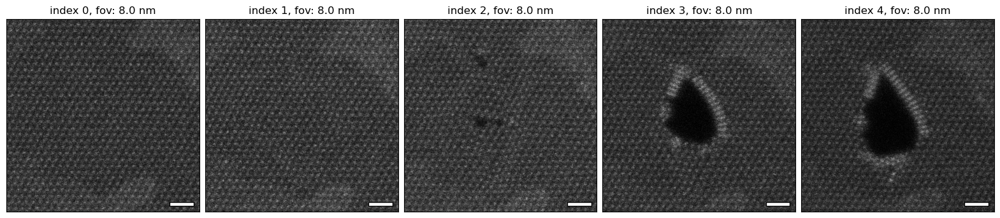

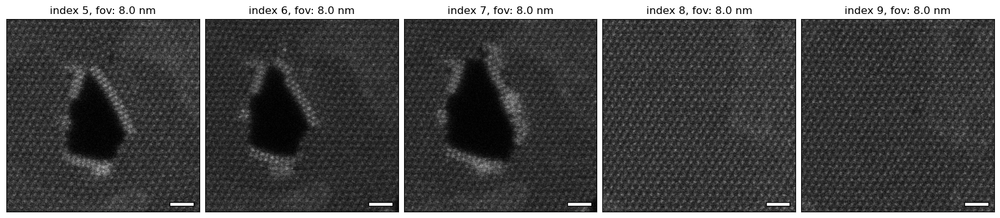

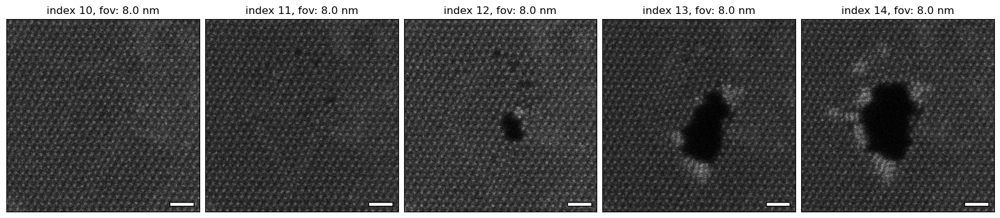

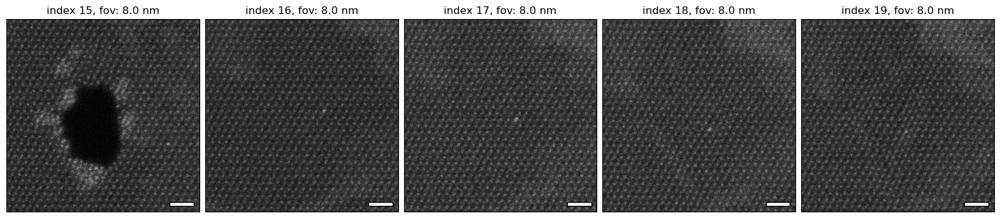

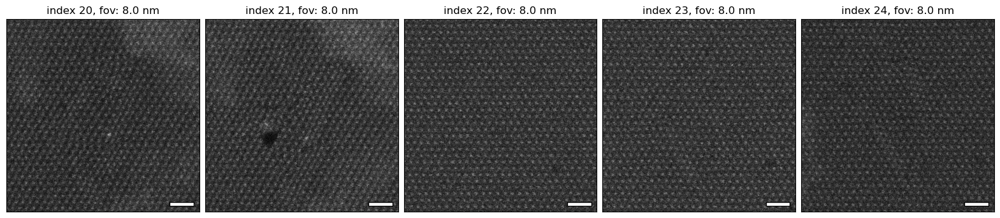

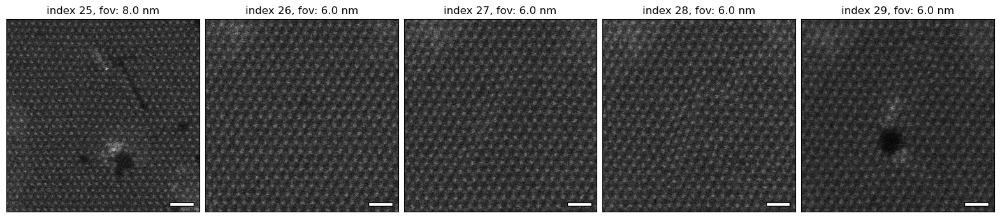

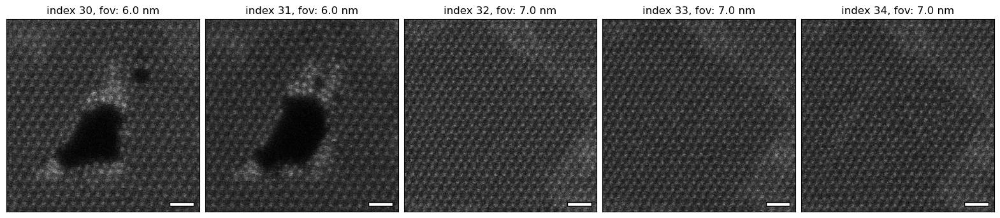

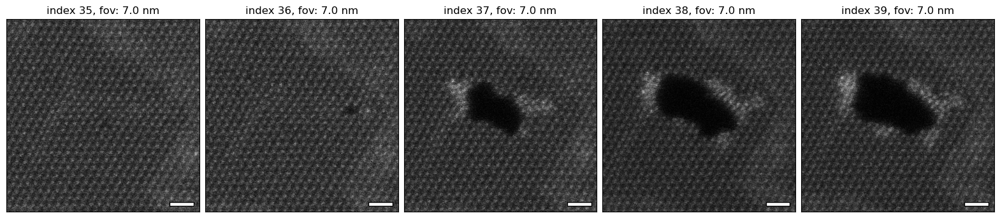

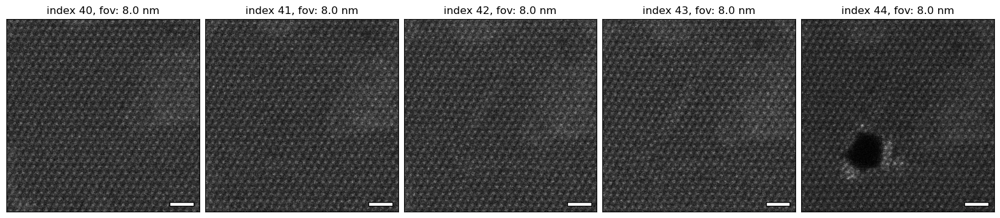

In [36]:
IMAGES, FOVs = all_images, all_fovs

num_images = len(all_images)

ncols = 5
fsize = 4
scalebar_length_f = 0.125

gs = gridspec.GridSpec(1, ncols, wspace = 0.03, hspace = 0.01)

for kk in range(int(np.ceil(num_images/ncols))):
    fig = plt.figure(figsize=(fsize*ncols,fsize))
    for ii in range(ncols):
        try:
            idx_n = int(kk*ncols + ii)
            image, fov = IMAGES[idx_n], FOVs[idx_n]
            ax = fig.add_subplot(gs[ii])
            ax.imshow(image, cmap = 'gray')

            pxsize = fov/image.shape[0]
            plot_scalebar(ax, image, pxsize, scalebar_length_f*fov, 3)
            ax.set_title(f'index {idx_n}, fov: {fov} nm')
            plt.setp(ax,xticks=[],yticks=[])
        except KeyError:
            pass

In [55]:
import torchvision.transforms as transforms

resize_transform = transforms.Resize((208, 208))

images = [] 

for i in all_images:
    img = all_images[i]
    img_tensor = torch.tensor(img).unsqueeze(0)
    img_resized = resize_transform(img_tensor) 
    images.append(img_resized)

tensor_stack = torch.stack(images)
tensor = torch.tensor(tensor_stack, dtype=torch.float32)

print(tensor.shape)

torch.Size([45, 1, 208, 208])


/lustre/saranath/miniconda3/envs/aimd/lib/python3.10/site-packages/torch/utils/_device.py:78: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return func(*args, **kwargs)


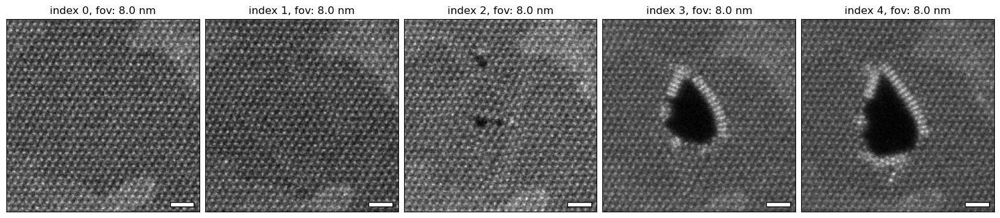

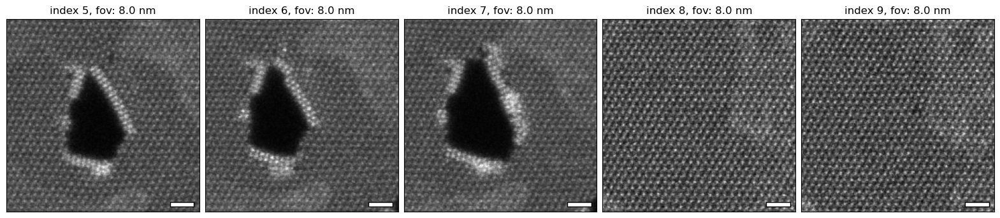

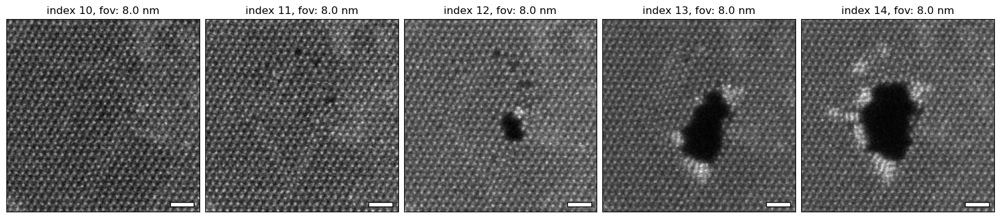

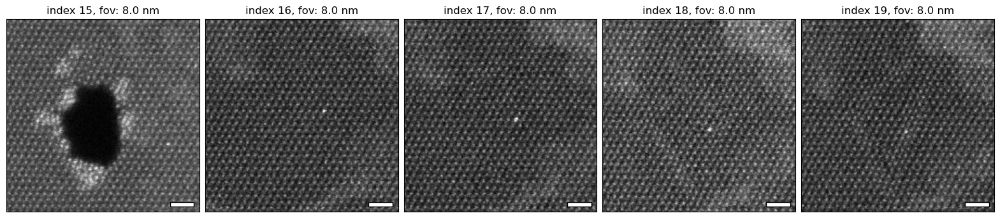

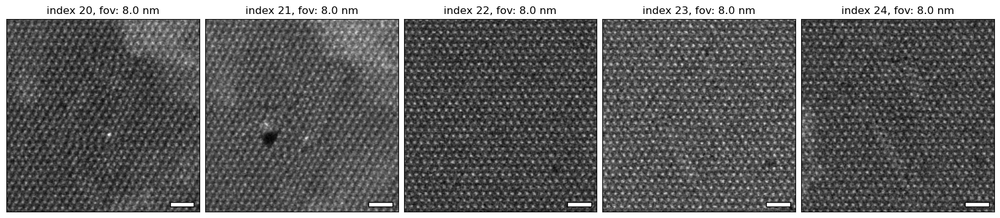

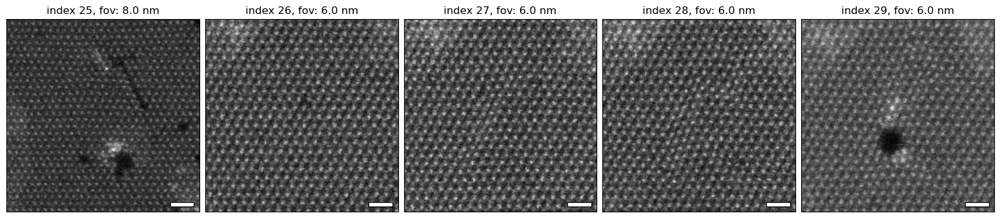

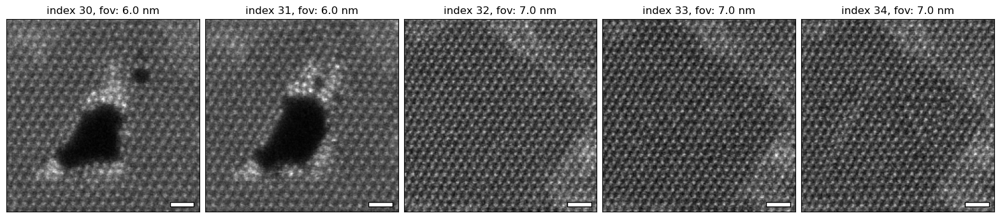

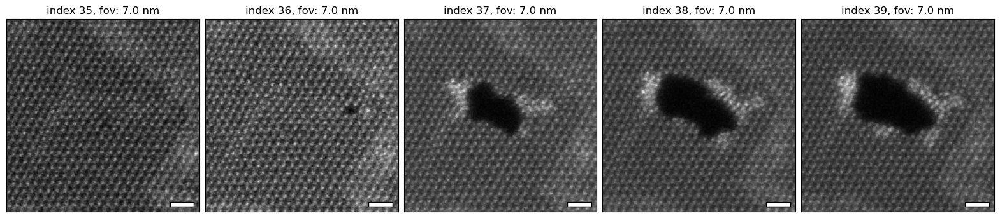

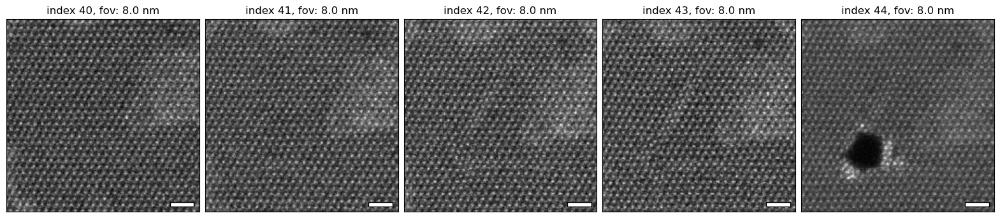

In [56]:
import torch
import matplotlib.pyplot as plt

# Assuming `tensor_resized` is the tensor containing the resized images
# Convert the tensor back to NumPy arrays for plotting
images_np = tensor.squeeze(1).numpy()

# # Set up the plot with a grid of subplots
# fig, axes = plt.subplots(nrows=9, ncols=5, figsize=(15, 27))

# # Plot each image
# for i, ax in enumerate(axes.flat):
#     if i < 45:
#         ax.imshow(images_np[i], cmap='gray')  # Assuming the images are grayscale
#         ax.axis('off')  # Hide the axes for a cleaner look

# plt.tight_layout()
# plt.show()

ncols = 5
fsize = 4
scalebar_length_f = 0.125

gs = gridspec.GridSpec(1, ncols, wspace = 0.03, hspace = 0.01)

for kk in range(int(np.ceil(num_images/ncols))):
    fig = plt.figure(figsize=(fsize*ncols,fsize))
    for ii in range(ncols):
        try:
            idx_n = int(kk*ncols + ii)
            image, fov = images_np[idx_n], FOVs[idx_n]
            ax = fig.add_subplot(gs[ii])
            ax.imshow(image, cmap = 'gray')

            pxsize = fov/image.shape[0]
            plot_scalebar(ax, image, pxsize, scalebar_length_f*fov, 3)
            ax.set_title(f'index {idx_n}, fov: {fov} nm')
            plt.setp(ax,xticks=[],yticks=[])
        except KeyError:
            pass


In [76]:
def show_images(original, reconstructed):
    fig, axes = plt.subplots(2, 10, figsize=(15, 3))
    for i in range(10):
        axes[0, i].imshow(original[i].squeeze(), cmap='gray' , label = "Original")
        axes[0, i].axis('off')
        axes[1, i].imshow(reconstructed[i].squeeze(), cmap='viridis', label = "Reconstructed")
        axes[1, i].axis('off')
        
    plt.legend()
    plt.show()

/tmp/ipykernel_2196643/2978254313.py:9: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


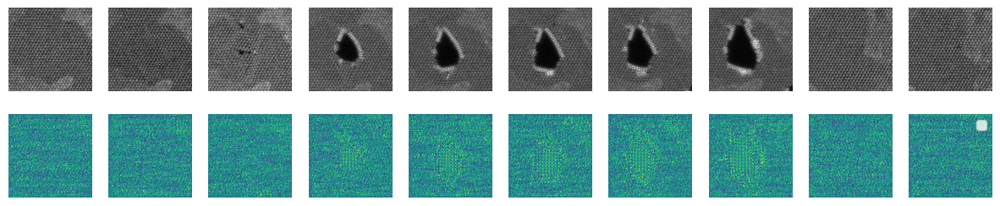

In [77]:
test_loss = nn.MSELoss()
with torch.no_grad():
    experimental = autoencoder(tensor)
    testloss = test_loss(experimental,tensor)

show_images(tensor,experimental.cpu().numpy())

In [78]:
testloss

tensor(0.2607)